In [1]:
import os
from glob import glob
import numpy as np
import scipy as sp
import pandas as pd
import mne

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap, annotate_muscle_zscore, 
                               find_eog_events, find_ecg_events, ica_find_ecg_events)
from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch

from sklearn import decomposition, cluster

print(mne.__file__)
print(mne.__version__)

C:\Users\Lenovo\anaconda3\lib\site-packages\mne\__init__.py
0.23.4


In [2]:
# Configure the graphics engine

import matplotlib.pyplot as plt
plt.rc('figure', max_open_warning=100)
%matplotlib notebook
#%matplotlib inline
#%matplotlib qt

In [446]:
import plotly.graph_objects as go
from gtda.time_series import SingleTakensEmbedding, TakensEmbedding, takens_embedding_optimal_parameters
from gtda.homology import VietorisRipsPersistence, WeightedRipsPersistence, SparseRipsPersistence, WeakAlphaPersistence, EuclideanCechPersistence
from gtda.diagrams import BettiCurve
from gtda.plotting import plot_point_cloud

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap, find_bad_channels_maxwell)
from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch
from mne.time_frequency import csd_fourier, csd_multitaper, csd_morlet

In [3]:
os.getcwd()

if not os.path.exists('work_data'):
    os.mkdir('work_data')

# Loading data

Extracting EDF parameters from C:\Users\Lenovo\PycharmProjects\Tibet\work_data\m10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 491999  =      0.000 ...   983.998 secs...
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2', 'ecg']
<Info | 7 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F7, F3, Fz, F4, F8, T3, C3, Cz, C4, T4, T5, P3, Pz, ...
 chs: 20 EEG
 custom_ref_applied: False
 highpass: 0.5 Hz
 lowpass: 70.0 Hz
 meas_date: 2020-03-01 06:31:33 UTC
 nchan: 20
 projs: []
 sfreq: 500.0 Hz
>


<IPython.core.display.Javascript object>


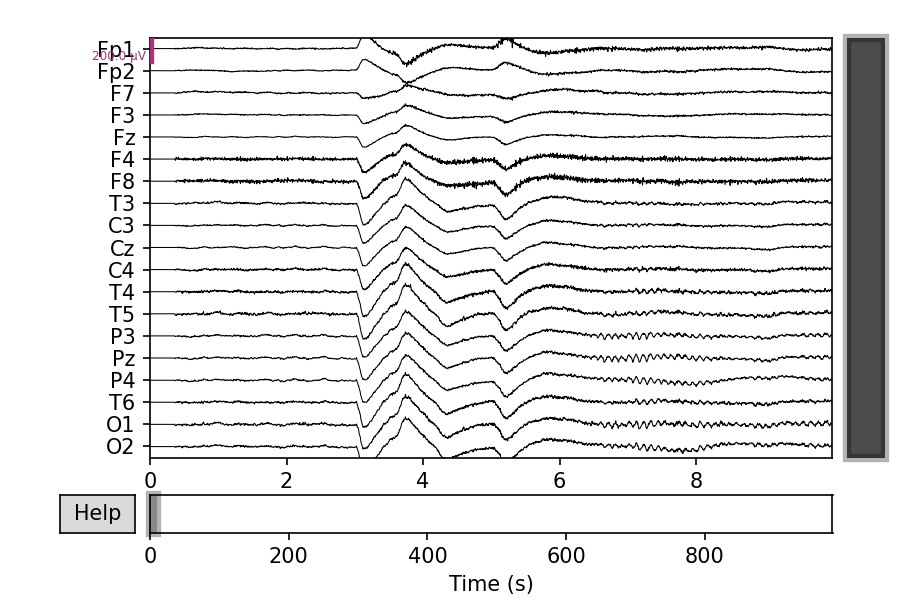

<RawEDF | m10.edf, 19 x 468751 (937.5 s), ~68.0 MB, data loaded>

In [4]:
#Fp_chan=['Fpz', 'Fp1', 'Fp2','Fz']
#C_chan=['Cz', 'C3','C4','C1', 'C2']
#P_chan=['Pz', 'P3', 'P4', 'P8', 'P7', 'P6', 'P5', 'P1', 'P2']
#PO_chan=['POz', 'PO3', 'PO7','PO4', 'PO8'] 
#O_chan= ['Oz', 'O1', 'O2']
#Cz_chan=['CPz','FCz']

ECG_ch =['ecg']

data = mne.io.read_raw_edf(os.path.join('work_data', r"m10.edf"), preload=True)
#annot = mne.read_annotations(os.path.join('work_data', r'm10-annot.csv'))
#data.set_annotations(annot)

print(data.info.ch_names)
print(data.info)

#data_eog = data.copy().pick_channels(EOG_ch)
data_ecg = data.copy().pick_channels(ECG_ch)

data.drop_channels('ecg').set_montage('standard_1020')
#data.set_channel_types(change_types)

data.plot(scalings = dict(eeg=100e-6, eog=150e-6), duration=10)
#data.plot(duration=10)

data.crop(tmin=7.5, tmax=945) #removing blink artifacts


<IPython.core.display.Javascript object>


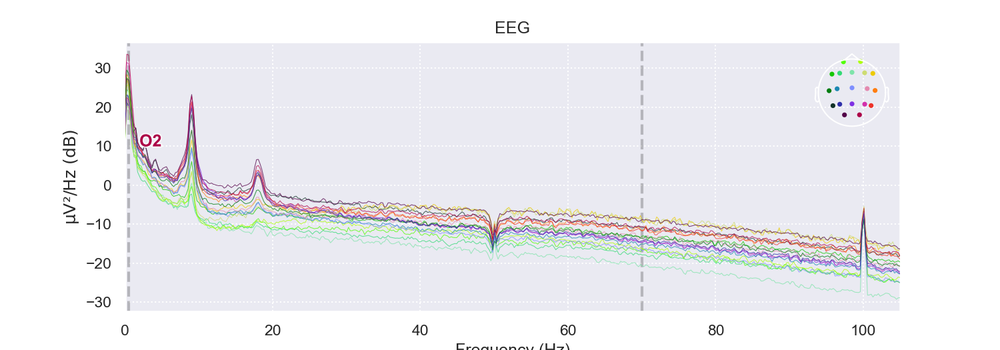

Effective window size : 4.096 (s)


<IPython.core.display.Javascript object>


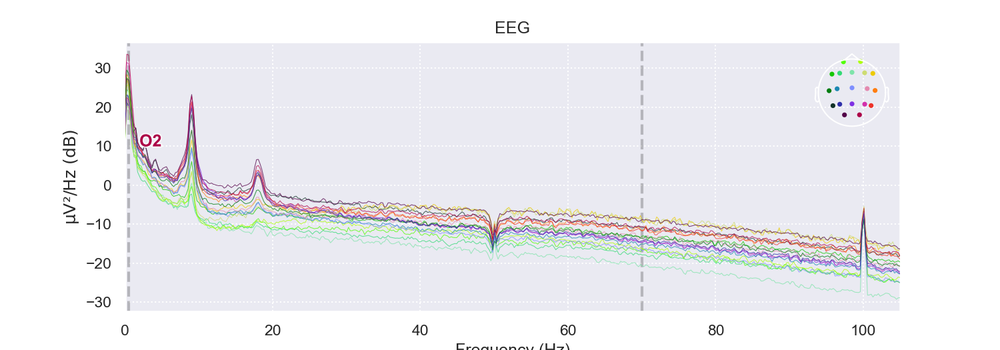

In [449]:
data.plot_psd(fmin=0, fmax=105)

# Preprocessing data

## ICA preparation 

Interpolating bad channels
    Automatic origin fit: head of radius 91.5 mm
Computing interpolation matrix from 17 sensor positions
Interpolating 2 sensors
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 825 samples (1.650 sec)

Fitting ICA to data using 19 channels (please be patient, this may take a while)
Selecting by explained variance: 13 components
Fitting ICA took 7.3s.
Creating RawArray with float64 data, n_channels=13, n_times=468751
    Range : 3750 ... 472500 =      7.500 ...   945.000 secs
Ready.


<IPython.core.display.Javascript object>


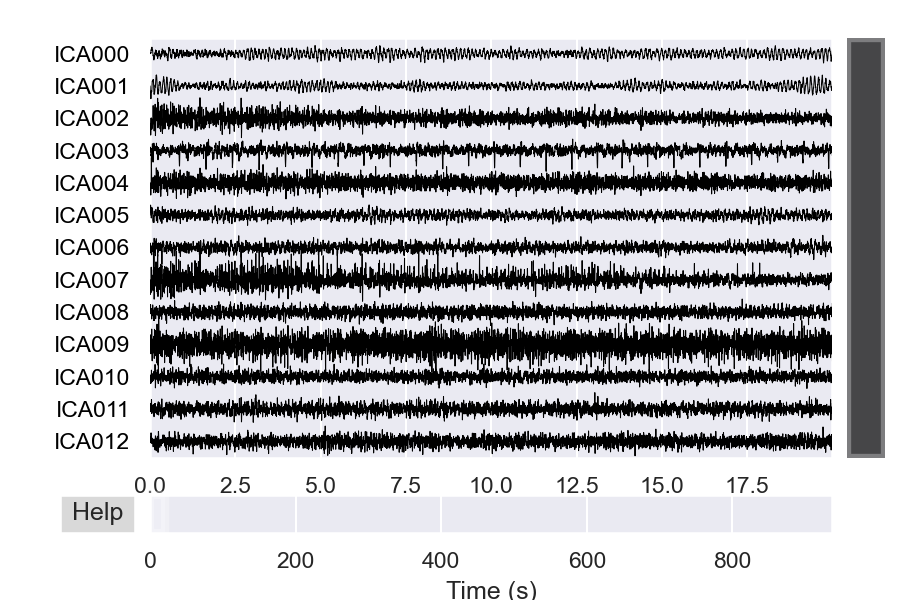

<IPython.core.display.Javascript object>


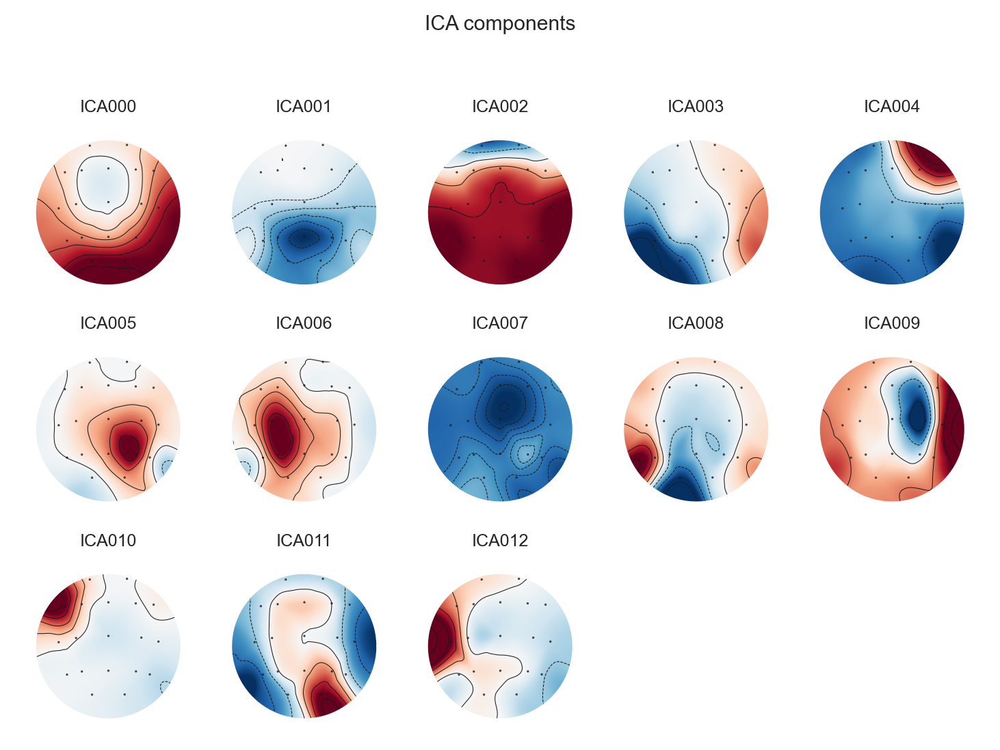

[<MNEFigure size 975x731.5 with 13 Axes>]

In [450]:
data_ica = data.copy()
data_ica.info['bads']=["F4","F8"]
data_ica.interpolate_bads(reset_bads=True)

data_ica.filter(l_freq=4., h_freq=None)

ica = ICA(n_components=.99, max_iter='auto', random_state=97)
ica.fit(data_ica)

ica.plot_sources(data_ica)
ica.plot_components()

Using ICA source to identify heart beats
Setting up band-pass filter from 5 - 35 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 5.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 4.75 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 35.25 Hz)
- Filter length: 5000 samples (10.000 sec)

[111. 111. 111. ... 111. 111. 111.]
[  3794.   4181.   4959. ... 471229. 471594. 471976.]
Not setting metadata
Not setting metadata
1232 matching events found
Setting baseline interval to [-0.3, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 1232 events and 351 original time points ...
1 bad epochs dropped
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


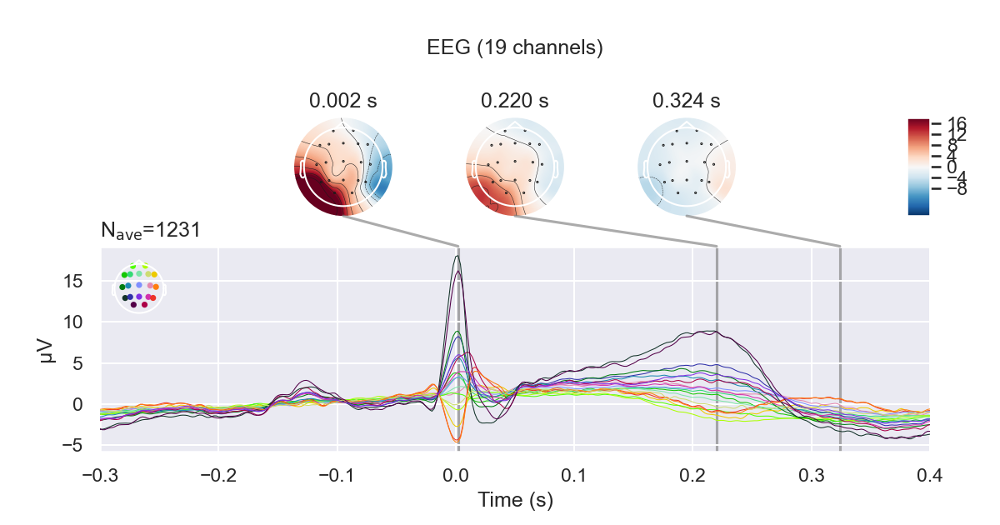

<IPython.core.display.Javascript object>


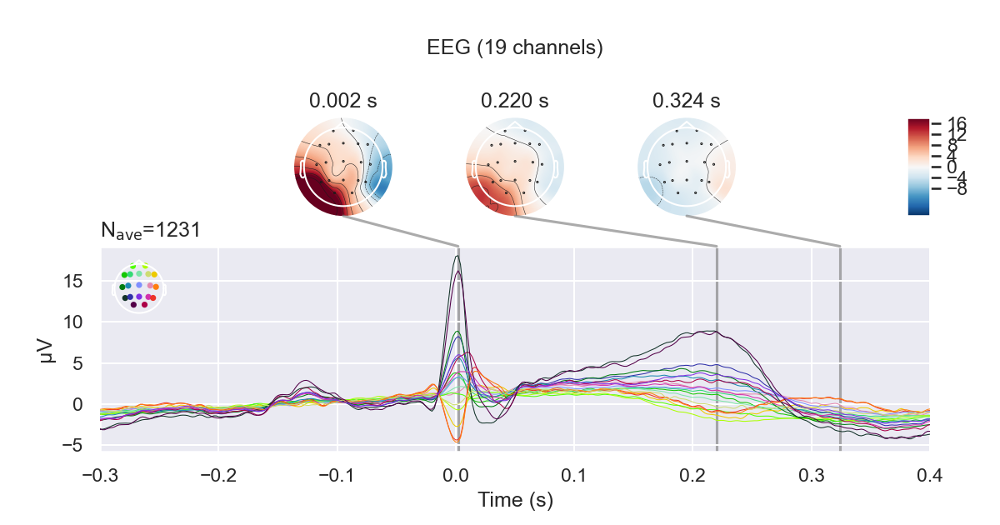

In [451]:
# Extract the time courses of these components and add them as channels to the raw data. 
# Think of them the same way as EOG/EKG channels
ecg_comps = ica.get_sources(data_ica).get_data()
#ecg_comps.pick(picks='ICA003')
#(ecg_comps.info)

ecg_events = ica_find_ecg_events(data_ica, 
                             ecg_comps[3], 
                             event_id=111, 
                             l_freq=5, h_freq=35, 
                             )
print(ecg_events[:,2])
print(np.unique(ecg_events[:,0]))


evoked_ECG = mne.Epochs(data, ecg_events.astype(int),
                            #detrend=1,
                            decim=1,
                            #baseline=(-0.15,0.0),
                            tmin=-0.3, tmax=0.4, 
                            preload=True).average()
evoked_ECG.plot_joint()

#data_ica.add_channels([ecg_comps])

#ecg_comps.rename_channels({'ICA003': 'ecg_ICA003'})
#ecg_comps.set_channel_types({'ICA003': 'ecg'})


Applying ICA to Evoked instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<ipython-input-452-835c2dff7e7e>:1: RuntimeWarning:

The data you passed to ICA.apply() was baseline-corrected. Please note that ICA can introduce DC shifts, therefore you may wish to consider baseline-correcting the cleaned data again.



<IPython.core.display.Javascript object>


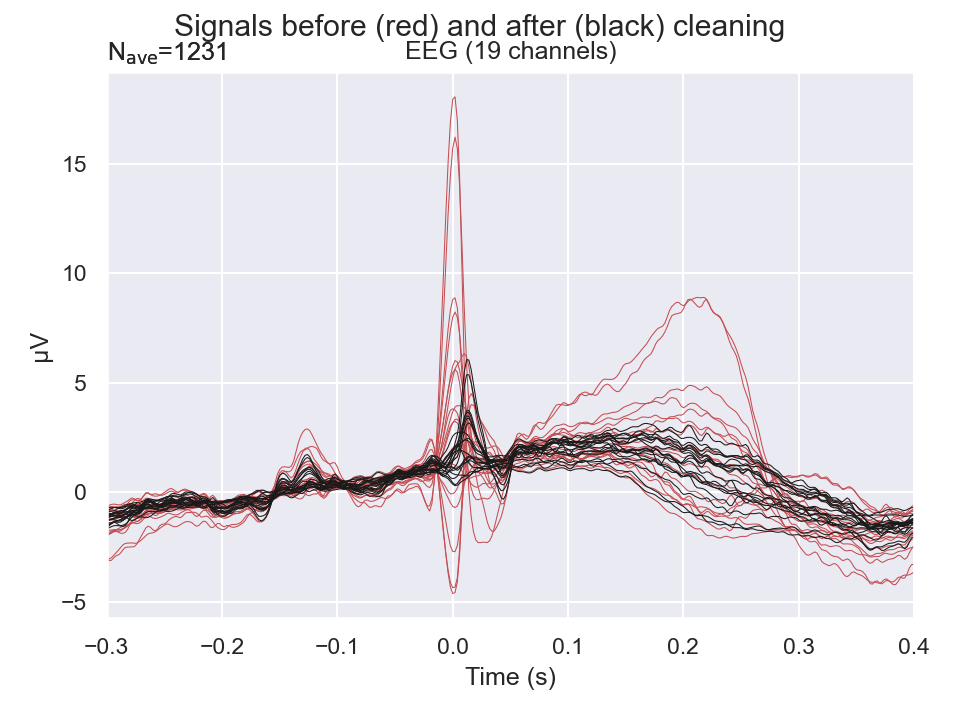

<IPython.core.display.Javascript object>


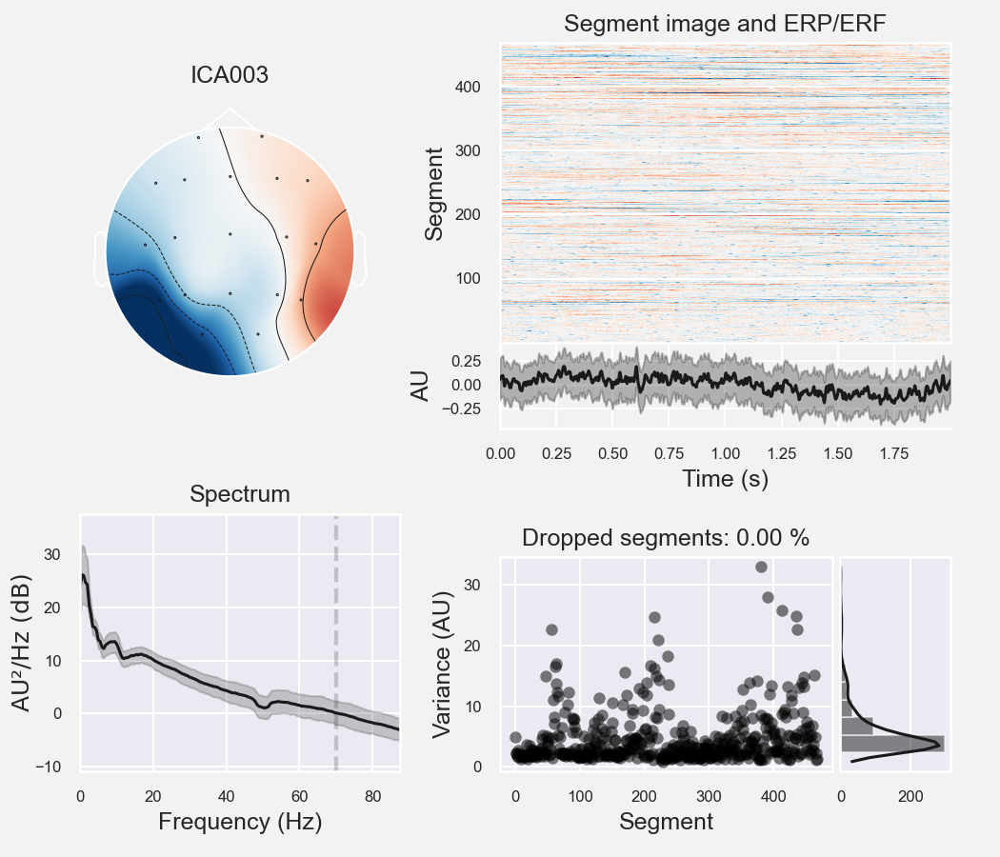

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
468 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


[<Figure size 700x600 with 6 Axes>]

In [452]:
ica.plot_overlay(evoked_ECG, exclude=[3])
ica.plot_properties(data, picks=[3])

Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 825 samples (1.650 sec)

Fitting ICA to data using 19 channels (please be patient, this may take a while)
Selecting by explained variance: 14 components
Fitting ICA took 8.2s.
Creating RawArray with float64 data, n_channels=14, n_times=468751
    Range : 3750 ... 472500 =      7.500 ...   945.000 secs
Ready.


<IPython.core.display.Javascript object>


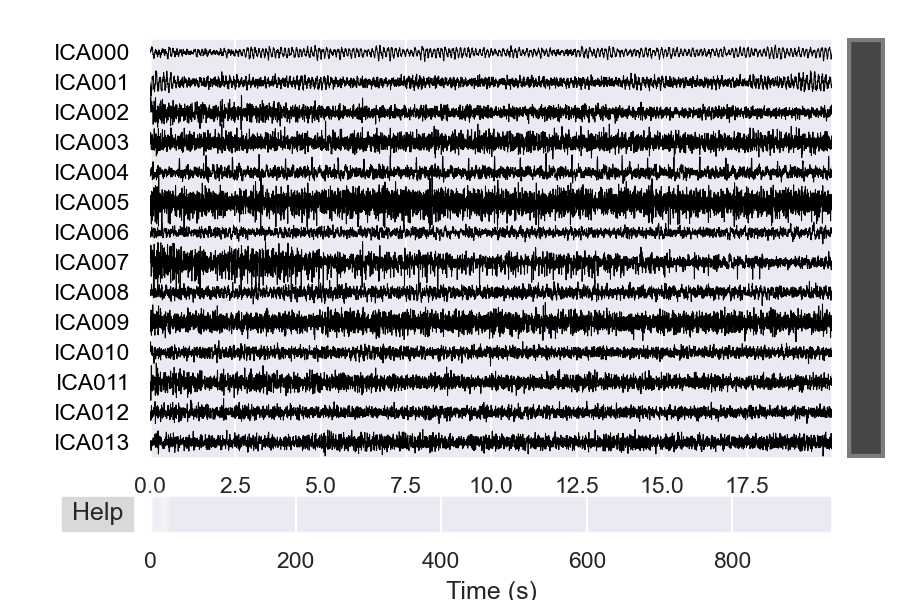

<IPython.core.display.Javascript object>


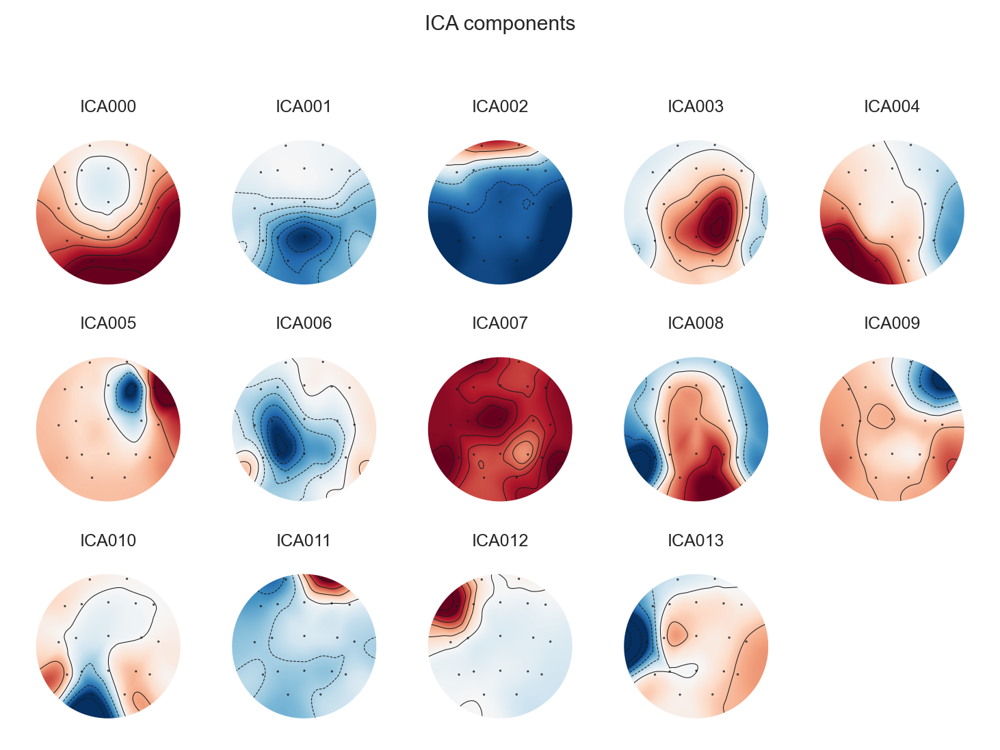

Applying ICA to Evoked instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<ipython-input-453-91eb0be490ac>:10: RuntimeWarning:

The data you passed to ICA.apply() was baseline-corrected. Please note that ICA can introduce DC shifts, therefore you may wish to consider baseline-correcting the cleaned data again.



<IPython.core.display.Javascript object>


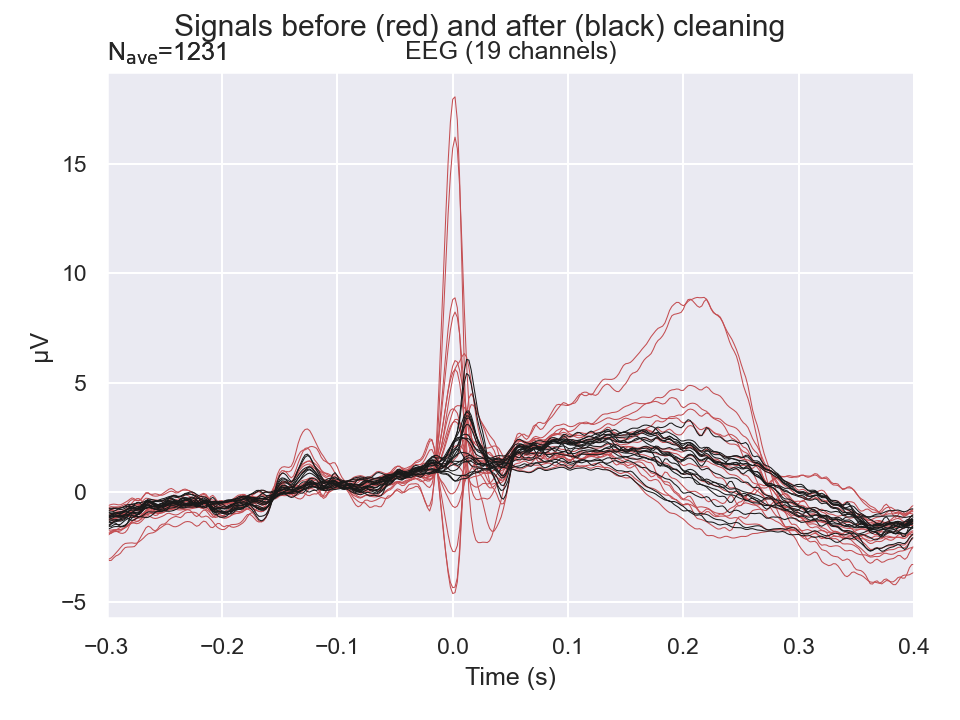

<IPython.core.display.Javascript object>


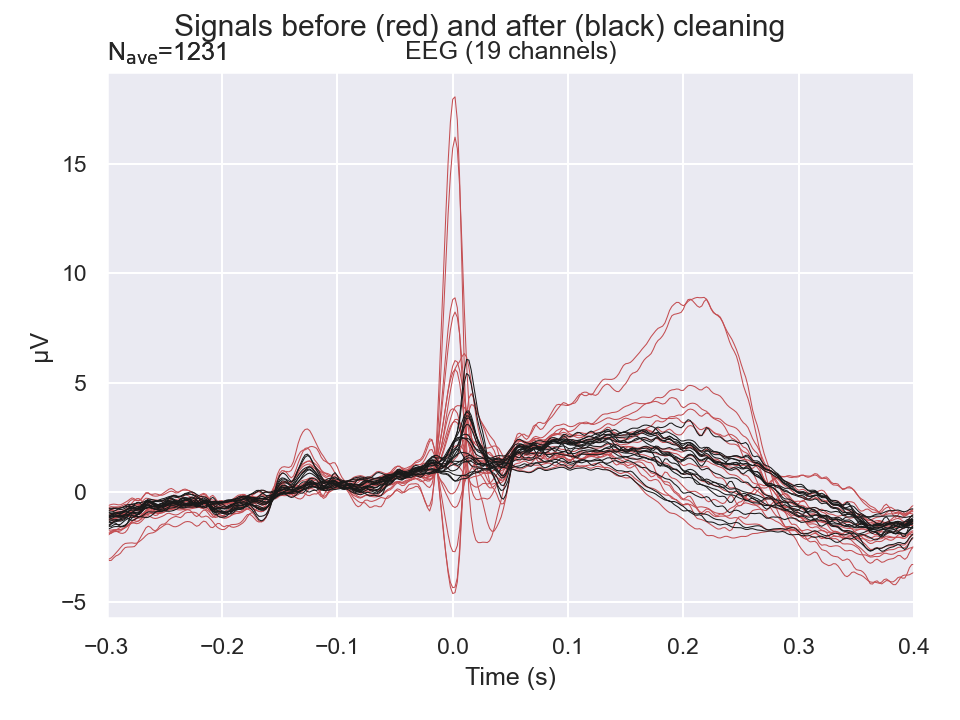

In [453]:
data_ica_2 = data.copy()

data_ica_2.filter(l_freq=4., h_freq=None)

ica_2 = ICA(n_components=.99, max_iter='auto', random_state=97)
ica_2.fit(data_ica_2)

ica_2.plot_sources(data_ica_2)
ica_2.plot_components()
ica_2.plot_overlay(evoked_ECG, exclude=[4])

Applying ICA to Raw instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<IPython.core.display.Javascript object>


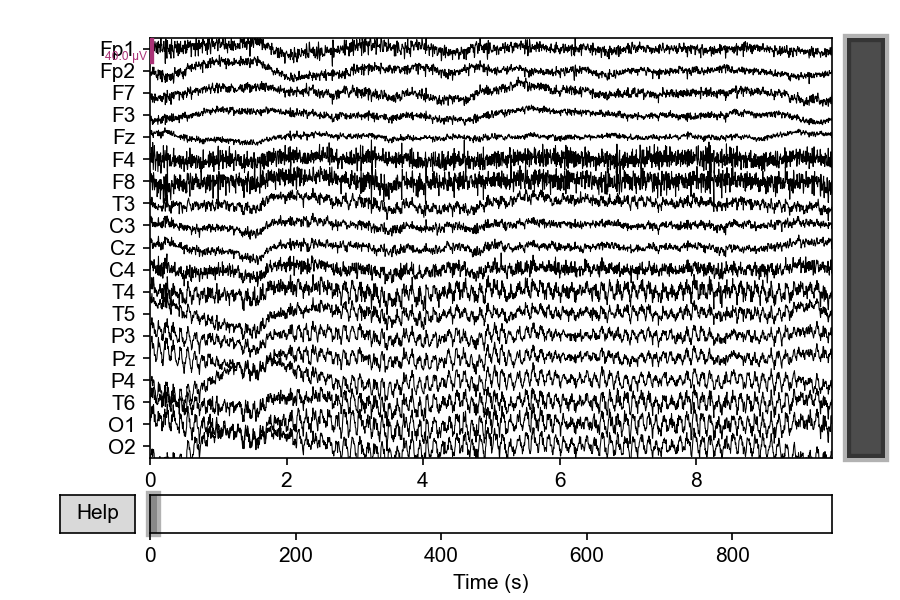

<IPython.core.display.Javascript object>


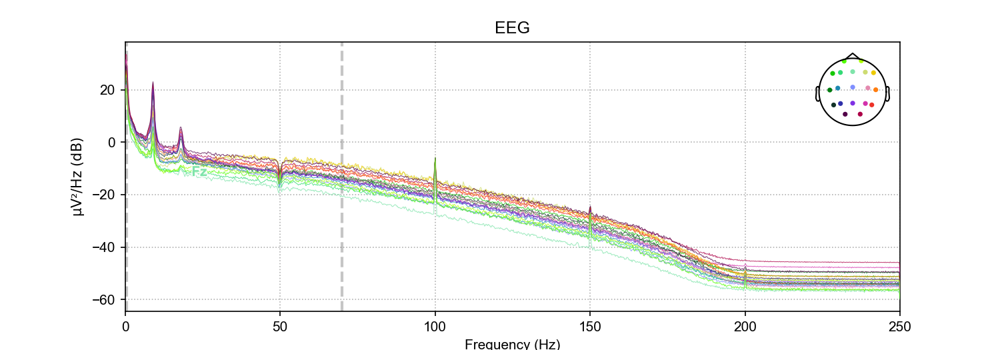

Effective window size : 4.096 (s)


<IPython.core.display.Javascript object>


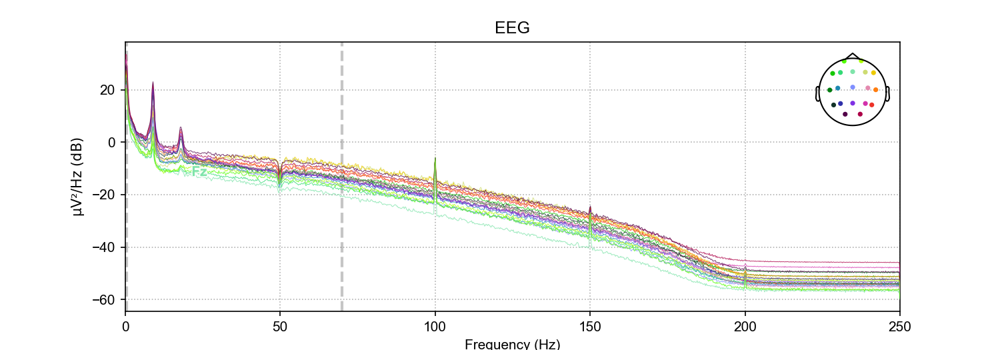

In [11]:
# data_notch = data.copy().notch_filter([50,100])
#data_notch.plot_psd(fmin=0, fmax=105)

ica.exclude = [3] #exclude ECG channel
ica.apply(data)

data.plot()
data.plot_psd()



# Epoching data

Not setting metadata
Not setting metadata
1232 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1232 events and 451 original time points ...
1 bad epochs dropped
<Epochs |  1231 events (all good), -0.4 - 0.5 sec, baseline off, ~80.5 MB, data loaded,
 '111': 1231>
(1232, 3)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


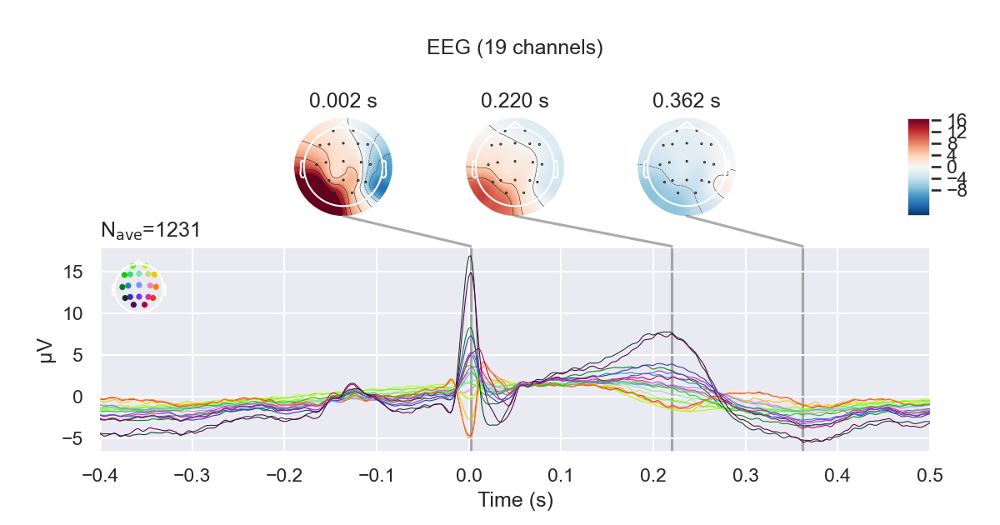

<IPython.core.display.Javascript object>


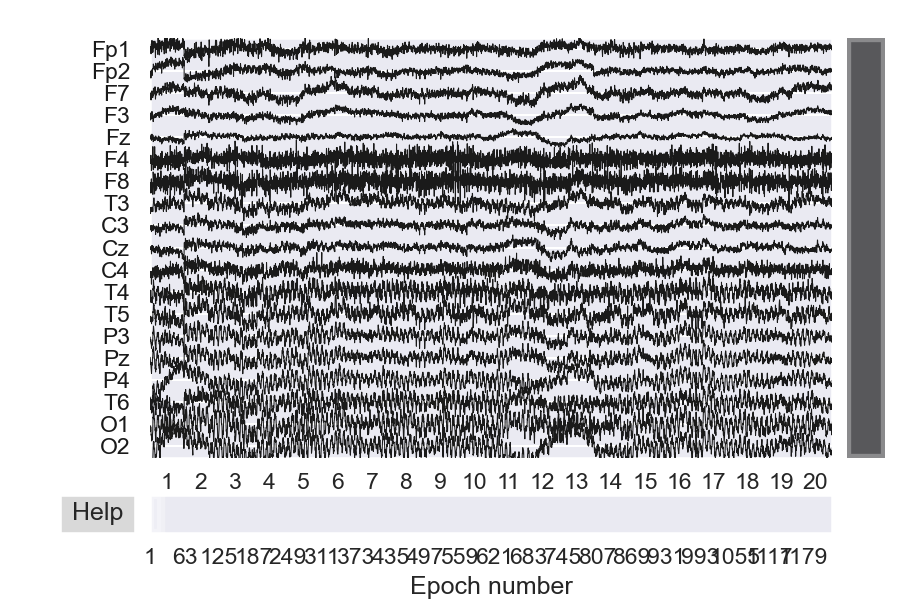

<IPython.core.display.Javascript object>


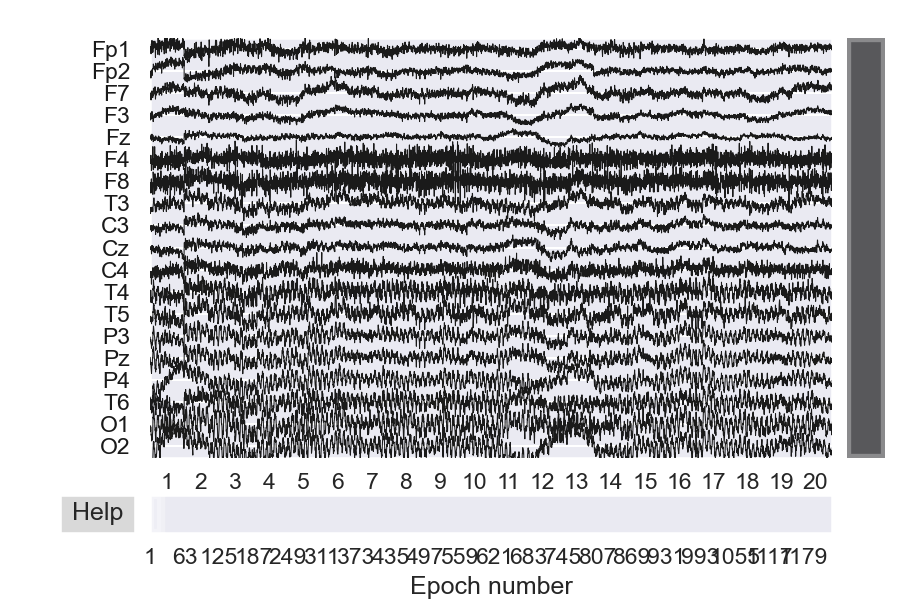

In [454]:
epochs_ecg = mne.Epochs(data, ecg_events.astype(int),
                            #detrend=1,
                            #decim=1,
                            baseline=None,
                            #baseline=(-0.15,0.0),
                            tmin=-0.4, tmax=0.5, 
                            preload=True)
print(epochs_ecg)
print(ecg_events.shape)
epochs_ecg.average().plot_joint()
epochs_ecg.plot()

[[  3850      0      1]
 [  4350      0      1]
 [  4850      0      1]
 ...
 [470850      0      1]
 [471350      0      1]
 [471850      0      1]]
(937, 3)
Not setting metadata
Not setting metadata
937 matching events found
No baseline correction applied
0 projection items activated
Loading data for 937 events and 351 original time points ...
0 bad epochs dropped
[[[-9.46820920e-06 -1.42069886e-07  5.47314488e-06 ...  7.23095125e-06
    8.50047807e-06  9.57469306e-06]
  [-9.85883284e-06 -7.51509102e-06 -4.29244602e-06 ...  7.23095125e-06
    7.47509102e-06  9.72117693e-06]
  [-1.16166392e-05 -1.00053167e-05 -1.09330478e-05 ...  5.66845670e-06
    7.13329534e-06  7.67040284e-06]
  ...
  [ 1.15278112e-05  1.53363917e-05  1.49945960e-05 ... -8.34516625e-06
   -3.95065034e-06 -1.70456443e-06]
  [ 2.68995148e-06  4.05713420e-06  7.36833295e-07 ... -3.07174716e-06
   -3.02291920e-06 -4.09713420e-06]
  [-3.20267242e-05 -2.83646276e-05 -2.83157996e-05 ... -3.65768261e-06
   -1.02097307e-06 

<IPython.core.display.Javascript object>


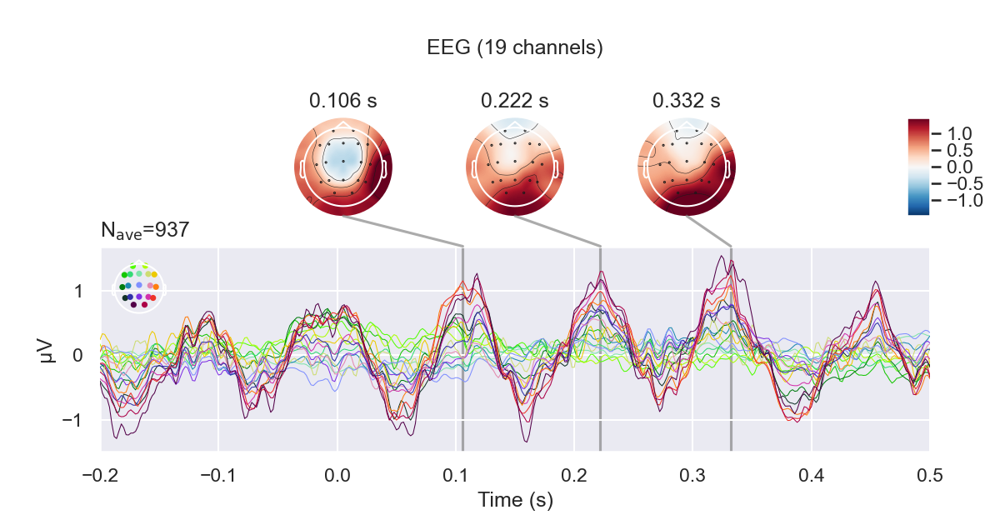

<IPython.core.display.Javascript object>


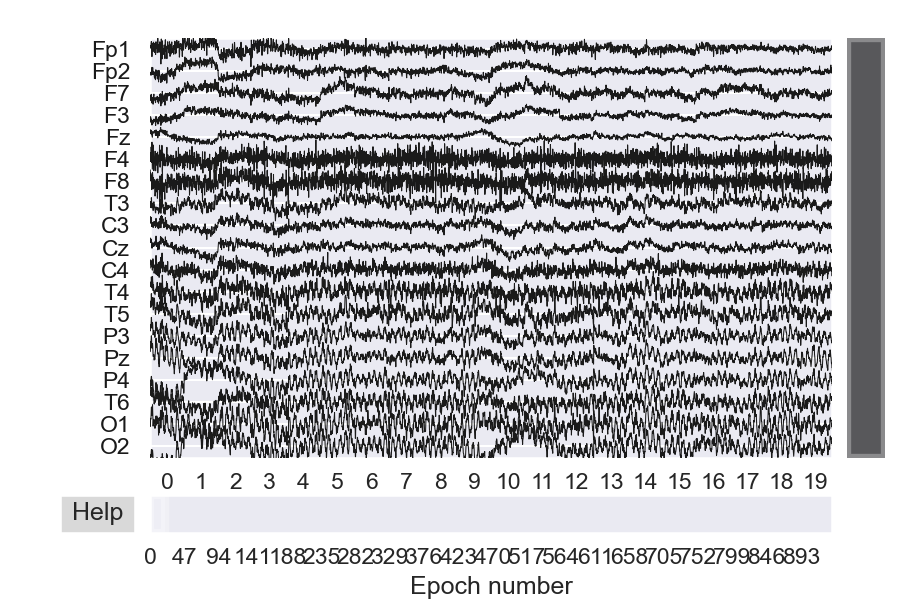

<IPython.core.display.Javascript object>


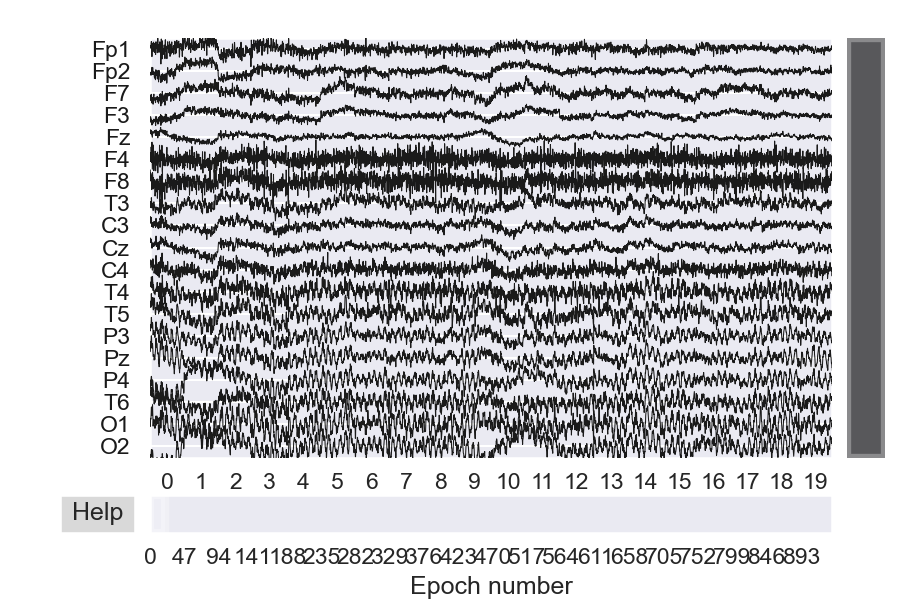

In [455]:
fix_1s_events = mne.make_fixed_length_events(data, start=0.2, duration=1.)
print(fix_1s_events)
print(fix_1s_events.shape)

epochs_fix_1s = mne.Epochs(data, fix_1s_events.astype(int),
                            #detrend=1,
                            #decim=1,
                            baseline=None,
                            #baseline=(-0.15,0.0),
                            #tmin=-0.4, tmax=0.5, 
                            preload=True)

print(epochs_fix_1s.get_data())
print(epochs_fix_1s.get_data().shape)
epochs_fix_1s.average().plot_joint()
epochs_fix_1s.plot()

In [441]:
#fix_1s_events = mne.make_fixed_length_events(data, start=5, duration=1.)

epochs_fix_1s = mne.make_fixed_length_epochs(data, 
                                             duration=1, 
                                             #overlap=2, 
                                             preload=True)
print(epochs_fix_1s.get_data())
print(epochs_fix_1s.get_data().shape)
epochs_fix_1s.average().plot_joint()
epochs_fix_1s.plot()

Not setting metadata
Not setting metadata
937 matching events found
No baseline correction applied
0 projection items activated
Loading data for 937 events and 500 original time points ...
0 bad epochs dropped
[[[-9.04665616e-06  2.63951475e-07  6.01716413e-06 ... -5.44926179e-06
   -3.64401706e-06  1.40382253e-06]
  [-1.05484851e-05 -8.17933377e-06 -5.18245053e-06 ...  1.48232761e-05
    1.30234102e-05  1.04229388e-05]
  [-1.00584279e-05 -8.50451608e-06 -8.92215752e-06 ...  3.49462410e-06
   -1.29130244e-06 -2.31173818e-06]
  ...
  [ 8.85179340e-06  1.27589690e-05  1.15411630e-05 ... -1.00116303e-05
   -2.05517955e-05 -2.83037690e-05]
  [ 9.30167157e-06  1.04252524e-05  9.26933719e-06 ... -2.27537453e-06
   -9.56996669e-06 -1.42259072e-05]
  [-3.04764252e-05 -2.68714477e-05 -2.63151202e-05 ...  2.52328624e-05
    1.72703955e-05  1.06334802e-05]]

 [[ 8.78810510e-06  1.52239162e-05  1.64245972e-05 ... -6.37152854e-06
   -6.53302647e-06 -5.92830262e-06]
  [ 1.04843968e-05  1.37358284e-0

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 16501 samples (33.002 sec)



<IPython.core.display.Javascript object>


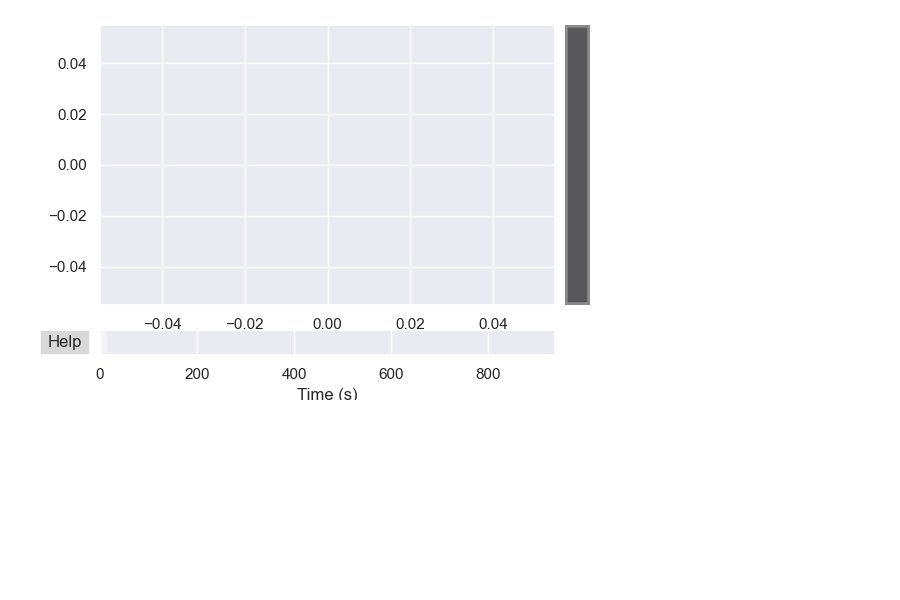

<IPython.core.display.Javascript object>


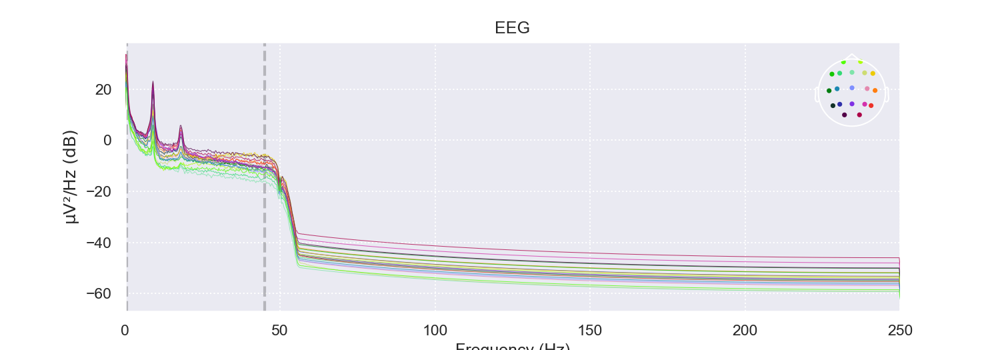

Effective window size : 4.096 (s)


<IPython.core.display.Javascript object>


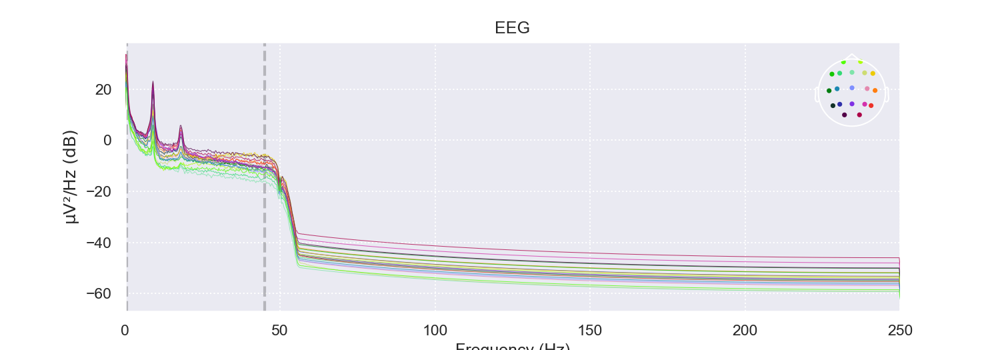

In [430]:
#data.resample(sfreq=100)
data_filt = data.copy().filter(l_freq=0.1, h_freq=45)

data_filt.plot()
data_filt.plot_psd()

In [14]:
print(epochs_ecg.info['ch_names'])

['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']


Effective window size : 0.512 (s)
Effective window size : 0.512 (s)


<IPython.core.display.Javascript object>


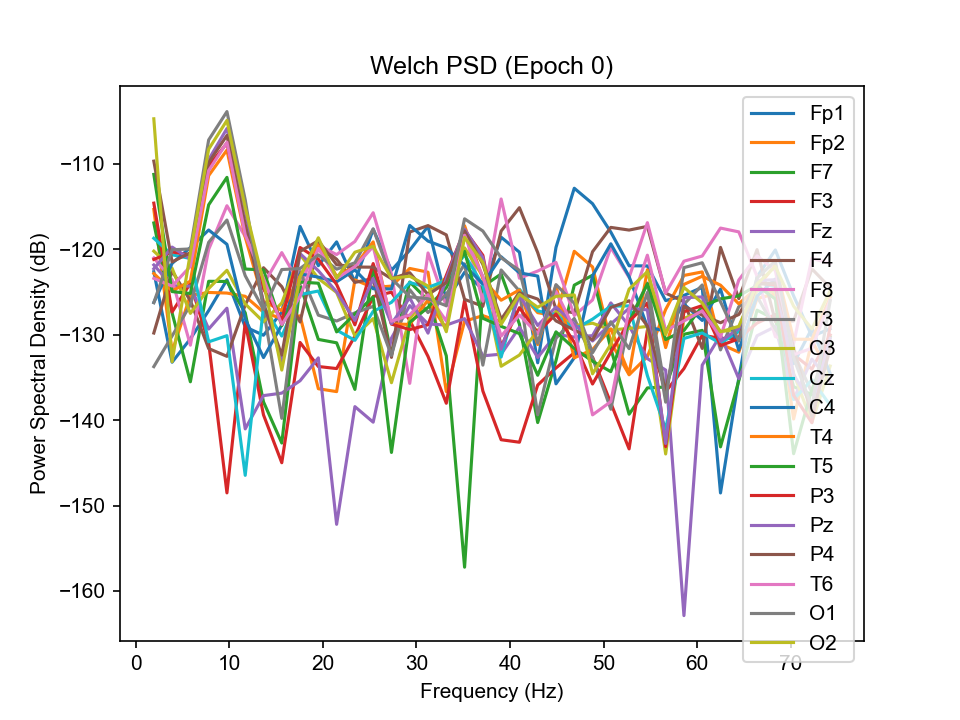

In [17]:
# Estimate PSDs based on "mean" and "median" averaging for comparison.
kwargs = dict(fmin=0.1, fmax=75)
psds_welch_mean, freqs_mean = psd_welch(epochs_ecg, average='mean', **kwargs)
psds_welch_median, freqs_median = psd_welch(epochs_ecg, average='median', **kwargs)

# Convert power to dB scale.
psds_welch_mean = 10 * np.log10(psds_welch_mean)
#psds_welch_median = 10 * np.log10(psds_welch_median)

# We will only plot the PSD for a single sensor in the first epoch.
#ch_name = 'Fp1'
#ch_idx = epochs_ecg.info['ch_names'].index(ch_name)

epo_idx = 0
_, ax = plt.subplots()

for ch_name in epochs_ecg.info['ch_names']:
    ch_idx = epochs_ecg.info['ch_names'].index(ch_name)
    ax.plot(freqs_mean, psds_welch_mean[epo_idx, ch_idx, :], ls='-', label=ch_name)
#    ax.plot(freqs_median, psds_welch_median[epo_idx, ch_idx, :], color='b', ls='--', label='median of segments')
    
ax.set(title='Welch PSD (Epoch {})'.format(epo_idx),
       xlabel='Frequency (Hz)', ylabel='Power Spectral Density (dB)')
ax.legend(loc='upper right')
plt.show()


Effective window size : 0.512 (s)
    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


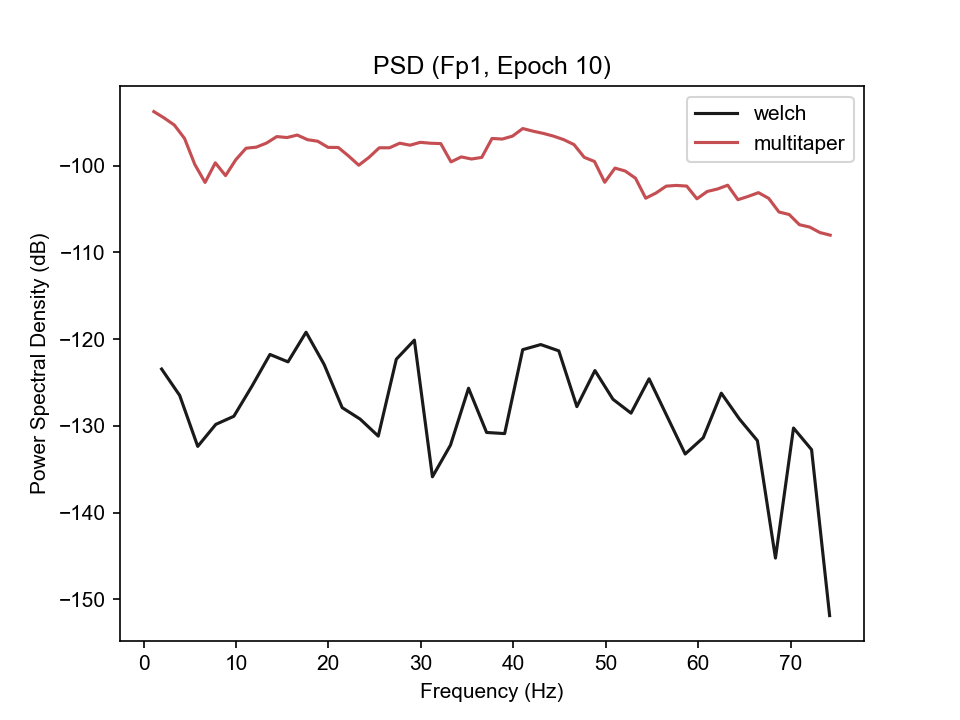

In [19]:
# Estimate PSDs based on "mean" and "median" averaging for comparison.
kwargs = dict(fmin=0.1, fmax=75, n_jobs=1)
psds_welch, freqs_welch = psd_welch(epochs_ecg, **kwargs)
psds_mtaper, freqs_mtaper = psd_multitaper(epochs_ecg, **kwargs)

#psds_welch_median, freqs_median = psd_welch(epochs_ecg, average='median', **kwargs)

# Convert power to dB scale.
psds_welch = 10 * np.log10(psds_welch)
psds_mtaper = 10 * np.log10(psds_mtaper)
#psds_welch_median = 10 * np.log10(psds_welch_median)

# We will only plot the PSD for a single sensor in the first epoch.
ch_name = 'Fp1'
ch_idx = epochs_ecg.info['ch_names'].index(ch_name)
epo_idx = 10

_, ax = plt.subplots()
ax.plot(freqs_welch, psds_welch[epo_idx, ch_idx, :], color='k', ls='-', label='welch')
ax.plot(freqs_mtaper, psds_mtaper[epo_idx, ch_idx, :], color='r',
        ls='-', label='multitaper')

ax.set(title='PSD ({}, Epoch {})'.format(ch_name, epo_idx),
       xlabel='Frequency (Hz)', ylabel='Power Spectral Density (dB)')
ax.legend(loc='upper right')
plt.show()

<IPython.core.display.Javascript object>


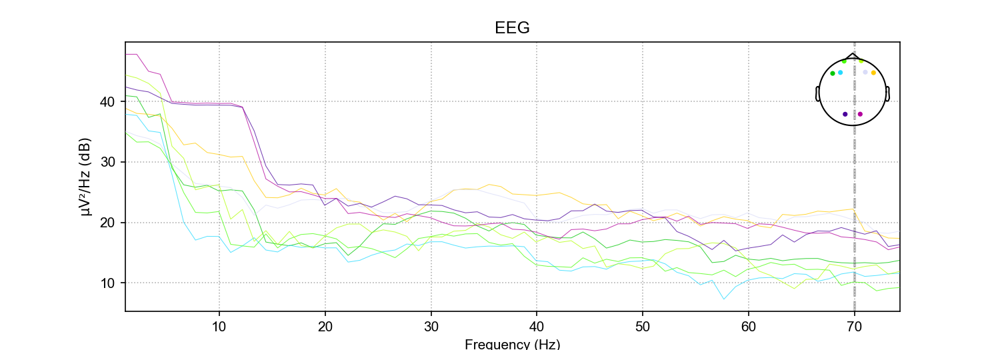

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


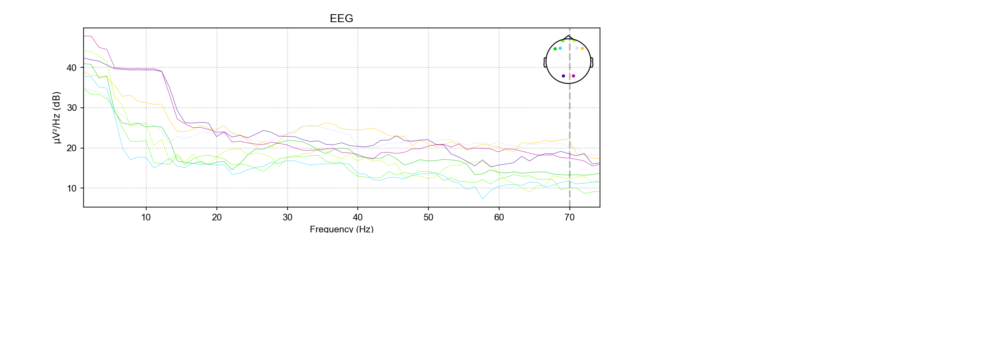

In [20]:
epochs_ecg[300].plot_psd(fmin=0.1, fmax=75, 
                        picks=('Fp1','Fp2','F4','F8','F3','F7','O1','O2'),
                        #normalization='full'
                      )

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


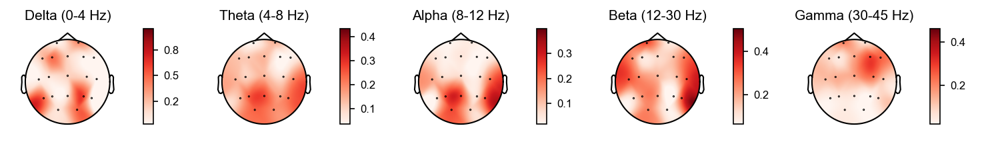

<IPython.core.display.Javascript object>


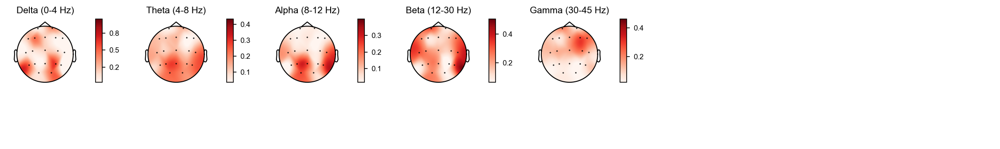

In [21]:
epochs_ecg[0].plot_psd_topomap(normalize=True)

# Explore channel correlations

## Averaged epochs (evoked data) correlations 

In [22]:
print(epochs_ecg.get_data().shape)
evoked_ecg = epochs_ecg.average()
evoked_ecg_np = evoked_ecg.data
print(evoked_ecg_np.shape)

matr_corr = np.corrcoef(evoked_ecg_np)
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = evoked_ecg.ch_names, columns = evoked_ecg.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s

(1231, 19, 451)
(19, 451)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.99,0.95,0.84,0.88,0.83,0.88,0.83,0.73,0.65,0.63,0.70,0.63,0.58,0.59,0.80,0.68,0.51,0.70
Fp2,0.99,1.00,0.96,0.87,0.91,0.87,0.91,0.86,0.77,0.69,0.68,0.74,0.67,0.63,0.64,0.83,0.71,0.55,0.73
F7,0.95,0.96,1.00,0.94,0.96,0.93,0.96,0.95,0.88,0.80,0.80,0.85,0.81,0.76,0.75,0.90,0.82,0.68,0.81
F3,0.84,0.87,0.94,1.00,0.99,0.98,0.98,0.98,0.98,0.94,0.94,0.95,0.93,0.90,0.89,0.96,0.93,0.84,0.90
Fz,0.88,0.91,0.96,0.99,1.00,0.99,0.97,0.97,0.96,0.92,0.91,0.93,0.89,0.87,0.86,0.96,0.91,0.80,0.89
F4,0.83,0.87,0.93,0.98,0.99,1.00,0.96,0.98,0.97,0.93,0.94,0.94,0.92,0.89,0.88,0.96,0.93,0.83,0.89
F8,0.88,0.91,0.96,0.98,0.97,0.96,1.00,0.98,0.94,0.89,0.89,0.93,0.90,0.86,0.85,0.94,0.91,0.79,0.87
T3,0.83,0.86,0.95,0.98,0.97,0.98,0.98,1.00,0.97,0.92,0.93,0.96,0.95,0.90,0.88,0.95,0.94,0.84,0.88
C3,0.73,0.77,0.88,0.98,0.96,0.97,0.94,0.97,1.00,0.98,0.98,0.98,0.97,0.96,0.95,0.97,0.97,0.91,0.93
Cz,0.65,0.69,0.80,0.94,0.92,0.93,0.89,0.92,0.98,1.00,0.98,0.96,0.95,0.97,0.96,0.94,0.96,0.92,0.92


## Raw data correlations  

In [23]:
print(data.get_data().shape)

matr_corr = np.corrcoef(data.get_data())
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s

(19, 468751)


,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.80,0.78,0.60,-0.15,0.37,0.50,0.63,0.02,-0.62,0.04,0.48,-0.28,0.15,-0.14,0.59,0.28,0.48,0.69
Fp2,0.80,1.00,0.76,0.54,-0.22,0.52,0.61,0.65,-0.11,-0.76,0.04,0.55,-0.39,0.09,-0.22,0.72,0.33,0.49,0.84
F7,0.78,0.76,1.00,0.88,0.13,0.66,0.79,0.89,0.33,-0.60,0.38,0.73,-0.08,0.45,0.10,0.85,0.50,0.73,0.85
F3,0.60,0.54,0.88,1.00,0.44,0.72,0.79,0.87,0.60,-0.39,0.60,0.73,0.08,0.61,0.31,0.83,0.50,0.73,0.73
Fz,-0.15,-0.22,0.13,0.44,1.00,0.46,0.35,0.29,0.83,0.38,0.74,0.40,0.58,0.66,0.65,0.25,0.35,0.38,0.02
F4,0.37,0.52,0.66,0.72,0.46,1.00,0.73,0.74,0.52,-0.25,0.65,0.75,0.22,0.60,0.36,0.77,0.60,0.72,0.69
F8,0.50,0.61,0.79,0.79,0.35,0.73,1.00,0.87,0.50,-0.44,0.60,0.88,0.22,0.63,0.32,0.85,0.69,0.81,0.80
T3,0.63,0.65,0.89,0.87,0.29,0.74,0.87,1.00,0.50,-0.50,0.54,0.88,0.19,0.66,0.30,0.86,0.65,0.88,0.83
C3,0.02,-0.11,0.33,0.60,0.83,0.52,0.50,0.50,1.00,0.32,0.84,0.59,0.68,0.85,0.80,0.43,0.56,0.61,0.21
Cz,-0.62,-0.76,-0.60,-0.39,0.38,-0.25,-0.44,-0.50,0.32,1.00,0.21,-0.31,0.51,0.13,0.49,-0.48,-0.03,-0.30,-0.60


## Frequency range raw data correlation

In [24]:
# Delta (0-4 Hz)

#data.resample(sfreq=100)
data_delta = data.copy().filter(l_freq=0.1, h_freq=4)

matr_corr = np.corrcoef(data_delta.get_data())
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Delta range (0-4 Hz) channels correlations")
s

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 16501 samples (33.002 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.83,0.79,0.62,-0.14,0.48,0.53,0.66,0.01,-0.67,0.05,0.51,-0.38,0.16,-0.20,0.64,0.34,0.54,0.74
Fp2,0.83,1.00,0.78,0.56,-0.22,0.59,0.63,0.66,-0.11,-0.80,0.04,0.59,-0.49,0.08,-0.31,0.76,0.41,0.54,0.88
F7,0.79,0.78,1.00,0.89,0.13,0.77,0.82,0.90,0.33,-0.66,0.41,0.77,-0.16,0.48,0.09,0.89,0.62,0.79,0.88
F3,0.62,0.56,0.89,1.00,0.44,0.82,0.84,0.89,0.61,-0.46,0.67,0.81,0.08,0.69,0.37,0.88,0.69,0.84,0.77
Fz,-0.14,-0.22,0.13,0.44,1.00,0.50,0.39,0.30,0.87,0.36,0.82,0.47,0.71,0.78,0.83,0.26,0.54,0.46,0.03
F4,0.48,0.59,0.77,0.82,0.50,1.00,0.89,0.84,0.59,-0.34,0.70,0.90,0.22,0.71,0.43,0.86,0.85,0.85,0.78
F8,0.53,0.63,0.82,0.84,0.39,0.89,1.00,0.90,0.52,-0.50,0.64,0.91,0.14,0.67,0.32,0.88,0.80,0.87,0.81
T3,0.66,0.66,0.90,0.89,0.30,0.84,0.90,1.00,0.49,-0.56,0.55,0.90,0.12,0.69,0.29,0.87,0.76,0.93,0.83
C3,0.01,-0.11,0.33,0.61,0.87,0.59,0.52,0.49,1.00,0.27,0.88,0.60,0.72,0.89,0.89,0.40,0.66,0.62,0.18
Cz,-0.67,-0.80,-0.66,-0.46,0.36,-0.34,-0.50,-0.56,0.27,1.00,0.15,-0.39,0.58,0.06,0.50,-0.60,-0.11,-0.40,-0.70


In [25]:
# Theta (4-8 Hz)

#data.resample(sfreq=100)
data_theta = data.copy().filter(l_freq=4, h_freq=8)

matr_corr = np.corrcoef(data_theta.get_data())
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Theta range (4-8 Hz) channels correlations")
s

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 8 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 8.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 9.00 Hz)
- Filter length: 825 samples (1.650 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.71,0.32,-0.12,-0.42,-0.31,-0.04,-0.03,-0.24,-0.44,-0.24,-0.01,-0.03,-0.07,-0.11,-0.06,0.01,0.02,0.02
Fp2,0.71,1.00,0.22,-0.30,-0.43,-0.04,0.24,0.05,-0.24,-0.42,-0.05,0.20,0.14,0.04,0.01,0.11,0.21,0.20,0.20
F7,0.32,0.22,1.00,0.43,-0.00,0.24,0.45,0.68,0.44,0.11,0.34,0.50,0.58,0.45,0.34,0.38,0.49,0.46,0.46
F3,-0.12,-0.30,0.43,1.00,0.54,0.33,0.15,0.41,0.64,0.58,0.35,0.17,0.25,0.33,0.29,0.22,0.16,0.15,0.14
Fz,-0.42,-0.43,-0.00,0.54,1.00,0.45,0.09,0.16,0.49,0.68,0.36,0.04,0.07,0.19,0.22,0.14,0.02,0.01,0.02
F4,-0.31,-0.04,0.24,0.33,0.45,1.00,0.64,0.56,0.55,0.55,0.72,0.58,0.60,0.54,0.52,0.56,0.55,0.51,0.53
F8,-0.04,0.24,0.45,0.15,0.09,0.64,1.00,0.73,0.44,0.25,0.66,0.81,0.80,0.61,0.54,0.65,0.78,0.71,0.73
T3,-0.03,0.05,0.68,0.41,0.16,0.56,0.73,1.00,0.71,0.39,0.73,0.85,0.92,0.80,0.68,0.73,0.84,0.81,0.80
C3,-0.24,-0.24,0.44,0.64,0.49,0.55,0.44,0.71,1.00,0.79,0.75,0.55,0.61,0.77,0.73,0.64,0.54,0.57,0.55
Cz,-0.44,-0.42,0.11,0.58,0.68,0.55,0.25,0.39,0.79,1.00,0.68,0.28,0.31,0.54,0.61,0.48,0.27,0.28,0.28


In [26]:
# Alpha (8-12 Hz)

#data.resample(sfreq=100)
data_alpha = data.copy().filter(l_freq=8, h_freq=12)

matr_corr = np.corrcoef(data_alpha.get_data())
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Alpha range (8-12 Hz) channels correlations")
s

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 8 - 12 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 7.00 Hz)
- Upper passband edge: 12.00 Hz
- Upper transition bandwidth: 3.00 Hz (-6 dB cutoff frequency: 13.50 Hz)
- Filter length: 825 samples (1.650 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.72,0.57,-0.12,-0.57,-0.00,0.39,0.41,0.07,-0.32,0.16,0.42,0.42,0.27,0.16,0.26,0.41,0.39,0.38
Fp2,0.72,1.00,0.56,-0.33,-0.64,0.37,0.70,0.60,0.15,-0.28,0.44,0.69,0.67,0.49,0.37,0.53,0.68,0.65,0.66
F7,0.57,0.56,1.00,0.24,-0.35,0.44,0.72,0.84,0.56,0.04,0.56,0.73,0.78,0.64,0.48,0.60,0.72,0.70,0.69
F3,-0.12,-0.33,0.24,1.00,0.50,0.08,-0.08,0.14,0.50,0.52,0.12,-0.07,-0.01,0.14,0.15,0.04,-0.07,-0.04,-0.07
Fz,-0.57,-0.64,-0.35,0.50,1.00,0.05,-0.39,-0.32,0.19,0.59,-0.06,-0.41,-0.39,-0.16,-0.02,-0.19,-0.40,-0.36,-0.37
F4,-0.00,0.37,0.44,0.08,0.05,1.00,0.70,0.66,0.57,0.37,0.80,0.69,0.69,0.67,0.63,0.72,0.68,0.68,0.69
F8,0.39,0.70,0.72,-0.08,-0.39,0.70,1.00,0.88,0.51,0.05,0.77,0.93,0.93,0.77,0.63,0.80,0.92,0.89,0.90
T3,0.41,0.60,0.84,0.14,-0.32,0.66,0.88,1.00,0.72,0.18,0.81,0.93,0.96,0.88,0.72,0.84,0.93,0.92,0.91
C3,0.07,0.15,0.56,0.50,0.19,0.57,0.51,0.72,1.00,0.73,0.78,0.58,0.63,0.84,0.81,0.73,0.58,0.65,0.61
Cz,-0.32,-0.28,0.04,0.52,0.59,0.37,0.05,0.18,0.73,1.00,0.51,0.08,0.11,0.45,0.60,0.39,0.09,0.17,0.15


In [27]:
# Beta (12-30 Hz)

#data.resample(sfreq=100)
data_beta = data.copy().filter(l_freq=12, h_freq=30)

matr_corr = np.corrcoef(data_beta.get_data())
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Beta range (12-30 Hz) channels correlations")
s

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 12 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 12.00
- Lower transition bandwidth: 3.00 Hz (-6 dB cutoff frequency: 10.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 551 samples (1.102 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.10,0.56,0.22,-0.22,-0.32,0.19,0.32,0.04,-0.20,-0.17,0.21,0.24,0.06,0.00,-0.01,0.19,0.11,0.13
Fp2,0.10,1.00,-0.07,-0.37,-0.36,-0.03,0.25,-0.07,-0.33,-0.38,-0.20,0.08,0.02,-0.13,-0.13,-0.10,0.06,0.00,0.01
F7,0.56,-0.07,1.00,0.53,-0.02,-0.21,0.21,0.61,0.36,0.02,0.03,0.34,0.44,0.30,0.20,0.17,0.33,0.27,0.28
F3,0.22,-0.37,0.53,1.00,0.44,-0.08,0.10,0.43,0.66,0.48,0.24,0.20,0.23,0.38,0.31,0.25,0.19,0.19,0.19
Fz,-0.22,-0.36,-0.02,0.44,1.00,0.35,-0.04,0.09,0.49,0.67,0.49,0.04,0.03,0.27,0.29,0.28,0.04,0.08,0.09
F4,-0.32,-0.03,-0.21,-0.08,0.35,1.00,-0.24,-0.04,0.03,0.22,0.44,-0.01,0.06,0.08,0.13,0.18,0.01,0.09,0.08
F8,0.19,0.25,0.21,0.10,-0.04,-0.24,1.00,0.39,0.18,0.07,0.15,0.63,0.49,0.31,0.29,0.35,0.54,0.39,0.44
T3,0.32,-0.07,0.61,0.43,0.09,-0.04,0.39,1.00,0.53,0.23,0.34,0.69,0.79,0.65,0.52,0.51,0.69,0.62,0.63
C3,0.04,-0.33,0.36,0.66,0.49,0.03,0.18,0.53,1.00,0.70,0.48,0.38,0.41,0.73,0.63,0.54,0.38,0.46,0.42
Cz,-0.20,-0.38,0.02,0.48,0.67,0.22,0.07,0.23,0.70,1.00,0.67,0.21,0.16,0.52,0.58,0.53,0.22,0.25,0.27


In [28]:
# Gamma (30-45 Hz)

#data.resample(sfreq=100)
data_gamma = data.copy().filter(l_freq=30, h_freq=45)

matr_corr = np.corrcoef(data_gamma.get_data())
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Gamma range (30-45 Hz) channels correlations")
s

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 30 - 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 30.00
- Lower transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 26.25 Hz)
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 221 samples (0.442 sec)



,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.00,0.57,0.26,-0.23,-0.42,0.21,0.28,0.04,-0.18,-0.25,0.16,0.15,-0.02,-0.07,-0.08,0.13,-0.00,0.02
Fp2,0.00,1.00,-0.19,-0.42,-0.41,-0.10,0.15,-0.29,-0.41,-0.45,-0.34,-0.16,-0.26,-0.37,-0.36,-0.34,-0.21,-0.23,-0.24
F7,0.57,-0.19,1.00,0.61,0.05,-0.31,0.21,0.55,0.34,0.10,-0.04,0.29,0.36,0.25,0.18,0.15,0.28,0.17,0.20
F3,0.26,-0.42,0.61,1.00,0.51,-0.17,0.26,0.59,0.75,0.59,0.32,0.48,0.47,0.61,0.56,0.51,0.49,0.39,0.43
Fz,-0.23,-0.41,0.05,0.51,1.00,0.39,-0.01,0.31,0.59,0.75,0.66,0.27,0.33,0.54,0.57,0.58,0.34,0.35,0.38
F4,-0.42,-0.10,-0.31,-0.17,0.39,1.00,-0.54,-0.19,-0.08,0.14,0.41,-0.32,-0.10,-0.05,-0.00,0.04,-0.25,-0.03,-0.08
F8,0.21,0.15,0.21,0.26,-0.01,-0.54,1.00,0.35,0.27,0.16,-0.09,0.65,0.40,0.31,0.30,0.29,0.52,0.26,0.35
T3,0.28,-0.29,0.55,0.59,0.31,-0.19,0.35,1.00,0.54,0.44,0.27,0.62,0.69,0.61,0.57,0.54,0.64,0.47,0.53
C3,0.04,-0.41,0.34,0.75,0.59,-0.08,0.27,0.54,1.00,0.76,0.47,0.55,0.51,0.83,0.77,0.70,0.58,0.56,0.57
Cz,-0.18,-0.45,0.10,0.59,0.75,0.14,0.16,0.44,0.76,1.00,0.72,0.48,0.44,0.75,0.79,0.78,0.54,0.49,0.56


## Epochs PSD correlations

In [29]:
# Calculating PSD
kwargs = dict(fmin=0.1, fmax=45, n_jobs=1)
psds_mtaper, freqs_mtaper = psd_multitaper(epochs_ecg, **kwargs)

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'),
                 (8, 12, 'Alpha (8-12 Hz)'), (12, 30, 'Beta (12-30 Hz)'),
                 (30, 45, 'Gamma (30-45 Hz)')]
_freq_masks = [(fmin < freqs_mtaper) & (freqs_mtaper < fmax)
                       for (fmin, fmax, _) in bands]
print(freqs_mtaper)
print(_freq_masks)

psds_spectr = np.array([np.mean(psds_mtaper[:,:, _freq_mask], axis=2)
                  for _freq_mask in _freq_masks]).transpose(0,2,1)
print(psds_spectr.shape)
psds_spectr = 10 * np.log10(psds_spectr)
print(psds_spectr[0,:,:].shape)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 1.10864745  2.2172949   3.32594235  4.4345898   5.54323725  6.6518847
  7.76053215  8.8691796   9.97782705 11.0864745  12.19512195 13.3037694
 14.41241685 15.5210643  16.62971175 17.7383592  18.84700665 19.9556541
 21.06430155 22.172949   23.28159645 24.3902439  25.49889135 26.6075388
 27.71618625 28.8248337  29.93348115 31.0421286  32.15077605 33.2594235
 34.36807095 35.4767184  36.58536585 37.6940133  38.80266075 39.9113082
 41.01995565 42.1286031  43.23725055 44.345898  ]
[array([ True,  True,  True, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False]), array([False, False, False,  True,  True,  True,  True, False, False,
       False, False, False, False, False, False, False, False, False,

In [456]:
# Calculating PSD (fixed epochs 1sec)
kwargs = dict(fmin=0.1, fmax=45, n_jobs=1)
psds_mtaper, freqs_mtaper = psd_multitaper(epochs_fix_1s, **kwargs)

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'),
                 (8, 12, 'Alpha (8-12 Hz)'), (12, 30, 'Beta (12-30 Hz)'),
                 (30, 45, 'Gamma (30-45 Hz)')]
_freq_masks = [(fmin < freqs_mtaper) & (freqs_mtaper < fmax)
                       for (fmin, fmax, _) in bands]
print(freqs_mtaper)
print(_freq_masks)

psds_spectr = np.array([np.mean(psds_mtaper[:,:, _freq_mask], axis=2)
                  for _freq_mask in _freq_masks]).transpose(0,2,1)
print(psds_spectr.shape)
psds_spectr = 10 * np.log10(psds_spectr)
print(psds_spectr[0,:,:].shape)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 1.42450142  2.84900285  4.27350427  5.6980057   7.12250712  8.54700855
  9.97150997 11.3960114  12.82051282 14.24501425 15.66951567 17.09401709
 18.51851852 19.94301994 21.36752137 22.79202279 24.21652422 25.64102564
 27.06552707 28.49002849 29.91452991 31.33903134 32.76353276 34.18803419
 35.61253561 37.03703704 38.46153846 39.88603989 41.31054131 42.73504274
 44.15954416]
[array([ True,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False]), array([False, False,  True,  True,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False]), array([False, False, False, False, False,  True,  True,  True, Fa

In [30]:
# Delta range (0-4 Hz) channel PSD correlations

matr_corr = np.corrcoef(psds_spectr[0,:,:])
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Delta range (0-4 Hz) channel PSD correlations")
s

,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.72,0.66,0.61,0.46,0.55,0.56,0.61,0.48,0.52,0.47,0.54,0.53,0.46,0.43,0.60,0.48,0.54,0.67
Fp2,0.72,1.00,0.72,0.62,0.54,0.63,0.66,0.65,0.53,0.60,0.48,0.60,0.59,0.50,0.47,0.74,0.44,0.60,0.82
F7,0.66,0.72,1.00,0.83,0.54,0.65,0.71,0.80,0.55,0.53,0.53,0.66,0.51,0.55,0.46,0.77,0.49,0.68,0.78
F3,0.61,0.62,0.83,1.00,0.62,0.69,0.71,0.80,0.66,0.51,0.63,0.68,0.55,0.66,0.54,0.79,0.54,0.72,0.74
Fz,0.46,0.54,0.54,0.62,1.00,0.63,0.59,0.59,0.80,0.58,0.75,0.60,0.64,0.72,0.71,0.60,0.53,0.59,0.57
F4,0.55,0.63,0.65,0.69,0.63,1.00,0.80,0.74,0.67,0.53,0.70,0.81,0.55,0.69,0.57,0.77,0.70,0.75,0.73
F8,0.56,0.66,0.71,0.71,0.59,0.80,1.00,0.80,0.65,0.57,0.67,0.82,0.58,0.66,0.55,0.80,0.68,0.75,0.77
T3,0.61,0.65,0.80,0.80,0.59,0.74,0.80,1.00,0.68,0.58,0.67,0.84,0.55,0.70,0.57,0.77,0.66,0.85,0.75
C3,0.48,0.53,0.55,0.66,0.80,0.67,0.65,0.68,1.00,0.60,0.83,0.71,0.68,0.86,0.84,0.64,0.66,0.71,0.59
Cz,0.52,0.60,0.53,0.51,0.58,0.53,0.57,0.58,0.60,1.00,0.56,0.54,0.65,0.56,0.65,0.59,0.49,0.55,0.62


In [31]:
# Theta range (4-8 Hz) channel PSD correlations

matr_corr = np.corrcoef(psds_spectr[1,:,:])
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Theta range (4-8 Hz) channel PSD correlations")
s

,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.73,0.61,0.61,0.53,0.60,0.56,0.60,0.47,0.50,0.43,0.43,0.46,0.21,0.04,0.39,0.27,0.27,0.50
Fp2,0.73,1.00,0.72,0.64,0.56,0.65,0.68,0.67,0.49,0.53,0.41,0.53,0.50,0.28,0.10,0.58,0.30,0.41,0.72
F7,0.61,0.72,1.00,0.83,0.52,0.63,0.70,0.80,0.50,0.42,0.43,0.57,0.43,0.38,0.16,0.66,0.32,0.54,0.73
F3,0.61,0.64,0.83,1.00,0.63,0.69,0.72,0.77,0.62,0.47,0.52,0.54,0.43,0.41,0.18,0.63,0.28,0.48,0.63
Fz,0.53,0.56,0.52,0.63,1.00,0.66,0.58,0.58,0.70,0.50,0.59,0.48,0.49,0.34,0.14,0.40,0.28,0.33,0.43
F4,0.60,0.65,0.63,0.69,0.66,1.00,0.79,0.73,0.64,0.51,0.64,0.66,0.53,0.42,0.19,0.60,0.42,0.49,0.61
F8,0.56,0.68,0.70,0.72,0.58,0.79,1.00,0.82,0.60,0.45,0.60,0.77,0.59,0.46,0.18,0.68,0.50,0.60,0.72
T3,0.60,0.67,0.80,0.77,0.58,0.73,0.82,1.00,0.64,0.48,0.57,0.77,0.55,0.50,0.17,0.64,0.47,0.65,0.70
C3,0.47,0.49,0.50,0.62,0.70,0.64,0.60,0.64,1.00,0.64,0.77,0.57,0.58,0.66,0.47,0.54,0.39,0.48,0.48
Cz,0.50,0.53,0.42,0.47,0.50,0.51,0.45,0.48,0.64,1.00,0.57,0.34,0.47,0.40,0.41,0.46,0.23,0.26,0.43


In [32]:
# Alpha range (8-12 Hz) channel PSD correlations

matr_corr = np.corrcoef(psds_spectr[2,:,:])
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Alpha range (8-12 Hz) channel PSD correlations")
s

,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.62,0.33,0.31,0.51,0.26,0.24,0.22,0.04,0.09,0.07,0.10,0.12,-0.08,-0.14,-0.02,0.08,-0.01,0.04
Fp2,0.62,1.00,0.42,0.32,0.52,0.39,0.56,0.42,0.07,0.07,0.24,0.40,0.39,0.14,0.03,0.23,0.37,0.29,0.35
F7,0.33,0.42,1.00,0.37,0.25,0.22,0.48,0.69,0.29,0.04,0.31,0.46,0.51,0.35,0.19,0.33,0.44,0.42,0.42
F3,0.31,0.32,0.37,1.00,0.37,0.27,0.23,0.25,0.35,0.29,0.26,0.18,0.18,0.23,0.20,0.23,0.17,0.20,0.20
Fz,0.51,0.52,0.25,0.37,1.00,0.33,0.28,0.22,0.10,0.19,0.15,0.20,0.20,0.04,-0.04,0.08,0.19,0.13,0.15
F4,0.26,0.39,0.22,0.27,0.33,1.00,0.56,0.37,0.32,0.28,0.57,0.46,0.42,0.37,0.34,0.46,0.43,0.40,0.45
F8,0.24,0.56,0.48,0.23,0.28,0.56,1.00,0.75,0.26,0.06,0.61,0.83,0.82,0.52,0.37,0.61,0.79,0.70,0.74
T3,0.22,0.42,0.69,0.25,0.22,0.37,0.75,1.00,0.52,0.16,0.64,0.81,0.88,0.68,0.45,0.64,0.79,0.76,0.74
C3,0.04,0.07,0.29,0.35,0.10,0.32,0.26,0.52,1.00,0.72,0.70,0.39,0.46,0.74,0.72,0.61,0.39,0.49,0.43
Cz,0.09,0.07,0.04,0.29,0.19,0.28,0.06,0.16,0.72,1.00,0.54,0.17,0.20,0.50,0.62,0.44,0.18,0.26,0.24


In [33]:
# Beta range (12-30 Hz) channel PSD correlations

matr_corr = np.corrcoef(psds_spectr[3,:,:])
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Beta range (12-30 Hz) channel PSD correlations")
s

,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.25,0.46,0.40,0.34,0.49,0.49,0.29,0.24,0.29,0.37,0.27,0.21,0.18,0.18,0.22,0.21,0.21,0.23
Fp2,0.25,1.00,0.37,0.36,0.36,-0.10,0.03,0.36,0.18,0.12,0.09,0.23,0.24,0.12,0.03,0.18,0.22,0.20,0.28
F7,0.46,0.37,1.00,0.51,0.27,0.25,0.34,0.58,0.34,0.22,0.32,0.40,0.39,0.34,0.28,0.37,0.36,0.38,0.42
F3,0.40,0.36,0.51,1.00,0.39,0.25,0.28,0.37,0.42,0.27,0.29,0.27,0.23,0.26,0.21,0.31,0.24,0.27,0.30
Fz,0.34,0.36,0.27,0.39,1.00,0.19,0.16,0.23,0.27,0.29,0.22,0.23,0.20,0.14,0.10,0.18,0.21,0.20,0.22
F4,0.49,-0.10,0.25,0.25,0.19,1.00,0.86,0.16,0.29,0.37,0.53,0.32,0.21,0.30,0.40,0.31,0.23,0.26,0.25
F8,0.49,0.03,0.34,0.28,0.16,0.86,1.00,0.40,0.32,0.33,0.59,0.55,0.44,0.42,0.46,0.45,0.46,0.45,0.45
T3,0.29,0.36,0.58,0.37,0.23,0.16,0.40,1.00,0.50,0.26,0.51,0.76,0.79,0.66,0.49,0.65,0.73,0.74,0.74
C3,0.24,0.18,0.34,0.42,0.27,0.29,0.32,0.50,1.00,0.73,0.65,0.40,0.45,0.75,0.73,0.62,0.40,0.52,0.45
Cz,0.29,0.12,0.22,0.27,0.29,0.37,0.33,0.26,0.73,1.00,0.66,0.24,0.26,0.57,0.67,0.50,0.23,0.33,0.29


In [34]:
# Gamma range (30-45 Hz) channel PSD correlations

matr_corr = np.corrcoef(psds_spectr[4,:,:])
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Gamma range (30-45 Hz) channel PSD correlations")
s

,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.34,0.65,0.57,0.53,0.73,0.72,0.60,0.60,0.61,0.75,0.72,0.58,0.60,0.59,0.54,0.66,0.43,0.42
Fp2,0.34,1.00,0.33,0.42,0.41,0.21,0.24,0.33,0.33,0.38,0.31,0.29,0.32,0.34,0.33,0.38,0.27,0.25,0.33
F7,0.65,0.33,1.00,0.64,0.38,0.56,0.59,0.64,0.50,0.46,0.59,0.61,0.54,0.51,0.48,0.51,0.58,0.42,0.45
F3,0.57,0.42,0.64,1.00,0.55,0.61,0.62,0.68,0.73,0.57,0.62,0.65,0.58,0.63,0.57,0.61,0.61,0.46,0.51
Fz,0.53,0.41,0.38,0.55,1.00,0.45,0.43,0.44,0.62,0.71,0.58,0.49,0.45,0.58,0.59,0.55,0.47,0.36,0.39
F4,0.73,0.21,0.56,0.61,0.45,1.00,0.97,0.66,0.71,0.58,0.86,0.87,0.67,0.63,0.61,0.53,0.81,0.45,0.43
F8,0.72,0.24,0.59,0.62,0.43,0.97,1.00,0.69,0.69,0.57,0.86,0.90,0.69,0.63,0.61,0.55,0.84,0.47,0.46
T3,0.60,0.33,0.64,0.68,0.44,0.66,0.69,1.00,0.63,0.51,0.70,0.78,0.70,0.65,0.59,0.65,0.72,0.54,0.57
C3,0.60,0.33,0.50,0.73,0.62,0.71,0.69,0.63,1.00,0.76,0.73,0.71,0.63,0.83,0.78,0.67,0.71,0.56,0.53
Cz,0.61,0.38,0.46,0.57,0.71,0.58,0.57,0.51,0.76,1.00,0.73,0.62,0.56,0.77,0.81,0.69,0.62,0.48,0.49


In [35]:
# Gamma range (30-45 Hz) channel PSD correlations

matr_corr = np.corrcoef(psds_spectr[4,:,:])
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Gamma range (30-45 Hz) channel PSD correlations")
s

,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2
Fp1,1.00,0.34,0.65,0.57,0.53,0.73,0.72,0.60,0.60,0.61,0.75,0.72,0.58,0.60,0.59,0.54,0.66,0.43,0.42
Fp2,0.34,1.00,0.33,0.42,0.41,0.21,0.24,0.33,0.33,0.38,0.31,0.29,0.32,0.34,0.33,0.38,0.27,0.25,0.33
F7,0.65,0.33,1.00,0.64,0.38,0.56,0.59,0.64,0.50,0.46,0.59,0.61,0.54,0.51,0.48,0.51,0.58,0.42,0.45
F3,0.57,0.42,0.64,1.00,0.55,0.61,0.62,0.68,0.73,0.57,0.62,0.65,0.58,0.63,0.57,0.61,0.61,0.46,0.51
Fz,0.53,0.41,0.38,0.55,1.00,0.45,0.43,0.44,0.62,0.71,0.58,0.49,0.45,0.58,0.59,0.55,0.47,0.36,0.39
F4,0.73,0.21,0.56,0.61,0.45,1.00,0.97,0.66,0.71,0.58,0.86,0.87,0.67,0.63,0.61,0.53,0.81,0.45,0.43
F8,0.72,0.24,0.59,0.62,0.43,0.97,1.00,0.69,0.69,0.57,0.86,0.90,0.69,0.63,0.61,0.55,0.84,0.47,0.46
T3,0.60,0.33,0.64,0.68,0.44,0.66,0.69,1.00,0.63,0.51,0.70,0.78,0.70,0.65,0.59,0.65,0.72,0.54,0.57
C3,0.60,0.33,0.50,0.73,0.62,0.71,0.69,0.63,1.00,0.76,0.73,0.71,0.63,0.83,0.78,0.67,0.71,0.56,0.53
Cz,0.61,0.38,0.46,0.57,0.71,0.58,0.57,0.51,0.76,1.00,0.73,0.62,0.56,0.77,0.81,0.69,0.62,0.48,0.49


## PCA exploration

In [457]:
n_freq = len(psds_spectr[:,0,0])
n_channels = len(psds_spectr[0,:,0])
n_epochs = len(psds_spectr[0,0,:])

str_freq = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
print(str_freq)
print(data.ch_names)

psd_features = psds_spectr.reshape(n_freq*n_channels, n_epochs).transpose(1,0)
print(psd_features.shape)

df_psd_features = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_features.insert(i*n_channels+j, 'Psd_'+str_freq[i]+'_'+ data.ch_names[j], psds_spectr[i,j,:])
df_psd_features


['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
(937, 95)


,Psd_Delta_Fp1,Psd_Delta_Fp2,Psd_Delta_F7,Psd_Delta_F3,Psd_Delta_Fz,Psd_Delta_F4,Psd_Delta_F8,Psd_Delta_T3,Psd_Delta_C3,Psd_Delta_Cz,...,Psd_Gamma_Cz,Psd_Gamma_C4,Psd_Gamma_T4,Psd_Gamma_T5,Psd_Gamma_P3,Psd_Gamma_Pz,Psd_Gamma_P4,Psd_Gamma_T6,Psd_Gamma_O1,Psd_Gamma_O2
0,-94.443600,-85.064862,-87.242967,-90.191826,-86.468706,-91.833066,-88.111334,-92.493839,-86.904522,-85.945893,...,-99.897471,-92.905830,-93.472123,-95.850728,-97.911350,-98.057379,-98.779940,-95.620560,-94.617173,-97.045992
1,-90.650948,-95.141381,-94.119328,-97.273455,-94.467121,-91.063600,-94.592133,-89.082262,-88.486122,-85.596036,...,-99.803107,-96.111919,-95.914799,-95.381309,-98.368879,-98.084826,-98.397329,-97.402352,-96.274266,-97.713641
2,-91.407495,-93.204950,-92.103299,-92.593493,-97.310840,-95.119800,-94.412861,-92.561444,-96.584819,-96.603605,...,-97.944181,-95.403370,-94.204480,-94.173765,-96.239903,-96.411075,-96.730488,-95.445695,-94.510950,-95.840813
3,-91.805277,-99.403263,-87.591292,-92.787407,-91.092773,-93.401484,-86.062774,-83.086876,-86.924961,-88.201391,...,-99.112984,-95.280691,-93.452772,-95.366212,-97.655928,-96.829914,-96.893287,-94.744619,-95.892748,-96.774778
4,-90.256157,-89.460959,-93.092392,-93.128866,-98.258265,-96.357899,-94.231642,-93.439242,-93.983585,-91.324535,...,-100.807093,-97.878178,-94.958458,-98.219003,-98.249082,-98.260404,-97.980068,-95.965082,-95.478155,-96.291428
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
932,-91.623274,-93.838667,-89.798912,-93.036985,-90.375895,-89.468008,-86.294348,-85.096474,-86.871747,-86.224003,...,-105.756272,-106.420316,-103.292125,-100.785725,-103.304621,-102.361873,-104.056301,-103.296566,-97.763166,-98.241732
933,-85.599773,-85.319333,-89.283123,-92.362720,-90.445136,-92.563143,-89.106293,-87.485350,-88.017069,-85.953927,...,-104.690676,-104.514119,-103.729662,-100.705291,-103.731204,-103.412423,-103.088933,-101.026869,-97.858228,-100.334870
934,-85.118876,-86.943133,-88.302312,-88.476213,-86.577804,-85.864841,-84.625618,-80.014267,-81.431569,-81.319321,...,-103.942996,-102.937660,-101.449401,-100.334430,-102.926484,-102.786685,-102.181812,-101.451696,-97.573223,-98.930266
935,-86.317458,-87.315724,-90.808551,-92.068131,-91.989009,-90.655362,-86.510568,-85.014074,-86.289720,-86.642169,...,-106.730798,-105.811237,-103.085547,-101.463074,-104.725708,-105.954637,-104.570480,-101.717675,-98.831200,-101.064428


In [37]:
psd_PCA_components = decomposition.PCA(n_components=0.90).fit_transform(psd_features)
print(psd_PCA_components.shape)

comp_names = []
for i in range(1, len(psd_PCA_components.transpose(1,0))+1):
    comp_names = comp_names + ['comp_'+str(i)]
print(comp_names)

(1231, 15)
['comp_1', 'comp_2', 'comp_3', 'comp_4', 'comp_5', 'comp_6', 'comp_7', 'comp_8', 'comp_9', 'comp_10', 'comp_11', 'comp_12', 'comp_13', 'comp_14', 'comp_15']


In [38]:
matr_corr = np.corrcoef(psds_spectr[4,:,:], psd_PCA_components.transpose(1,0))
#print(matr_corr)

df = pd.DataFrame(matr_corr, index = data.ch_names+comp_names, columns = data.ch_names+comp_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = abs(x)>0.8
    m2 = (abs(x)>0.6)&(abs(x)<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Gamma range (30-45 Hz) channel PSD correlations")
s

,Fp1,Fp2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,Pz,P4,T6,O1,O2,comp_1,comp_2,comp_3,comp_4,comp_5,comp_6,comp_7,comp_8,comp_9,comp_10,comp_11,comp_12,comp_13,comp_14,comp_15
Fp1,1.00,0.34,0.65,0.57,0.53,0.73,0.72,0.60,0.60,0.61,0.75,0.72,0.58,0.60,0.59,0.54,0.66,0.43,0.42,-0.16,-0.44,0.63,-0.07,0.01,-0.09,-0.01,0.05,0.08,0.08,-0.13,0.05,0.00,0.04,-0.07
Fp2,0.34,1.00,0.33,0.42,0.41,0.21,0.24,0.33,0.33,0.38,0.31,0.29,0.32,0.34,0.33,0.38,0.27,0.25,0.33,0.14,-0.16,0.32,0.04,-0.02,0.06,-0.06,0.01,0.07,0.09,-0.21,0.21,-0.01,0.08,-0.10
F7,0.65,0.33,1.00,0.64,0.38,0.56,0.59,0.64,0.50,0.46,0.59,0.61,0.54,0.51,0.48,0.51,0.58,0.42,0.45,-0.00,-0.30,0.58,-0.07,0.07,-0.08,-0.04,0.17,0.09,0.02,-0.10,0.07,0.02,0.05,-0.09
F3,0.57,0.42,0.64,1.00,0.55,0.61,0.62,0.68,0.73,0.57,0.62,0.65,0.58,0.63,0.57,0.61,0.61,0.46,0.51,0.04,-0.36,0.62,-0.07,0.04,-0.09,0.11,0.07,0.03,0.01,-0.08,0.19,-0.06,0.07,-0.10
Fz,0.53,0.41,0.38,0.55,1.00,0.45,0.43,0.44,0.62,0.71,0.58,0.49,0.45,0.58,0.59,0.55,0.47,0.36,0.39,0.03,-0.30,0.46,-0.10,-0.05,-0.09,0.12,-0.07,0.03,0.11,-0.33,0.22,0.03,-0.04,-0.17
F4,0.73,0.21,0.56,0.61,0.45,1.00,0.97,0.66,0.71,0.58,0.86,0.87,0.67,0.63,0.61,0.53,0.81,0.45,0.43,-0.30,-0.53,0.74,-0.10,0.02,-0.10,-0.00,-0.03,-0.01,-0.03,0.06,-0.08,0.02,-0.01,0.05
F8,0.72,0.24,0.59,0.62,0.43,0.97,1.00,0.69,0.69,0.57,0.86,0.90,0.69,0.63,0.61,0.55,0.84,0.47,0.46,-0.28,-0.52,0.76,-0.12,0.05,-0.10,-0.04,0.00,0.01,-0.02,0.04,-0.07,0.00,-0.01,0.03
T3,0.60,0.33,0.64,0.68,0.44,0.66,0.69,1.00,0.63,0.51,0.70,0.78,0.70,0.65,0.59,0.65,0.72,0.54,0.57,0.03,-0.41,0.65,-0.04,0.15,-0.10,-0.02,0.08,0.10,-0.01,-0.14,0.06,-0.01,0.09,-0.07
C3,0.60,0.33,0.50,0.73,0.62,0.71,0.69,0.63,1.00,0.76,0.73,0.71,0.63,0.83,0.78,0.67,0.71,0.56,0.53,-0.10,-0.44,0.63,-0.10,-0.00,-0.07,0.06,-0.04,0.05,0.00,-0.12,0.09,-0.11,0.02,-0.09
Cz,0.61,0.38,0.46,0.57,0.71,0.58,0.57,0.51,0.76,1.00,0.73,0.62,0.56,0.77,0.81,0.69,0.62,0.48,0.49,-0.12,-0.36,0.55,-0.05,0.03,0.02,-0.01,0.01,0.13,0.02,-0.22,0.14,-0.06,0.00,-0.17


In [39]:
psd_PCA_comp_2D = decomposition.PCA(n_components=2).fit_transform(psd_features)

In [40]:
# Стандартизация (по распределению) набора признаков
from sklearn.preprocessing import StandardScaler

psd_features_scaled = StandardScaler().fit_transform(psd_features)
psd_PCA_comp_scaled = StandardScaler().fit_transform(psd_PCA_components)


In [41]:
# Уменьшение размерности набора признаков на основе Random Projection
from sklearn import random_projection

transformer = random_projection.SparseRandomProjection(n_components=20)
psd_features_SparseRP = transformer.fit_transform(psd_features)
psd_features_SparseRP.shape


(1231, 20)

In [42]:
# Feature Agglomeration
FA_transformer = cluster.FeatureAgglomeration(n_clusters=32)
psd_features_FA = FA_transformer.fit_transform(psd_features)
psd_features_FA.shape

(1231, 32)

In [43]:
# Feature Agglomeration (Eulidean, Ward, Scaled PSD features)
print(data.ch_names)

psd_features_scaled = StandardScaler().fit_transform(psd_features)

FA_transformer = cluster.FeatureAgglomeration(n_clusters=None, distance_threshold=30)

psd_delta_FA = FA_transformer.fit_transform(psd_features_scaled[:, 0:19])
print(psd_delta_FA.shape)

print(FA_transformer.labels_)

for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))


['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
(1231, 6)
[4 3 5 5 1 2 2 2 1 0 1 2 0 1 1 3 2 2 3]
Features in cluster 0: ['Cz', 'T5']
Features in cluster 1: ['Fz', 'C3', 'C4', 'P3', 'Pz']
Features in cluster 2: ['F4', 'F8', 'T3', 'T4', 'T6', 'O1']
Features in cluster 3: ['Fp2', 'P4', 'O2']
Features in cluster 4: ['Fp1']
Features in cluster 5: ['F7', 'F3']


In [432]:
# Feature Agglomeration (Eulidean, Ward, PSD features)
n_FA_comp = 6

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)#, distance_threshold=200)

psd_delta_FA = FA_transformer.fit_transform(psd_features[:, 0:19])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_theta_FA = FA_transformer.fit_transform(psd_features[:, 19:19*2])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_alpha_FA = FA_transformer.fit_transform(psd_features[:, 19*2:19*3])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))
    
psd_beta_FA = FA_transformer.fit_transform(psd_features[:, 19*3:19*4])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_gamma_FA = FA_transformer.fit_transform(psd_features[:, 19*4:19*5])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_spectr_FA_ward = np.concatenate((psd_delta_FA, psd_theta_FA, psd_alpha_FA, psd_beta_FA, psd_gamma_FA), axis=1)   
print(psd_spectr_FA_ward.shape)                                             

[0 0 5 5 4 4 1 1 2 2 2 1 2 2 2 3 2 1 3]
Features in cluster 0: ['Fp1', 'Fp2']
Features in cluster 1: ['F8', 'T3', 'T4', 'O1']
Features in cluster 2: ['C3', 'Cz', 'C4', 'T5', 'P3', 'Pz', 'T6']
Features in cluster 3: ['P4', 'O2']
Features in cluster 4: ['Fz', 'F4']
Features in cluster 5: ['F7', 'F3']
[0 2 2 0 0 0 5 5 4 4 4 1 1 1 1 3 1 3 3]
Features in cluster 0: ['Fp1', 'F3', 'Fz', 'F4']
Features in cluster 1: ['T4', 'T5', 'P3', 'Pz', 'T6']
Features in cluster 2: ['Fp2', 'F7']
Features in cluster 3: ['P4', 'O1', 'O2']
Features in cluster 4: ['C3', 'Cz', 'C4']
Features in cluster 5: ['F8', 'T3']
[0 0 5 0 0 0 3 3 2 2 3 4 1 1 1 4 4 4 4]
Features in cluster 0: ['Fp1', 'Fp2', 'F3', 'Fz', 'F4']
Features in cluster 1: ['T5', 'P3', 'Pz']
Features in cluster 2: ['C3', 'Cz']
Features in cluster 3: ['F8', 'T3', 'C4']
Features in cluster 4: ['T4', 'P4', 'T6', 'O1', 'O2']
Features in cluster 5: ['F7']
[2 0 0 2 2 5 3 3 0 0 3 1 1 1 1 1 1 4 4]
Features in cluster 0: ['Fp2', 'F7', 'C3', 'Cz']
Features in

In [458]:
# Feature Agglomeration (Eulidean, Ward, PSD features)
n_FA_comp = 6

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)#, distance_threshold=200)

psd_delta_FA = FA_transformer.fit_transform(psd_features[:, 0:19])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_theta_FA = FA_transformer.fit_transform(psd_features[:, 19:19*2])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_alpha_FA = FA_transformer.fit_transform(psd_features[:, 19*2:19*3])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))
    
psd_beta_FA = FA_transformer.fit_transform(psd_features[:, 19*3:19*4])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_gamma_FA = FA_transformer.fit_transform(psd_features[:, 19*4:19*5])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_spectr_FA_ward = np.concatenate((psd_delta_FA, psd_theta_FA, psd_alpha_FA, psd_beta_FA, psd_gamma_FA), axis=1)   
print(psd_spectr_FA_ward.shape)                                             

[2 2 5 5 4 4 0 0 1 1 1 0 1 1 1 3 0 0 3]
Features in cluster 0: ['F8', 'T3', 'T4', 'T6', 'O1']
Features in cluster 1: ['C3', 'Cz', 'C4', 'T5', 'P3', 'Pz']
Features in cluster 2: ['Fp1', 'Fp2']
Features in cluster 3: ['P4', 'O2']
Features in cluster 4: ['Fz', 'F4']
Features in cluster 5: ['F7', 'F3']
[2 2 5 0 0 0 5 5 1 1 1 4 4 4 4 3 4 3 3]
Features in cluster 0: ['F3', 'Fz', 'F4']
Features in cluster 1: ['C3', 'Cz', 'C4']
Features in cluster 2: ['Fp1', 'Fp2']
Features in cluster 3: ['P4', 'O1', 'O2']
Features in cluster 4: ['T4', 'T5', 'P3', 'Pz', 'T6']
Features in cluster 5: ['F7', 'F8', 'T3']
[2 2 0 2 2 2 3 3 0 0 3 1 1 4 4 1 1 5 5]
Features in cluster 0: ['F7', 'C3', 'Cz']
Features in cluster 1: ['T4', 'T5', 'P4', 'T6']
Features in cluster 2: ['Fp1', 'Fp2', 'F3', 'Fz', 'F4']
Features in cluster 3: ['F8', 'T3', 'C4']
Features in cluster 4: ['P3', 'Pz']
Features in cluster 5: ['O1', 'O2']
[2 2 3 2 2 5 1 1 3 3 1 0 0 0 0 0 0 4 4]
Features in cluster 0: ['T4', 'T5', 'P3', 'Pz', 'P4', 'T6']


In [459]:
df_psd_FA_ward = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_FA_comp):
        df_psd_FA_ward.insert(i*n_FA_comp+j, 'Psd_'+str_freq[i]+'_FA_'+str(j), psd_spectr_FA_ward[:,i*n_FA_comp+j])
df_psd_FA_ward

,Psd_Delta_FA_0,Psd_Delta_FA_1,Psd_Delta_FA_2,Psd_Delta_FA_3,Psd_Delta_FA_4,Psd_Delta_FA_5,Psd_Theta_FA_0,Psd_Theta_FA_1,Psd_Theta_FA_2,Psd_Theta_FA_3,...,Psd_Beta_FA_2,Psd_Beta_FA_3,Psd_Beta_FA_4,Psd_Beta_FA_5,Psd_Gamma_FA_0,Psd_Gamma_FA_1,Psd_Gamma_FA_2,Psd_Gamma_FA_3,Psd_Gamma_FA_4,Psd_Gamma_FA_5
0,-86.989781,-84.075152,-89.754231,-81.633136,-89.150886,-88.717396,-92.460769,-88.787599,-93.033727,-81.649813,...,-99.718558,-99.450334,-89.529583,-92.443187,-97.294179,-97.287503,-95.837964,-89.943650,-95.787714,-102.192729
1,-88.965218,-85.792928,-92.896164,-86.389562,-92.765360,-95.696392,-96.447641,-89.552124,-93.968251,-84.711877,...,-99.576733,-99.038760,-91.427399,-94.554518,-98.455013,-98.001317,-96.456406,-92.737493,-97.421491,-104.205554
2,-91.807299,-94.400759,-92.306222,-85.793010,-96.215320,-92.348396,-96.382121,-93.435051,-95.372727,-83.309739,...,-98.741969,-97.690814,-90.791949,-96.780026,-97.554180,-96.155361,-94.841842,-91.356924,-95.943892,-101.746956
3,-84.165044,-85.759625,-95.604270,-86.314807,-92.247128,-90.189349,-95.320500,-90.217320,-96.687314,-82.081598,...,-100.377176,-97.599494,-88.797193,-95.065117,-98.085678,-96.434935,-96.011246,-89.919588,-96.961120,-103.242758
4,-89.757138,-90.594187,-89.858558,-87.217588,-97.308082,-93.110629,-97.462926,-93.171316,-93.440668,-82.999391,...,-99.828306,-98.048516,-90.983709,-93.719711,-99.101099,-97.385511,-96.662862,-92.730857,-97.912751,-104.366124
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
932,-85.201891,-86.027591,-92.730970,-85.584769,-89.921952,-91.417949,-93.808678,-89.085306,-94.146539,-86.970259,...,-104.408594,-102.556551,-97.189587,-104.902714,-104.611883,-103.299659,-98.930208,-106.969585,-105.987424,-111.413802
933,-88.811710,-87.721226,-85.459553,-88.968553,-91.504139,-90.822921,-91.435495,-86.974468,-87.879696,-87.932394,...,-101.785581,-97.206012,-94.001291,-101.864429,-103.882580,-103.013035,-99.632797,-106.142082,-105.404178,-109.342779
934,-81.385409,-80.689123,-86.031005,-80.593266,-86.221323,-88.389262,-88.385255,-83.120593,-87.600035,-81.553778,...,-103.025164,-100.286814,-96.122271,-102.770032,-104.583184,-102.553688,-98.945973,-102.863810,-106.904989,-108.007865
935,-85.293773,-85.295045,-86.816591,-84.786202,-91.322186,-91.438341,-92.266067,-87.381173,-88.298818,-85.613935,...,-102.902711,-100.222534,-95.946264,-102.450620,-106.169786,-103.731922,-100.452900,-104.802620,-106.404159,-112.072743


In [46]:
from scipy.spatial.distance import correlation

def corr_improved(u, v=None):
    if v is None:
        return correlation(u,u)
    else:
        return correlation(u,v)
    
corr_improved(psd_features[:,0], psd_features[:,1])
#correlation(psd_features[:,0], psd_features[:,1])

0.2779192654134026

In [47]:
# Feature Agglomeration (Pearson correlation, Average linkage, PSD features)
from scipy.spatial.distance import correlation
    
FA_transformer = cluster.FeatureAgglomeration(n_clusters=6, affinity='correlation', linkage="average")

psd_delta_FA = FA_transformer.fit_transform(psd_features[:, 0:19])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_theta_FA = FA_transformer.fit_transform(psd_features[:, 19:19*2])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_alpha_FA = FA_transformer.fit_transform(psd_features[:, 19*2:19*3])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_beta_FA = FA_transformer.fit_transform(psd_features[:, 19*3:19*4])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_gamma_FA = FA_transformer.fit_transform(psd_features[:, 19*4:19*5])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_spectr_FA_corr = np.concatenate((psd_delta_FA, psd_theta_FA, psd_alpha_FA, psd_beta_FA, psd_gamma_FA), axis=1)   
psd_spectr_FA_corr.shape

[3 2 2 2 1 0 0 0 1 5 1 0 4 1 1 2 0 0 2]
Features in cluster 0: ['F4', 'F8', 'T3', 'T4', 'T6', 'O1']
Features in cluster 1: ['Fz', 'C3', 'C4', 'P3', 'Pz']
Features in cluster 2: ['Fp2', 'F7', 'F3', 'P4', 'O2']
Features in cluster 3: ['Fp1']
Features in cluster 4: ['T5']
Features in cluster 5: ['Cz']
[5 5 1 1 0 1 1 1 0 3 0 2 2 4 4 2 2 2 2]
Features in cluster 0: ['Fz', 'C3', 'C4']
Features in cluster 1: ['F7', 'F3', 'F4', 'F8', 'T3']
Features in cluster 2: ['T4', 'T5', 'P4', 'T6', 'O1', 'O2']
Features in cluster 3: ['Cz']
Features in cluster 4: ['P3', 'Pz']
Features in cluster 5: ['Fp1', 'Fp2']
[0 0 3 4 0 5 2 2 1 1 2 2 2 2 2 2 2 2 2]
Features in cluster 0: ['Fp1', 'Fp2', 'Fz']
Features in cluster 1: ['C3', 'Cz']
Features in cluster 2: ['F8', 'T3', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
Features in cluster 3: ['F7']
Features in cluster 4: ['F3']
Features in cluster 5: ['F4']
[0 4 1 1 3 0 0 2 5 5 2 2 2 2 2 2 2 2 2]
Features in cluster 0: ['Fp1', 'F4', 'F8']
Features in clust

(1231, 30)

In [48]:
# Функция для расчёта оценок качетва кластеризации
from sklearn import metrics

def bench_cluster_metrics(name, data, labels_pred, labels_true):
#    t0 = time()
#    estimator = cluster_method.fit(data)
#    fit_time = time() - t0
    results = [name]

    # Define the metrics which require only data and predicted labels
    cluster_metrics_without_ground = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics_without_ground]

    # Define the metrics which require only true labels and predicted labels
    cluster_metrics_with_ground = [
        metrics.homogeneity_score,
        metrics.completeness_score,
        metrics.v_measure_score,
        metrics.adjusted_rand_score,
        metrics.adjusted_mutual_info_score,
    ]
    results += [m(labels_true, labels_pred) for m in cluster_metrics_with_ground] 
    
    # Show the results
    formatter_result = (
        "{:9s}\t{:.3f}\t{:.3f}\t\t{:.3f}\t\t{:.3f}\t{:.3f}\t{:.3f}\t{:.3f}\t{:.3f}"
    )
    print(formatter_result.format(*results))

In [49]:
# Матрица связности для k соседних по времени эпох
K_NEIGHBORS = 20

def knn_con_matr(X):
    n_samples = len(X)
    sm = sp.sparse.lil_matrix((n_samples, n_samples), dtype=np.int8)
    for i in range(n_samples):
        for j in range(n_samples):
            if abs(i-j)<=K_NEIGHBORS: sm[i,j]=1
    return sm.tocsr()

connect_matrix = knn_con_matr(psd_features)

<IPython.core.display.Javascript object>


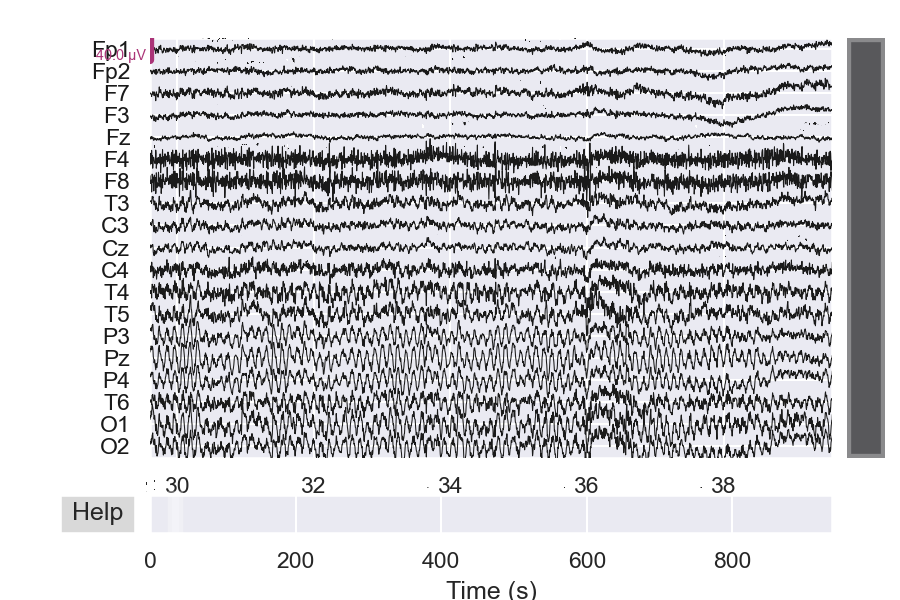

<IPython.core.display.Javascript object>


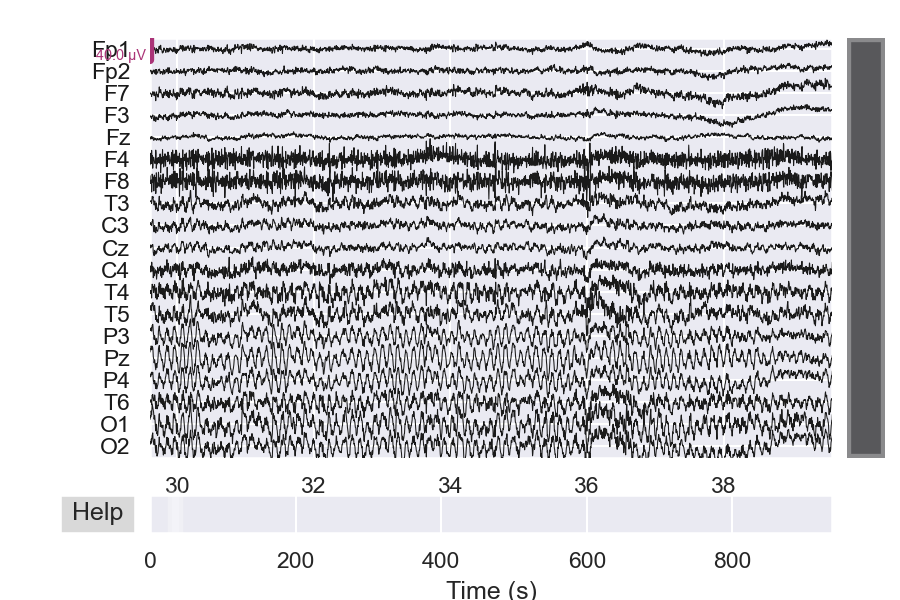

In [472]:
data.plot()

[[3.79400e+03 0.00000e+00 3.00000e+00]
 [4.18100e+03 0.00000e+00 3.00000e+00]
 [4.95900e+03 0.00000e+00 3.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 2.00000e+00]
 [4.71229e+05 0.00000e+00 2.00000e+00]
 [4.71594e+05 0.00000e+00 2.00000e+00]]


<IPython.core.display.Javascript object>


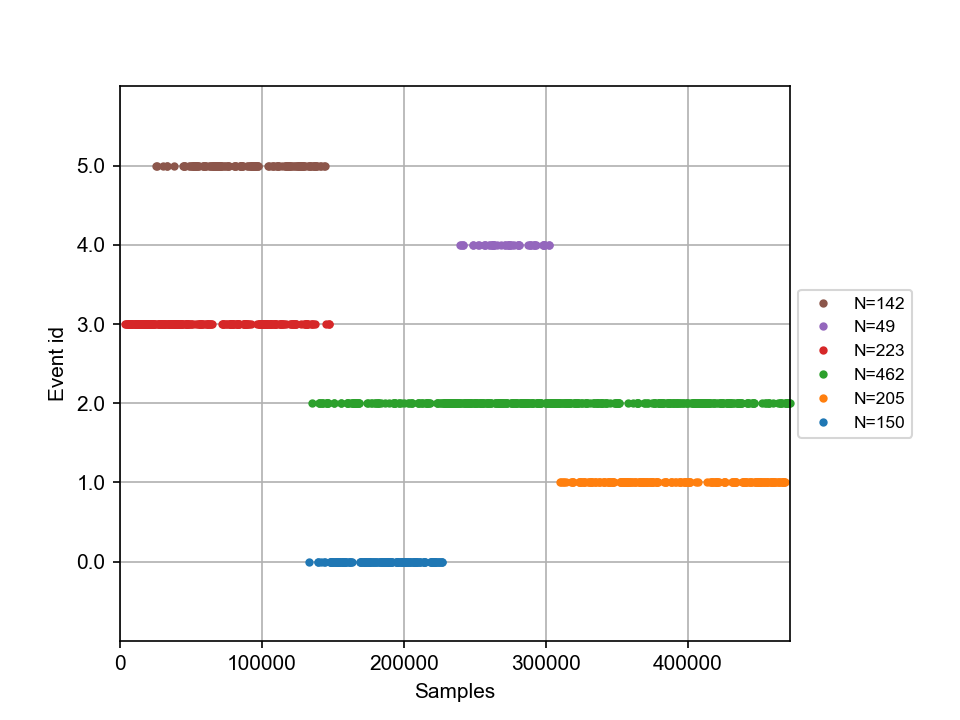

In [50]:
# Метод клатеризации Варда с учётом матрицы связности
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

aggl_clusters = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr).fit(psd_spectr_FA_ward)
#    print(aggl_clusters.labels_.shape)

cluster_events[:,2] = aggl_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

[[  3850      0      4]
 [  4350      0      4]
 [  4850      0      4]
 ...
 [470850      0      0]
 [471350      0      0]
 [471850      0      0]]


<IPython.core.display.Javascript object>


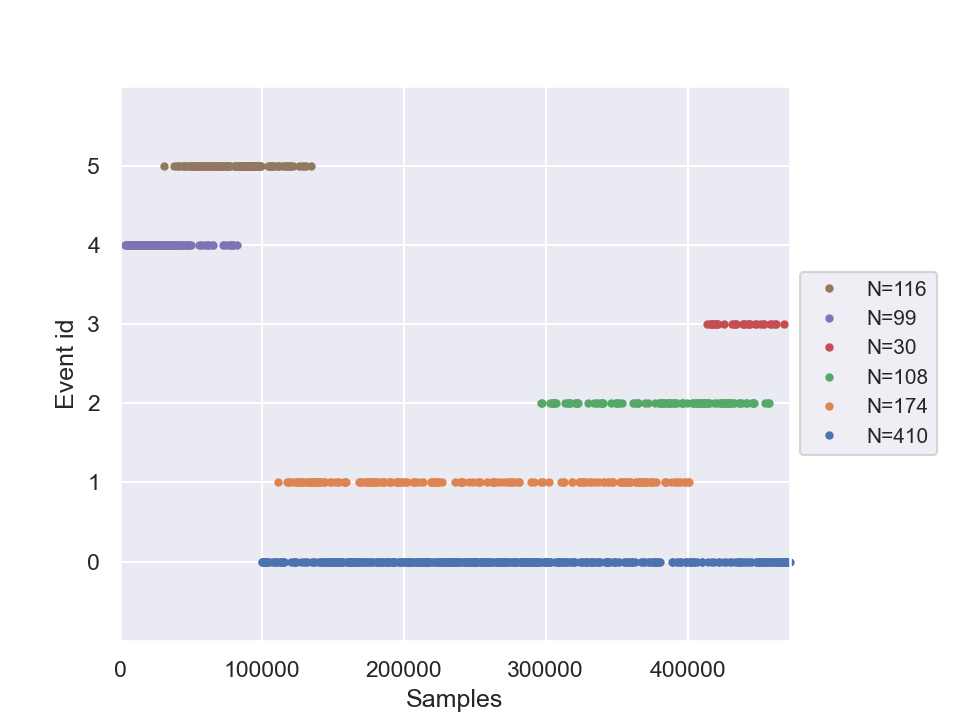

In [468]:
# Метод клатеризации Варда с учётом матрицы связности
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

cluster_events = fix_1s_events
#cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

aggl_clusters = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr).fit(psd_features)
#    print(aggl_clusters.labels_.shape)

cluster_events[:,2] = aggl_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

In [465]:
cluster_events[:,0].shape
cluster_events.shape

(937, 3)

<IPython.core.display.Javascript object>


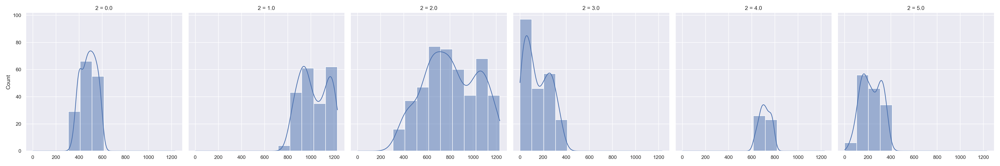

In [52]:
# Import seaborn
import seaborn as sns

# Apply the default theme
sns.set_theme()

# Диаграмма распределения эпох по кластерам
#sns.displot(cluster_events, x=cluster_events[:,0], col=cluster_events[:,2], kde=True)
#sns.displot(cluster_events, col=cluster_events[:,2], kde=True)

df_cluster_events = pd.DataFrame(cluster_events)
sns.displot(df_cluster_events, x=df_cluster_events.index, col=2, kde=True)
#df_cluster_events



In [53]:
# Сравнение методов кластеризации на основе оценок качества

print(82 * "_")
print("method \t\t silh\t cal-har\t dav-bold\t homo\t compl\t v-meas\t ARI\t AMI")

cluster_method = KMeans(n_clusters=9, random_state=0)
kmeans_ft = cluster_method.fit(psd_features)
bench_cluster_metrics(name="kmeans_ft", data=psd_features, labels_pred=kmeans_ft.labels_, labels_true=kmeans_ft.labels_)
kmeans_ft_sc = cluster_method.fit(psd_features_scaled)
bench_cluster_metrics(name="kmeans_ft_sc", data=psd_features_scaled, labels_pred=kmeans_ft_sc.labels_, labels_true=kmeans_ft_sc.labels_)
kmeans_pca = cluster_method.fit(psd_PCA_components)
bench_cluster_metrics(name="kmeans_pca", data=psd_PCA_components, labels_pred=kmeans_pca.labels_, labels_true=kmeans_pca.labels_)
kmeans_pca_sc = cluster_method.fit(psd_PCA_comp_scaled)
bench_cluster_metrics(name="kmeans_pca_sc", data=psd_PCA_comp_scaled, labels_pred=kmeans_pca_sc.labels_, labels_true=kmeans_pca_sc.labels_)
kmeans_FA_ward = cluster_method.fit(psd_spectr_FA_ward)
bench_cluster_metrics(name="kmeans_FA_ward", data=psd_spectr_FA_ward, labels_pred=kmeans_FA_ward.labels_, labels_true=kmeans_FA_ward.labels_)
kmeans_FA_corr = cluster_method.fit(psd_spectr_FA_corr)
bench_cluster_metrics(name="kmeans_FA_corr", data=psd_spectr_FA_corr, labels_pred=kmeans_FA_corr.labels_, labels_true=kmeans_FA_corr.labels_)



for linkage in ("ward", "average"):#, "complete", "single"):
    cluster_method = AgglomerativeClustering(linkage=linkage, n_clusters=9)
    
    aggl_clustering = cluster_method.fit(psd_features)
    bench_cluster_metrics(name=linkage+"_ft", data=psd_features, labels_pred=aggl_clustering.labels_, labels_true=kmeans_ft.labels_)
    aggl_clustering = cluster_method.fit(psd_features_scaled)
    bench_cluster_metrics(name=linkage+"_ft_sc", data=psd_features_scaled, labels_pred=aggl_clustering.labels_, labels_true=kmeans_ft_sc.labels_)
    aggl_clustering = cluster_method.fit(psd_PCA_components)
    bench_cluster_metrics(name=linkage+"_pca", data=psd_PCA_components, labels_pred=aggl_clustering.labels_, labels_true=kmeans_pca.labels_)
    aggl_clustering = cluster_method.fit(psd_PCA_comp_scaled)
    bench_cluster_metrics(name=linkage+"_pca_sc", data=psd_PCA_comp_scaled, labels_pred=aggl_clustering.labels_, labels_true=kmeans_pca_sc.labels_)
    aggl_clustering = cluster_method.fit(psd_spectr_FA_ward)
    bench_cluster_metrics(name=linkage+"_FA_ward", data=psd_spectr_FA_ward, labels_pred=aggl_clustering.labels_, labels_true=kmeans_FA_ward.labels_)
    aggl_clustering = cluster_method.fit(psd_spectr_FA_corr)
    bench_cluster_metrics(name=linkage+"_FA_corr", data=psd_spectr_FA_corr, labels_pred=aggl_clustering.labels_, labels_true=kmeans_FA_corr.labels_)

    
cluster_method = AgglomerativeClustering(linkage="ward", n_clusters=9, connectivity=connect_matrix)
aggl_clustering = cluster_method.fit(psd_features)
bench_cluster_metrics(name="ward_adj_ft", data=psd_features, labels_pred=aggl_clustering.labels_, labels_true=kmeans_ft.labels_)
aggl_clustering = cluster_method.fit(psd_features_scaled)
bench_cluster_metrics(name="ward_adj_ft_sc", data=psd_features_scaled, labels_pred=aggl_clustering.labels_, labels_true=kmeans_ft_sc.labels_)
aggl_clustering = cluster_method.fit(psd_PCA_components)
bench_cluster_metrics(name="ward_adj_pca", data=psd_PCA_components, labels_pred=aggl_clustering.labels_, labels_true=kmeans_pca.labels_)
aggl_clustering = cluster_method.fit(psd_PCA_comp_scaled)
bench_cluster_metrics(name="ward_adj_pca_sc", data=psd_PCA_comp_scaled, labels_pred=aggl_clustering.labels_, labels_true=kmeans_pca_sc.labels_)
aggl_clustering = cluster_method.fit(psd_spectr_FA_ward)
bench_cluster_metrics(name="ward_adj_FA_ward", data=psd_spectr_FA_ward, labels_pred=aggl_clustering.labels_, labels_true=kmeans_FA_ward.labels_)
aggl_clustering = cluster_method.fit(psd_spectr_FA_corr)
bench_cluster_metrics(name="ward_adj_FA_corr", data=psd_spectr_FA_corr, labels_pred=aggl_clustering.labels_, labels_true=kmeans_FA_corr.labels_)


print(82 * "_")

__________________________________________________________________________________
method 		 silh	 cal-har	 dav-bold	 homo	 compl	 v-meas	 ARI	 AMI
kmeans_ft	0.142	207.328		1.790		1.000	1.000	1.000	1.000	1.000
kmeans_ft_sc	0.112	153.608		1.983		1.000	1.000	1.000	1.000	1.000
kmeans_pca	0.171	264.445		1.607		1.000	1.000	1.000	1.000	1.000
kmeans_pca_sc	0.082	55.949		2.380		1.000	1.000	1.000	1.000	1.000
kmeans_FA_ward	0.189	323.597		1.491		1.000	1.000	1.000	1.000	1.000
kmeans_FA_corr	0.110	205.823		2.032		1.000	1.000	1.000	1.000	1.000
ward_ft  	0.103	181.991		1.941		0.461	0.479	0.470	0.300	0.463
ward_ft_sc	0.088	133.823		2.304		0.404	0.421	0.412	0.249	0.405
ward_pca 	0.119	227.508		1.808		0.454	0.468	0.461	0.309	0.454
ward_pca_sc	0.033	38.619		2.991		0.194	0.204	0.199	0.088	0.189
ward_FA_ward	0.144	276.774		1.628		0.436	0.456	0.446	0.275	0.439
ward_FA_corr	0.077	179.049		2.342		0.559	0.577	0.568	0.421	0.562
average_ft	0.111	139.966		1.585		0.395	0.528	0.452	0.263	0.445
average_ft_sc	0.061	

In [55]:
# Определение оптимального числка кластеров K-Means

from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

print(82 * "_")
print("method \t\t silh\t cal-har\t dav-bold\t homo\t compl\t v-meas\t ARI\t AMI")

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_ft = cluster_method.fit(psd_features)
    bench_cluster_metrics(name="kmeans_ft_"+str(n), data=psd_features, labels_pred=kmeans_ft.labels_, labels_true=kmeans_ft.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_FA_ward = cluster_method.fit(psd_spectr_FA_ward)
    bench_cluster_metrics(name="kmeans_FA_ward_"+str(n), data=psd_spectr_FA_ward, labels_pred=kmeans_FA_ward.labels_, labels_true=kmeans_ft.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_ft_sc = cluster_method.fit(psd_features_scaled)
    bench_cluster_metrics(name="kmeans_ft_sc_"+str(n), data=psd_features_scaled, labels_pred=kmeans_ft_sc.labels_, labels_true=kmeans_ft_sc.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_pca = cluster_method.fit(psd_PCA_components)
    bench_cluster_metrics(name="kmeans_pca_"+str(n), data=psd_PCA_components, labels_pred=kmeans_pca.labels_, labels_true=kmeans_pca.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_pca_sc = cluster_method.fit(psd_PCA_comp_scaled)
    bench_cluster_metrics(name="kmeans_pca_sc_"+str(n), data=psd_PCA_comp_scaled, labels_pred=kmeans_pca_sc.labels_, labels_true=kmeans_pca_sc.labels_)

for n in range(2,11):
    cluster_method = AgglomerativeClustering(linkage="ward", n_clusters=n, connectivity=connect_matrix)
    aggl_clustering = cluster_method.fit(psd_spectr_FA_ward)
    bench_cluster_metrics(name="ward_adj_FA_ward"+str(n), data=psd_spectr_FA_ward, labels_pred=aggl_clustering.labels_, labels_true=kmeans_FA_ward.labels_)

print(82 * "_")

__________________________________________________________________________________
method 		 silh	 cal-har	 dav-bold	 homo	 compl	 v-meas	 ARI	 AMI
kmeans_ft_2	0.250	541.027		1.458		1.000	1.000	1.000	1.000	1.000
kmeans_ft_3	0.173	393.857		1.798		1.000	1.000	1.000	1.000	1.000
kmeans_ft_4	0.166	341.462		1.702		1.000	1.000	1.000	1.000	1.000
kmeans_ft_5	0.153	299.031		1.744		1.000	1.000	1.000	1.000	1.000
kmeans_ft_6	0.152	271.604		1.777		1.000	1.000	1.000	1.000	1.000
kmeans_ft_7	0.150	246.634		1.823		1.000	1.000	1.000	1.000	1.000
kmeans_ft_8	0.130	224.262		1.877		1.000	1.000	1.000	1.000	1.000
kmeans_ft_9	0.142	207.328		1.790		1.000	1.000	1.000	1.000	1.000
kmeans_ft_10	0.126	192.618		1.891		1.000	1.000	1.000	1.000	1.000
kmeans_FA_ward_2	0.300	720.298		1.242		0.217	0.718	0.334	0.135	0.332
kmeans_FA_ward_3	0.253	550.803		1.427		0.367	0.774	0.498	0.263	0.496
kmeans_FA_ward_4	0.208	485.749		1.497		0.444	0.736	0.554	0.366	0.551
kmeans_FA_ward_5	0.208	436.764		1.495		0.505	0.709	0.590	0.422	0.586

In [56]:
print(psd_features.shape[0])

1231


(1231,)
[[3.79400e+03 0.00000e+00 3.00000e+00]
 [4.18100e+03 0.00000e+00 3.00000e+00]
 [4.95900e+03 0.00000e+00 3.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 2.00000e+00]
 [4.71229e+05 0.00000e+00 2.00000e+00]
 [4.71594e+05 0.00000e+00 2.00000e+00]]


<IPython.core.display.Javascript object>


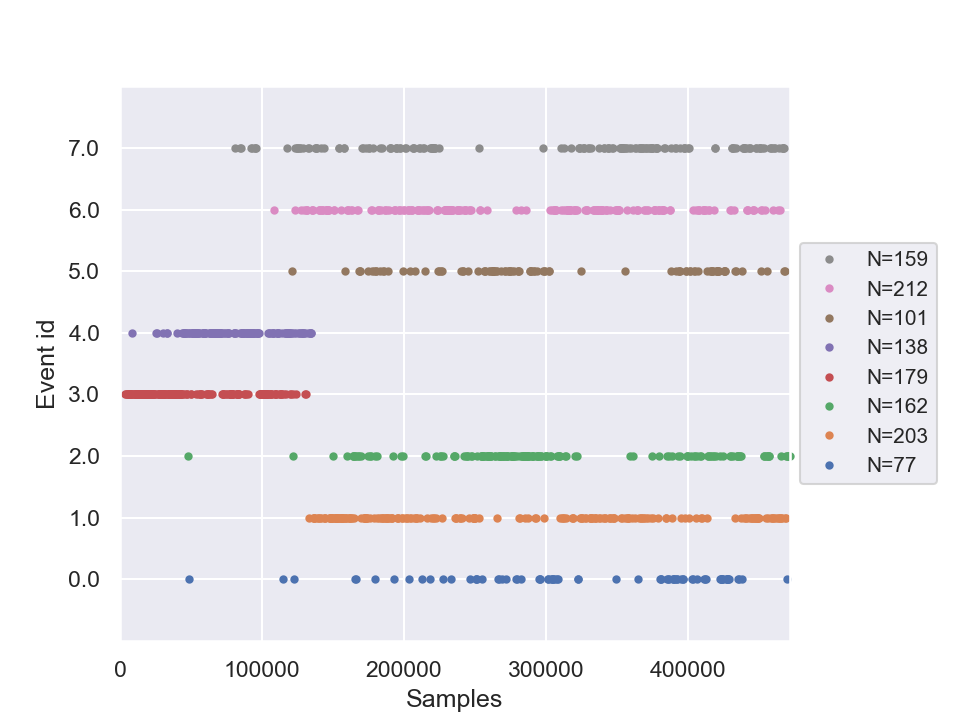

In [60]:
kmeans_clusters = cluster.KMeans(n_clusters=8).fit(psd_spectr_FA_ward)
print(kmeans_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = kmeans_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

(1231,)
[[3.79400e+03 0.00000e+00 6.00000e+00]
 [4.18100e+03 0.00000e+00 6.00000e+00]
 [4.95900e+03 0.00000e+00 6.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 4.00000e+00]
 [4.71229e+05 0.00000e+00 0.00000e+00]
 [4.71594e+05 0.00000e+00 0.00000e+00]]


<IPython.core.display.Javascript object>


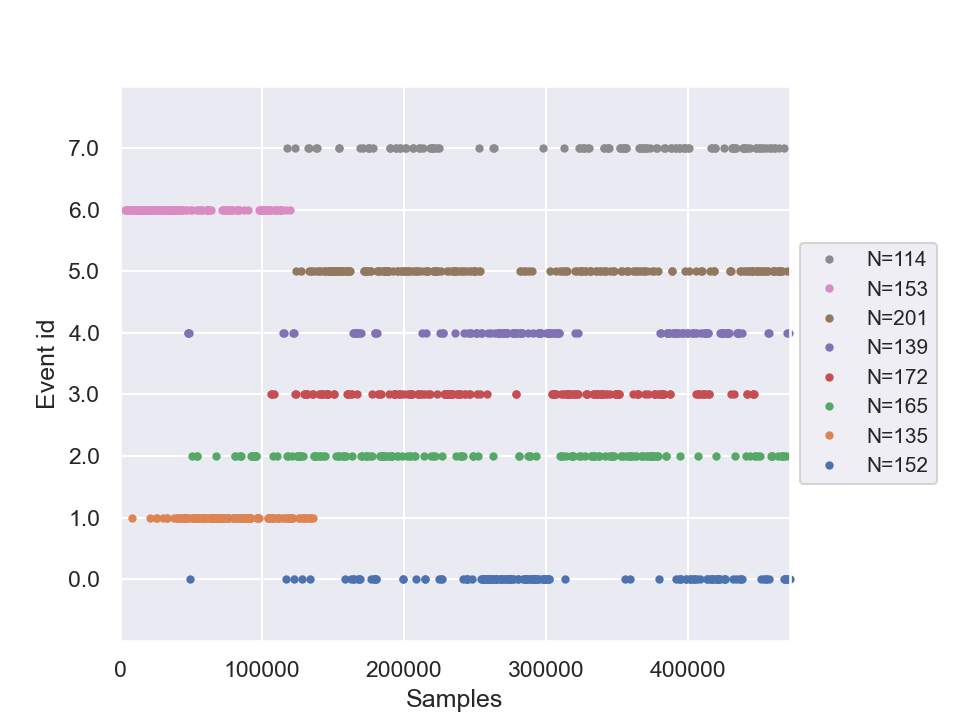

In [61]:
kmeans_clusters = cluster.KMeans(n_clusters=8).fit(psd_PCA_components)
print(kmeans_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = kmeans_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

(1231,)
[[3.79400e+03 0.00000e+00 2.00000e+00]
 [4.18100e+03 0.00000e+00 2.00000e+00]
 [4.95900e+03 0.00000e+00 2.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 0.00000e+00]
 [4.71229e+05 0.00000e+00 1.00000e+00]
 [4.71594e+05 0.00000e+00 1.00000e+00]]


<IPython.core.display.Javascript object>


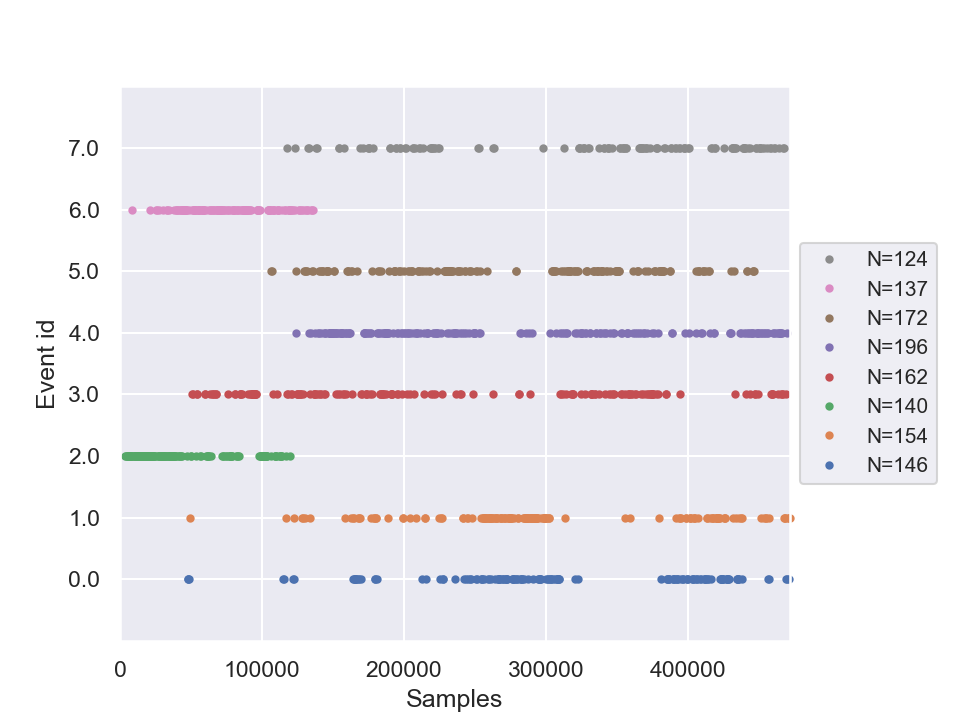

In [62]:
kmeans_clusters = cluster.KMeans(n_clusters=8).fit(psd_features)
print(kmeans_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = kmeans_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

<IPython.core.display.Javascript object>


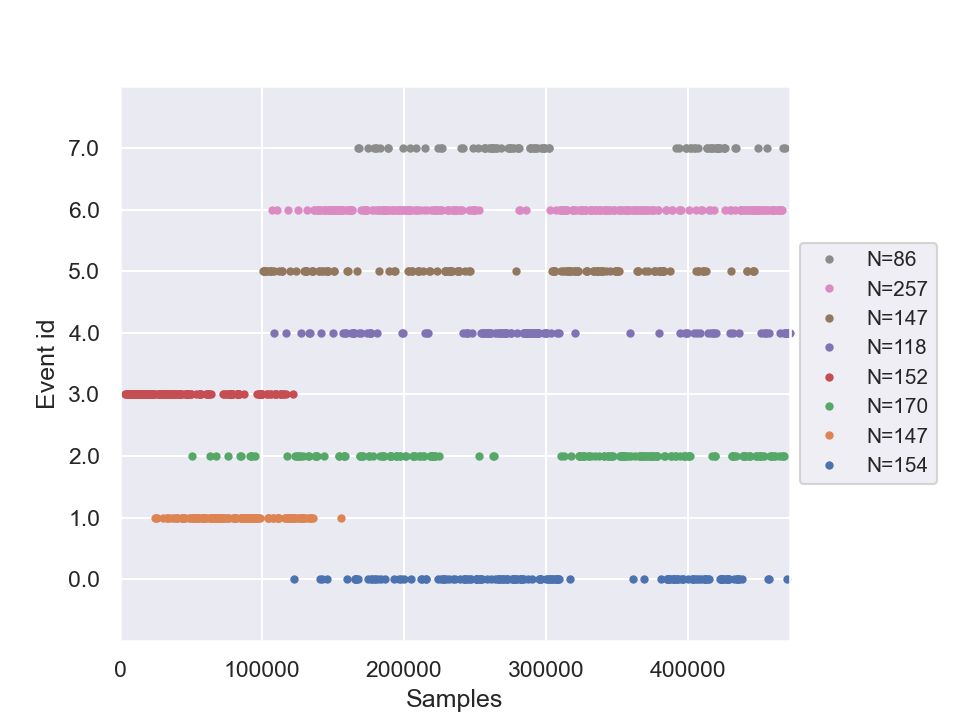

<IPython.core.display.Javascript object>


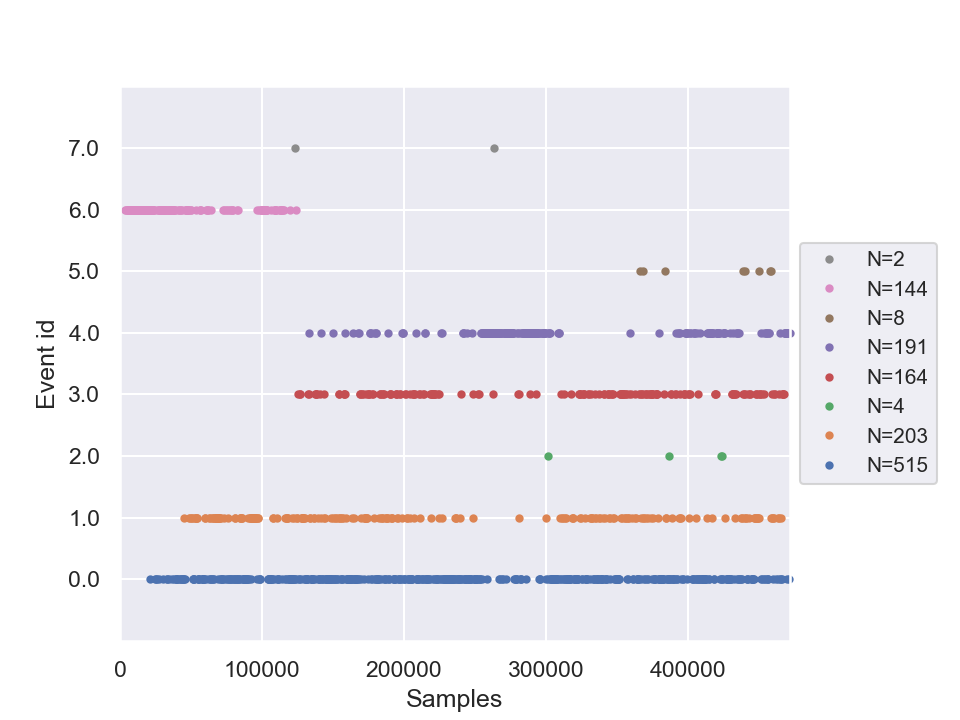

<IPython.core.display.Javascript object>


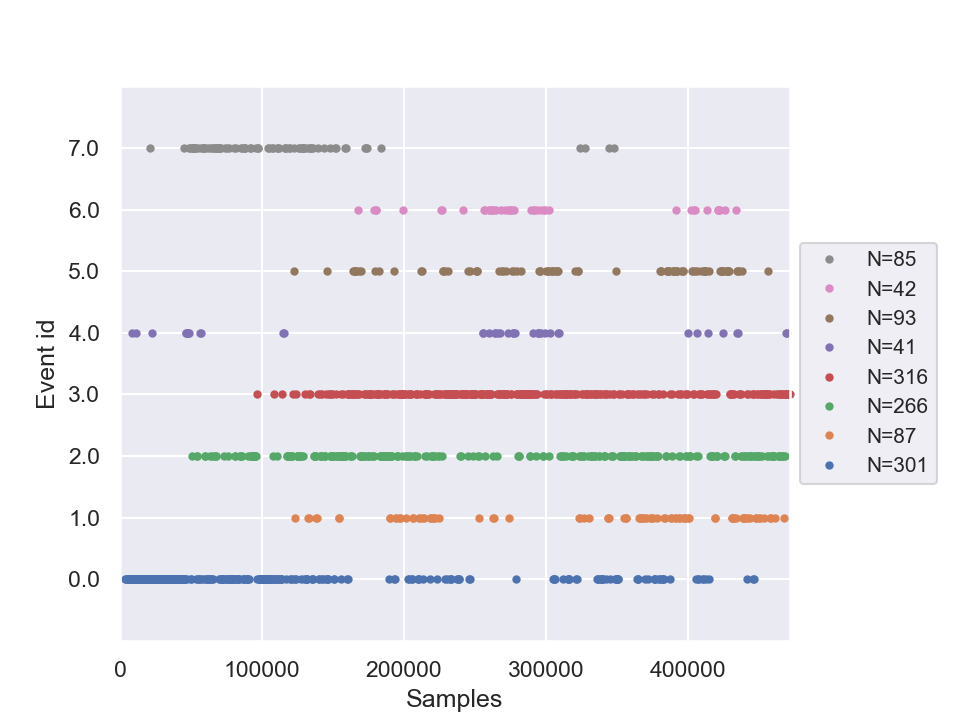

<IPython.core.display.Javascript object>


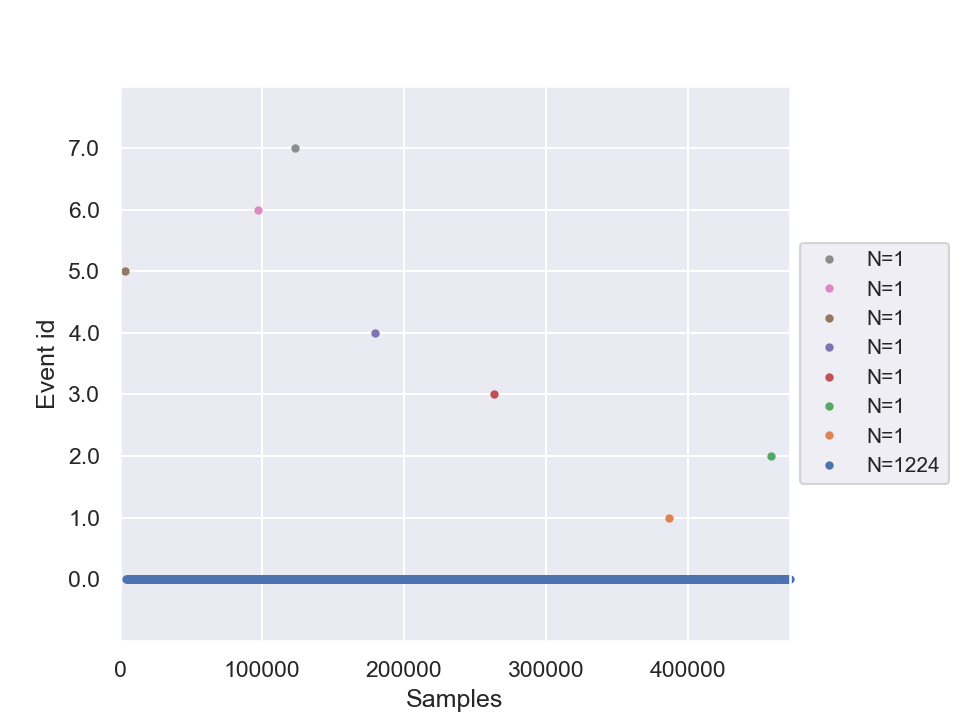

In [63]:
from sklearn.cluster import AgglomerativeClustering

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

for linkage in ("ward", "average", "complete", "single"):
    aggl_clusters = AgglomerativeClustering(linkage=linkage, n_clusters=8).fit(psd_PCA_components)
#    print(aggl_clusters.labels_.shape)

    cluster_events[:,2] = aggl_clusters.labels_
#    print(cluster_events)

    fig = mne.viz.plot_events(cluster_events)

(1231,)
[[ 3.79400e+03  0.00000e+00 -1.00000e+00]
 [ 4.18100e+03  0.00000e+00 -1.00000e+00]
 [ 4.95900e+03  0.00000e+00 -1.00000e+00]
 ...
 [ 4.70868e+05  0.00000e+00  3.00000e+00]
 [ 4.71229e+05  0.00000e+00  2.00000e+00]
 [ 4.71594e+05  0.00000e+00  2.00000e+00]]


<IPython.core.display.Javascript object>


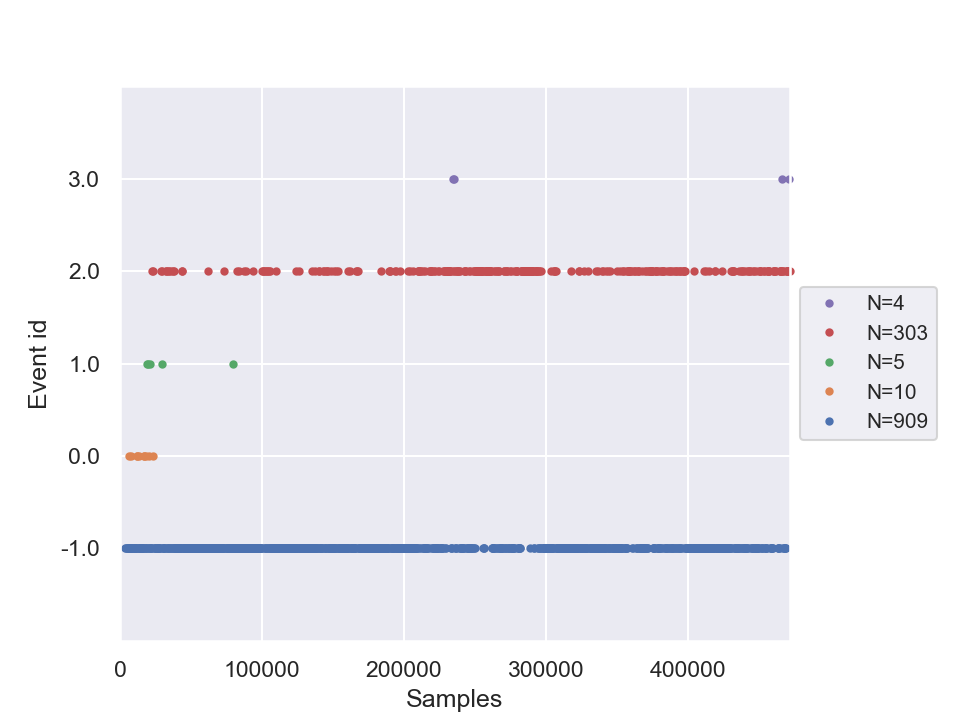

In [64]:
dbscan_clusters = cluster.DBSCAN(eps=2.4, min_samples=6).fit(psd_PCA_comp_scaled)
print(dbscan_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = dbscan_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

In [65]:
print(cluster_events.shape)
print(cluster_events)

(1231, 3)
[[ 3.79400e+03  0.00000e+00 -1.00000e+00]
 [ 4.18100e+03  0.00000e+00 -1.00000e+00]
 [ 4.95900e+03  0.00000e+00 -1.00000e+00]
 ...
 [ 4.70868e+05  0.00000e+00  3.00000e+00]
 [ 4.71229e+05  0.00000e+00  2.00000e+00]
 [ 4.71594e+05  0.00000e+00  2.00000e+00]]


In [66]:
print(psd_PCA_components.shape)

(1231, 15)


# IV and feature importance exploration

In [68]:
# Матрица связности для k соседних по времени эпох
K_NEIGHBORS = 20

def knn_con_matr(X):
    n_samples = len(X)
    sm = sp.sparse.lil_matrix((n_samples, n_samples), dtype=np.int8)
    for i in range(n_samples):
        for j in range(n_samples):
            if abs(i-j)<=K_NEIGHBORS: sm[i,j]=1
    return sm.tocsr()

connect_matrix = knn_con_matr(psd_features)

[[3.79400e+03 0.00000e+00 3.00000e+00]
 [4.18100e+03 0.00000e+00 3.00000e+00]
 [4.95900e+03 0.00000e+00 3.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 0.00000e+00]
 [4.71229e+05 0.00000e+00 0.00000e+00]
 [4.71594e+05 0.00000e+00 0.00000e+00]]
1231
4


<IPython.core.display.Javascript object>


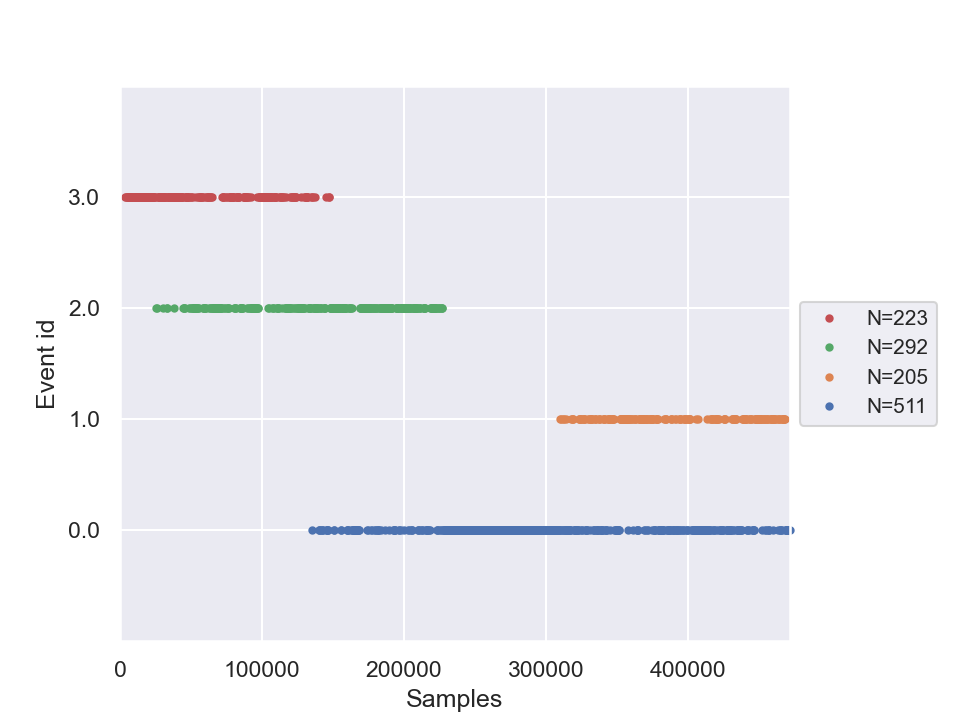

In [69]:
# Метод клатеризации Варда с учётом матрицы связности
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

aggl_clusters = AgglomerativeClustering(linkage="ward", n_clusters=4, connectivity=connect_matrix).fit(psd_spectr_FA_ward)
#    print(aggl_clusters.labels_.shape)

cluster_events[:,2] = aggl_clusters.labels_
print(cluster_events)
print(len(aggl_clusters.labels_))
print(aggl_clusters.n_clusters)

fig = mne.viz.plot_events(cluster_events)

[[  3850      0      3]
 [  4350      0      3]
 [  4850      0      3]
 ...
 [470850      0      0]
 [471350      0      0]
 [471850      0      0]]


<IPython.core.display.Javascript object>


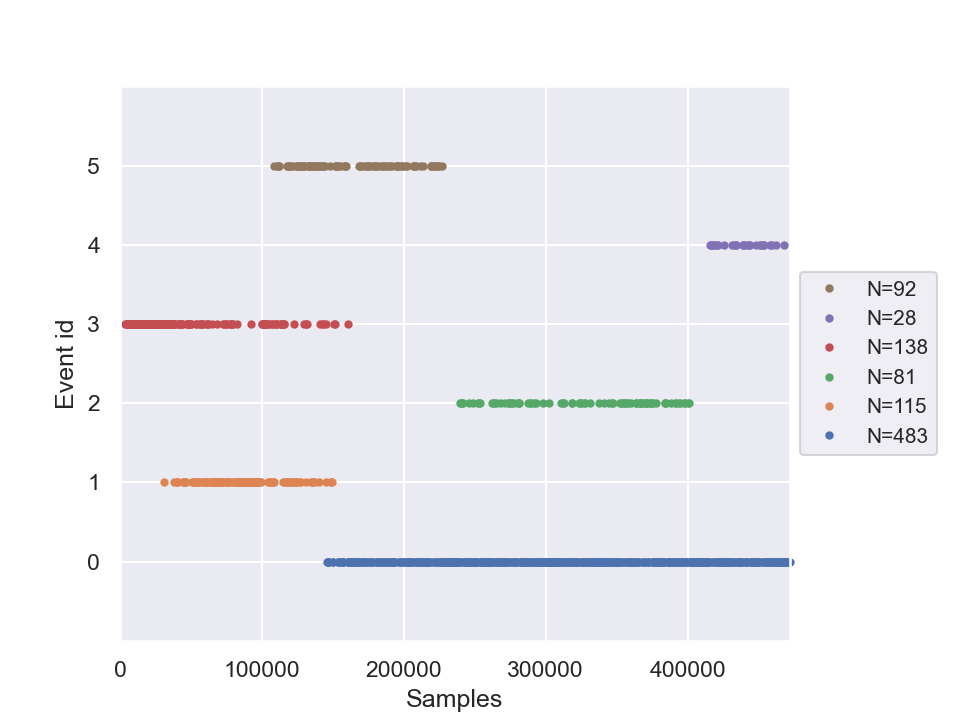

In [474]:
# Метод клатеризации Варда с учётом матрицы связности
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

cluster_events = fix_1s_events
#cluster_events = ecg_events
#cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

aggl_clusters = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr).fit(psd_spectr_FA_ward)
#    print(aggl_clusters.labels_.shape)

cluster_events[:,2] = aggl_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

In [80]:
from IPython.display import display

#display(WoE_df_list[0])

In [81]:
# Feature Agglomeration (Ward) PSD correlations

matr_corr = np.corrcoef(np.transpose(psd_spectr_FA_ward))
#print(matr_corr)

df_matr_corr = pd.DataFrame(matr_corr)#, index = data.ch_names, columns = data.ch_names)

def highlight(x):
    c1 = 'background-color: red'
    c2 = 'background-color: orange'
    c3 = ''

    m1 = x>0.8
    m2 = (x>0.6)&(x<=0.8)

    df1 = pd.DataFrame(c3, index=x.index, columns=x.columns)
    return df1.mask(m1, c1).mask(m2, c2)

s = df_matr_corr.style.apply(highlight, axis=None)
s = s.format('{:.2f}')
s = s.set_caption("Feature Agglomeration (Ward) PSD correlations")
s

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
0,1.00,0.69,0.63,0.79,0.65,0.74,0.79,0.35,0.91,0.57,0.51,0.68,0.47,-0.04,-0.01,0.17,0.06,0.34,0.25,0.04,0.31,0.04,0.14,-0.15,-0.08,-0.04,-0.20,0.17,-0.02,0.05
1,0.69,1.00,0.82,0.83,0.81,0.81,0.82,0.46,0.79,0.63,0.64,0.92,0.38,-0.07,0.01,0.16,0.01,0.34,0.20,0.00,0.20,-0.01,0.09,-0.28,-0.20,-0.13,-0.35,0.09,-0.14,-0.03
2,0.63,0.82,1.00,0.72,0.84,0.67,0.83,0.52,0.67,0.53,0.82,0.75,0.42,-0.08,0.05,0.13,-0.02,0.25,0.18,-0.02,0.22,-0.01,0.04,-0.20,-0.12,-0.09,-0.26,0.08,-0.08,0.03
3,0.79,0.83,0.72,1.00,0.75,0.82,0.78,0.44,0.85,0.72,0.58,0.77,0.41,0.04,0.06,0.20,0.10,0.35,0.30,0.11,0.30,0.11,0.18,-0.09,-0.04,0.01,-0.15,0.19,0.00,0.06
4,0.65,0.81,0.84,0.75,1.00,0.72,0.89,0.45,0.72,0.56,0.69,0.76,0.44,-0.06,0.00,0.16,0.04,0.32,0.19,0.01,0.28,0.01,0.09,-0.17,-0.15,-0.12,-0.26,0.04,-0.09,0.05
5,0.74,0.81,0.67,0.82,0.72,1.00,0.82,0.39,0.87,0.64,0.54,0.77,0.42,0.04,0.05,0.19,0.10,0.40,0.31,0.10,0.35,0.12,0.18,-0.10,-0.04,0.00,-0.16,0.16,0.02,0.08
6,0.79,0.82,0.83,0.78,0.89,0.82,1.00,0.48,0.83,0.61,0.74,0.82,0.64,-0.06,0.05,0.21,0.04,0.38,0.25,0.02,0.39,0.05,0.11,-0.13,-0.13,-0.07,-0.23,0.11,-0.04,0.06
7,0.35,0.46,0.52,0.44,0.45,0.39,0.48,1.00,0.44,0.85,0.70,0.59,0.46,0.71,0.50,0.78,0.72,0.44,0.48,0.72,0.28,0.58,0.72,0.14,0.06,0.12,0.04,0.17,0.09,0.08
8,0.91,0.79,0.67,0.85,0.72,0.87,0.83,0.44,1.00,0.70,0.57,0.80,0.52,0.04,0.04,0.25,0.14,0.49,0.33,0.12,0.35,0.11,0.23,-0.15,-0.09,-0.04,-0.22,0.17,-0.03,0.05
9,0.57,0.63,0.53,0.72,0.56,0.64,0.61,0.85,0.70,1.00,0.60,0.74,0.47,0.57,0.33,0.68,0.65,0.51,0.50,0.62,0.37,0.53,0.69,0.12,0.06,0.14,0.01,0.26,0.11,0.12


In [101]:
# IV calculation
def iv_woe(data, target, bins=10, show_woe=False):
    
    #Empty Dataframe
    newDF,woeDF = pd.DataFrame(), pd.DataFrame()
    
    #Extract Column Names
    cols = data.columns
    
    #Run WOE and IV on all the independent variables
    for ivars in cols[~cols.isin([target])]:
        if (data[ivars].dtype.kind in 'bifc') and (len(np.unique(data[ivars]))>10):
            binned_x = pd.qcut(data[ivars], bins,  duplicates='drop')
            d0 = pd.DataFrame({'x': binned_x, 'y': data[target]})
        else:
            d0 = pd.DataFrame({'x': data[ivars], 'y': data[target]})

        
        # Calculate the number of events in each group (bin)
        d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
        d.columns = ['Cutoff', 'N', 'Events']
        
        # Calculate % of events in each group.
        d['% of Events'] = np.maximum(d['Events'], 0.5) / d['Events'].sum()

        # Calculate the non events in each group.
        d['Non-Events'] = d['N'] - d['Events']
        # Calculate % of non events in each group.
        d['% of Non-Events'] = np.maximum(d['Non-Events'], 0.5) / d['Non-Events'].sum()

        # Calculate WOE by taking natural log of division of % of non-events and % of events
        d['WoE'] = np.log(d['% of Events']/d['% of Non-Events'])
        d['IV'] = d['WoE'] * (d['% of Events'] - d['% of Non-Events'])
        d.insert(loc=0, column='Variable', value=ivars)
        # print("Information value of " + ivars + " is " + str(round(d['IV'].sum(),6)))
        temp =pd.DataFrame({"Variable" : [ivars], "IV" : [d['IV'].sum()]}, columns = ["Variable", "IV"])
        newDF=pd.concat([newDF,temp], axis=0, ignore_index=True)
        woeDF=pd.concat([woeDF,d], axis=0, ignore_index=True)

        #Show WOE Table
        if show_woe == True:
            print(d)
    return newDF, woeDF

In [268]:
# Calculation of IV and WoE for given DataFrame of features and given clustering labels 
def IV_WoE_vars_clust(df_features, cluster_labels, n_bins=10):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    IV_list = []
    WoE_list = []
    df_vars_temp = df_features.copy()

    for i in range(n_clusters):
        # Add next target
        df_vars_temp.insert(n_features, 'Target_Cluster_'+str(i), (cluster_labels==i).astype(int))
        # Calculate IV & WoE
        df_IV, df_WoE = iv_woe(df_vars_temp, 'Target_Cluster_'+str(i), n_bins)
        IV_list.append(df_IV)
        WoE_list.append(df_WoE)
        # Drop previous targets
        target_names = df_vars_temp.columns.values[n_features:]
        df_vars_temp = df_vars_temp.drop(columns=target_names)

    return IV_list, WoE_list

# Finding features with best IV and constructing arrays of their IVs and WoEs 
def best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=5, n_bins=10, corr_threshold=0.5, IV_threshold=None):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    best_IV_list = []
    best_WoE_list = []
    
    IV_list, WoE_list = IV_WoE_vars_clust(df_features, cluster_labels, n_bins)
    
    df_matr_corr = df_features.corr()
    
    for i in range(n_clusters):
        df_vars_IV = IV_list[i].sort_values('IV', ascending = False)
        df_best_vars_IV = df_vars_IV.loc[[df_vars_IV.index[0]]]
        curr_var = 0
        next_var = 0    
        while (len(df_best_vars_IV.index) < n_best_vars) and (next_var < n_features):
            curr_var_ind = df_vars_IV.index[curr_var]
            next_var = curr_var + 1
            while (next_var < n_features):
                next_var_ind = df_vars_IV.index[next_var]
                best_vars_list = df_best_vars_IV['Variable'].to_numpy()
                best_corr_list = df_matr_corr[best_vars_list][df_matr_corr.index==df_matr_corr.columns[next_var_ind]].to_numpy()
                if (df_vars_IV.at[next_var_ind, 'IV'] >= IV_threshold) and (abs(best_corr_list).max() < corr_threshold):
                    df_best_vars_IV = df_best_vars_IV.append(df_vars_IV.loc[next_var_ind], ignore_index=True)
                    curr_var = next_var
                    break
                next_var += 1
        best_IV_list.append(df_best_vars_IV)

    for i in range(n_clusters):
        df_vars_WoE = WoE_list[i].drop(['% of Events', 'Non-Events', '% of Non-Events'], axis=1)
        df_best_vars_WoE = pd.DataFrame(columns=df_vars_WoE.columns)
        for j in range(len(best_IV_list[i].index)):
            curr_var = best_IV_list[i].at[j, 'Variable']
            df_best_vars_WoE = df_best_vars_WoE.concat(df_vars_WoE.loc[WoE_list[i]['Variable']==curr_var], ignore_index=True)
        best_WoE_list.append(df_best_vars_WoE)
        
    return best_IV_list, best_WoE_list


In [286]:
def plot_hist_best_vars(df_features, cluster_labels, best_IV_list, best_WoE_list=None):

    n_clusters = len(np.unique(cluster_labels))

    for i in range(n_clusters): 
        n_features = len(best_IV_list[i].index)
        fig, axs = plt.subplots(1, n_features+1, figsize=(3*(n_features+1), 2))
        plt.subplots_adjust(left=0.02)

        ind_clust = df_features.index[cluster_labels==i].to_numpy()
        axs[0].hist(ind_clust, range=(0,len(df_features.index)))
        axs[0].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
        axs[0].set_title("Cluster_" + str(i) + ",  size = " + str(len(ind_clust)), fontsize=11)           

        for j in range(n_features):
            var_name = best_IV_list[i].at[j,'Variable']
            var_IV = best_IV_list[i].at[j,'IV']
            var_full = df_features[var_name].to_numpy()
            var_clust = df_features[var_name][cluster_labels==i].to_numpy()
            axs[j+1].hist(var_full, density=True)
            axs[j+1].hist(var_clust, range=(var_full.min(),var_full.max()), density=True, alpha=0.7)
            axs[j+1].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
            axs[j+1].set_title(var_name+",  IV = {:.2f}".format(var_IV), fontsize=11)

    return fig, axs


def highlight(x, corr_middle=0.5, corr_high=0.75):
    color1 = 'background-color: red'
    color2 = 'background-color: orange'
    color3 = ''

    mask1 = (abs(x) >= corr_high)
    mask2 = (abs(x) >= corr_middle) & (abs(x) < corr_high)

    df1 = pd.DataFrame(color3, index=x.index, columns=x.columns)
    return df1.mask(mask1, color1).mask(mask2, color2)

def display_corr_matrix(df_corr, corr_middle=0.5, corr_high=0.75):
    s = df_corr.style.apply(highlight, corr_middle=corr_middle, corr_high=corr_high, axis=None)
    s = s.format('{:.2f}')
    display(s)
    return s

In [462]:
# DataFrame with 95 PSD features
df_psd_features = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_features.insert(i*n_channels+j, 'Psd_'+str_freq[i]+'_'+ data.ch_names[j], psds_spectr[i,j,:])


,Variable,IV
0,Psd_Delta_O2,1.626829
1,Psd_Gamma_F4,1.235246
2,Psd_Theta_O1,0.797770
3,Psd_Beta_Pz,0.726469
4,Psd_Alpha_Fp2,0.480141
5,Psd_Beta_Fz,0.403043


,Variable,IV
0,Psd_Delta_O1,2.999942
1,Psd_Gamma_F4,1.570836
2,Psd_Theta_P3,1.125378
3,Psd_Beta_Fp2,0.917208
4,Psd_Alpha_F7,0.569115
5,Psd_Theta_Cz,0.464496
6,Psd_Gamma_Fp2,0.400108


,Variable,IV
0,Psd_Beta_F8,2.998233
1,Psd_Theta_O2,2.520093
2,Psd_Gamma_O2,1.044876
3,Psd_Beta_Fp1,0.817567
4,Psd_Beta_F3,0.724576
5,Psd_Delta_Fz,0.674371
6,Psd_Gamma_Fz,0.604346
7,Psd_Theta_Pz,0.585132
8,Psd_Alpha_F4,0.442115


,Variable,IV
0,Psd_Gamma_F4,4.795331
1,Psd_Delta_T3,2.547126
2,Psd_Beta_C4,1.098180
3,Psd_Beta_Fp2,0.761581
4,Psd_Gamma_O1,0.745195
5,Psd_Theta_Cz,0.545016
6,Psd_Beta_Fp1,0.496367
7,Psd_Theta_T5,0.473768
8,Psd_Alpha_Fz,0.440739
9,Psd_Gamma_Fz,0.429056


,Variable,IV
0,Psd_Theta_T3,1.924546
1,Psd_Alpha_Pz,1.697981
2,Psd_Theta_Cz,1.392068
3,Psd_Beta_F4,0.926824
4,Psd_Alpha_Fp1,0.720809
5,Psd_Beta_T3,0.709171
6,Psd_Gamma_Fz,0.606215
7,Psd_Beta_Fp1,0.547753
8,Psd_Alpha_F4,0.498704
9,Psd_Gamma_O1,0.481940


,Variable,IV
0,Psd_Gamma_F4,3.727958
1,Psd_Delta_F3,1.548478
2,Psd_Beta_Fp1,0.871953
3,Psd_Gamma_O2,0.854723
4,Psd_Alpha_F4,0.851115
5,Psd_Theta_T5,0.839150
6,Psd_Gamma_Fz,0.791635
7,Psd_Beta_C4,0.756099
8,Psd_Beta_F3,0.735019


<IPython.core.display.Javascript object>


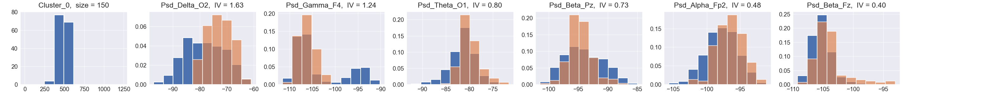

<IPython.core.display.Javascript object>


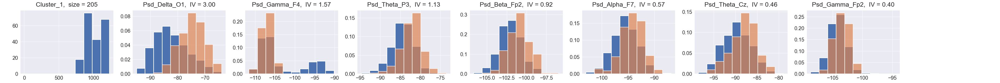

<IPython.core.display.Javascript object>


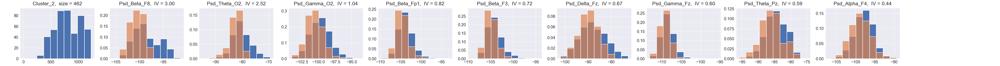

<IPython.core.display.Javascript object>


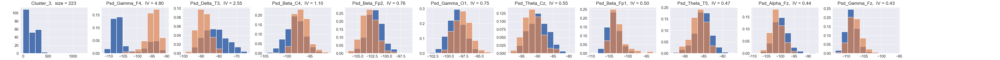

<IPython.core.display.Javascript object>


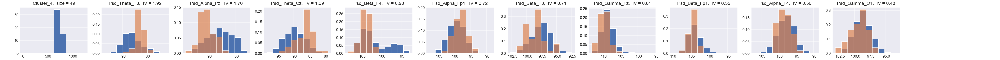

<IPython.core.display.Javascript object>


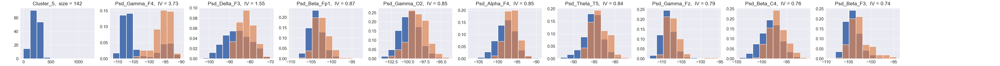

(<Figure size 3000x200 with 10 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 142'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_F4,  IV = 3.73'}>,
        <AxesSubplot:title={'center':'Psd_Delta_F3,  IV = 1.55'}>,
        <AxesSubplot:title={'center':'Psd_Beta_Fp1,  IV = 0.87'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_O2,  IV = 0.85'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F4,  IV = 0.85'}>,
        <AxesSubplot:title={'center':'Psd_Theta_T5,  IV = 0.84'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_Fz,  IV = 0.79'}>,
        <AxesSubplot:title={'center':'Psd_Beta_C4,  IV = 0.76'}>,
        <AxesSubplot:title={'center':'Psd_Beta_F3,  IV = 0.74'}>],
       dtype=object))

In [287]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_features, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_psd_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)

for i in range(len(best_IV_list)):
    display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_features, cluster_labels, best_IV_list)    
        

,Variable,IV
0,Psd_Gamma_F4,3.793702
1,Psd_Delta_F3,1.369785
2,Psd_Gamma_O2,0.879129
3,Psd_Beta_Fp1,0.645754
4,Psd_Beta_F3,0.617774
5,Psd_Alpha_F4,0.516360
6,Psd_Gamma_Fz,0.496286
7,Psd_Beta_C4,0.462667


,Variable,IV
0,Psd_Gamma_F4,3.431750
1,Psd_Beta_T5,0.857625
2,Psd_Theta_Fp2,0.786679
3,Psd_Gamma_Fz,0.712132
4,Psd_Beta_Cz,0.637939
5,Psd_Gamma_O2,0.629040
6,Psd_Beta_Fp1,0.627273
7,Psd_Alpha_F4,0.593303
8,Psd_Beta_F7,0.512264
9,Psd_Alpha_F3,0.426124


,Variable,IV
0,Psd_Delta_T4,3.307646
1,Psd_Beta_F4,1.208919
2,Psd_Theta_Cz,1.144058
3,Psd_Theta_P3,1.067807
4,Psd_Theta_Fp1,0.915441
5,Psd_Beta_Fp2,0.581515
6,Psd_Alpha_F3,0.566325


,Variable,IV
0,Psd_Gamma_F4,3.952826
1,Psd_Delta_O2,2.191816
2,Psd_Theta_Fz,2.168095
3,Psd_Alpha_Fp2,1.041142
4,Psd_Theta_T6,0.787765
5,Psd_Theta_Cz,0.777334
6,Psd_Beta_C4,0.740021
7,Psd_Alpha_F7,0.738686
8,Psd_Beta_Fp1,0.416646


,Variable,IV
0,Psd_Delta_T4,2.694580
1,Psd_Theta_P3,1.736234
2,Psd_Theta_Fp1,1.726428
3,Psd_Gamma_F4,1.152179
4,Psd_Beta_Fp2,1.014392
5,Psd_Beta_Fz,0.830794
6,Psd_Theta_Cz,0.760625
7,Psd_Alpha_F7,0.643821
8,Psd_Beta_F3,0.626946
9,Psd_Gamma_Fz,0.591486


,Variable,IV
0,Psd_Delta_P4,2.284411
1,Psd_Gamma_F4,1.290413
2,Psd_Alpha_F3,0.895407
3,Psd_Alpha_F7,0.597708
4,Psd_Alpha_Pz,0.567161
5,Psd_Alpha_Fp2,0.557614
6,Psd_Alpha_F4,0.445781
7,Psd_Theta_T6,0.417737
8,Psd_Beta_Fp1,0.408095


<IPython.core.display.Javascript object>


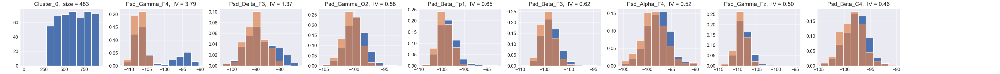

<IPython.core.display.Javascript object>


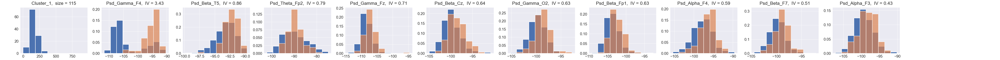

<IPython.core.display.Javascript object>


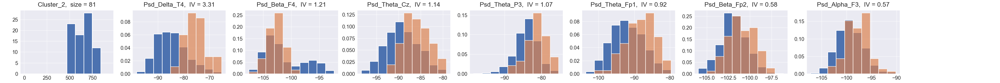

<IPython.core.display.Javascript object>


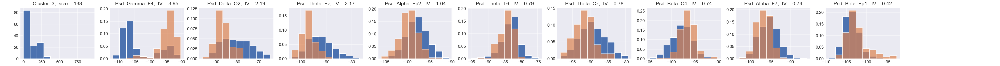

<IPython.core.display.Javascript object>


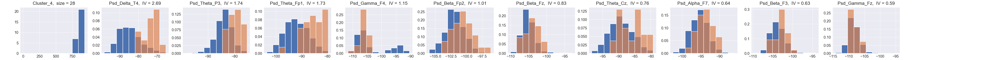

<IPython.core.display.Javascript object>


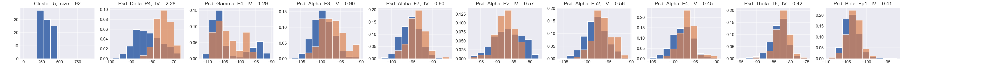

(<Figure size 3000x200 with 10 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 92'}>,
        <AxesSubplot:title={'center':'Psd_Delta_P4,  IV = 2.28'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_F4,  IV = 1.29'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F3,  IV = 0.90'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F7,  IV = 0.60'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_Pz,  IV = 0.57'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_Fp2,  IV = 0.56'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F4,  IV = 0.45'}>,
        <AxesSubplot:title={'center':'Psd_Theta_T6,  IV = 0.42'}>,
        <AxesSubplot:title={'center':'Psd_Beta_Fp1,  IV = 0.41'}>],
       dtype=object))

In [463]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_features, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_psd_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)

for i in range(len(best_IV_list)):
    display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_features, cluster_labels, best_IV_list)    
        

In [288]:
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_psd_features[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    display_corr_matrix(best_corr_list[i], corr_middle=0.3, corr_high=0.4)
    #display(best_corr_list[i])

,Psd_Delta_O2,Psd_Gamma_F4,Psd_Theta_O1,Psd_Beta_Pz,Psd_Alpha_Fp2,Psd_Beta_Fz
Psd_Delta_O2,1.00,-0.15,0.46,0.00,0.41,0.23
Psd_Gamma_F4,-0.15,1.00,-0.03,0.34,-0.06,0.07
Psd_Theta_O1,0.46,-0.03,1.00,0.45,0.40,0.22
Psd_Beta_Pz,0.00,0.34,0.45,1.00,0.02,0.10
Psd_Alpha_Fp2,0.41,-0.06,0.40,0.02,1.00,0.28
Psd_Beta_Fz,0.23,0.07,0.22,0.10,0.28,1.00


,Psd_Delta_O1,Psd_Gamma_F4,Psd_Theta_P3,Psd_Beta_Fp2,Psd_Alpha_F7,Psd_Theta_Cz,Psd_Gamma_Fp2
Psd_Delta_O1,1.00,-0.38,0.43,0.37,0.32,0.45,0.11
Psd_Gamma_F4,-0.38,1.00,0.02,-0.18,-0.15,-0.11,0.21
Psd_Theta_P3,0.43,0.02,1.00,0.19,0.39,0.40,0.06
Psd_Beta_Fp2,0.37,-0.18,0.19,1.00,0.33,0.30,0.38
Psd_Alpha_F7,0.32,-0.15,0.39,0.33,1.00,0.16,-0.00
Psd_Theta_Cz,0.45,-0.11,0.40,0.30,0.16,1.00,0.13
Psd_Gamma_Fp2,0.11,0.21,0.06,0.38,-0.00,0.13,1.00


,Psd_Beta_F8,Psd_Theta_O2,Psd_Gamma_O2,Psd_Beta_Fp1,Psd_Beta_F3,Psd_Delta_Fz,Psd_Gamma_Fz,Psd_Theta_Pz,Psd_Alpha_F4
Psd_Beta_F8,1.00,0.26,0.46,0.49,0.28,-0.10,0.41,0.37,0.38
Psd_Theta_O2,0.26,1.00,0.38,0.20,0.38,0.45,0.12,0.44,0.35
Psd_Gamma_O2,0.46,0.38,1.00,0.32,0.28,0.04,0.39,0.23,0.18
Psd_Beta_Fp1,0.49,0.20,0.32,1.00,0.40,0.03,0.40,0.15,0.23
Psd_Beta_F3,0.28,0.38,0.28,0.40,1.00,0.23,0.25,0.21,0.27
Psd_Delta_Fz,-0.10,0.45,0.04,0.03,0.23,1.00,0.09,0.16,0.14
Psd_Gamma_Fz,0.41,0.12,0.39,0.40,0.25,0.09,1.00,0.13,0.14
Psd_Theta_Pz,0.37,0.44,0.23,0.15,0.21,0.16,0.13,1.00,0.36
Psd_Alpha_F4,0.38,0.35,0.18,0.23,0.27,0.14,0.14,0.36,1.00


,Psd_Gamma_F4,Psd_Delta_T3,Psd_Beta_C4,Psd_Beta_Fp2,Psd_Gamma_O1,Psd_Theta_Cz,Psd_Beta_Fp1,Psd_Theta_T5,Psd_Alpha_Fz,Psd_Gamma_Fz
Psd_Gamma_F4,1.00,-0.37,0.42,-0.18,0.45,-0.11,0.45,-0.06,-0.11,0.45
Psd_Delta_T3,-0.37,1.00,-0.11,0.42,-0.04,0.45,0.01,0.39,0.26,-0.04
Psd_Beta_C4,0.42,-0.11,1.00,0.09,0.25,0.13,0.37,0.29,0.05,0.26
Psd_Beta_Fp2,-0.18,0.42,0.09,1.00,0.04,0.30,0.25,0.33,0.31,0.14
Psd_Gamma_O1,0.45,-0.04,0.25,0.04,1.00,0.05,0.29,0.01,-0.04,0.36
Psd_Theta_Cz,-0.11,0.45,0.13,0.30,0.05,1.00,0.08,0.47,0.30,0.02
Psd_Beta_Fp1,0.45,0.01,0.37,0.25,0.29,0.08,1.00,0.14,0.20,0.40
Psd_Theta_T5,-0.06,0.39,0.29,0.33,0.01,0.47,0.14,1.00,0.36,0.04
Psd_Alpha_Fz,-0.11,0.26,0.05,0.31,-0.04,0.30,0.20,0.36,1.00,0.21
Psd_Gamma_Fz,0.45,-0.04,0.26,0.14,0.36,0.02,0.40,0.04,0.21,1.00


,Psd_Theta_T3,Psd_Alpha_Pz,Psd_Theta_Cz,Psd_Beta_F4,Psd_Alpha_Fp1,Psd_Beta_T3,Psd_Gamma_Fz,Psd_Beta_Fp1,Psd_Alpha_F4,Psd_Gamma_O1
Psd_Theta_T3,1.00,-0.06,0.48,-0.26,0.34,0.47,-0.06,0.03,0.18,-0.03
Psd_Alpha_Pz,-0.06,1.00,0.08,0.40,-0.14,0.49,0.16,0.18,0.34,0.17
Psd_Theta_Cz,0.48,0.08,1.00,-0.04,0.32,0.17,0.02,0.08,0.22,0.05
Psd_Beta_F4,-0.26,0.40,-0.04,1.00,-0.01,0.16,0.42,0.49,0.40,0.43
Psd_Alpha_Fp1,0.34,-0.14,0.32,-0.01,1.00,0.19,0.02,0.38,0.26,-0.01
Psd_Beta_T3,0.47,0.49,0.17,0.16,0.19,1.00,0.12,0.29,0.32,0.14
Psd_Gamma_Fz,-0.06,0.16,0.02,0.42,0.02,0.12,1.00,0.40,0.14,0.36
Psd_Beta_Fp1,0.03,0.18,0.08,0.49,0.38,0.29,0.40,1.00,0.23,0.29
Psd_Alpha_F4,0.18,0.34,0.22,0.40,0.26,0.32,0.14,0.23,1.00,0.13
Psd_Gamma_O1,-0.03,0.17,0.05,0.43,-0.01,0.14,0.36,0.29,0.13,1.00


,Psd_Gamma_F4,Psd_Delta_F3,Psd_Beta_Fp1,Psd_Gamma_O2,Psd_Alpha_F4,Psd_Theta_T5,Psd_Gamma_Fz,Psd_Beta_C4,Psd_Beta_F3
Psd_Gamma_F4,1.00,-0.15,0.45,0.43,0.22,-0.06,0.45,0.42,0.18
Psd_Delta_F3,-0.15,1.00,0.13,0.20,0.15,0.38,0.08,0.02,0.43
Psd_Beta_Fp1,0.45,0.13,1.00,0.32,0.23,0.14,0.40,0.37,0.40
Psd_Gamma_O2,0.43,0.20,0.32,1.00,0.18,0.16,0.39,0.29,0.28
Psd_Alpha_F4,0.22,0.15,0.23,0.18,1.00,0.43,0.14,0.44,0.27
Psd_Theta_T5,-0.06,0.38,0.14,0.16,0.43,1.00,0.04,0.29,0.20
Psd_Gamma_Fz,0.45,0.08,0.40,0.39,0.14,0.04,1.00,0.26,0.25
Psd_Beta_C4,0.42,0.02,0.37,0.29,0.44,0.29,0.26,1.00,0.29
Psd_Beta_F3,0.18,0.43,0.40,0.28,0.27,0.20,0.25,0.29,1.00


In [289]:
n_features_FA_ward = len(np.transpose(psd_spectr_FA_ward))

print(len(df_psd_FA_ward.columns))
target_names = df_psd_FA_ward.columns.values[n_features_FA_ward:]
df_psd_FA_ward=df_psd_FA_ward.drop(columns=target_names)
print(len(df_psd_FA_ward.columns))
   

30
30


,Variable,IV
0,Psd_Delta_FA_3,1.624453
1,Psd_Gamma_FA_2,1.259410
2,Psd_Alpha_FA_0,0.735296
3,Psd_Alpha_FA_1,0.568443
4,Psd_Alpha_FA_5,0.460294


,Variable,IV
0,Psd_Delta_FA_1,3.001466
1,Psd_Gamma_FA_2,1.447485
2,Psd_Theta_FA_1,1.287762
3,Psd_Alpha_FA_5,0.569115
4,Psd_Beta_FA_0,0.510730


,Variable,IV
0,Psd_Gamma_FA_2,2.553250
1,Psd_Theta_FA_3,2.394489
2,Psd_Beta_FA_2,1.006834
3,Psd_Gamma_FA_5,0.604346


,Variable,IV
0,Psd_Gamma_FA_2,4.858075
1,Psd_Delta_FA_1,2.553806
2,Psd_Gamma_FA_5,0.429056
3,Psd_Alpha_FA_0,0.417874


,Variable,IV
0,Psd_Delta_FA_1,1.942594
1,Psd_Alpha_FA_1,1.423099
2,Psd_Beta_FA_5,0.926824
3,Psd_Gamma_FA_5,0.606215
4,Psd_Beta_FA_2,0.435848


,Variable,IV
0,Psd_Gamma_FA_2,3.779436
1,Psd_Theta_FA_2,1.438728
2,Psd_Beta_FA_2,1.036506
3,Psd_Gamma_FA_5,0.791635
4,Psd_Beta_FA_1,0.580295


<IPython.core.display.Javascript object>


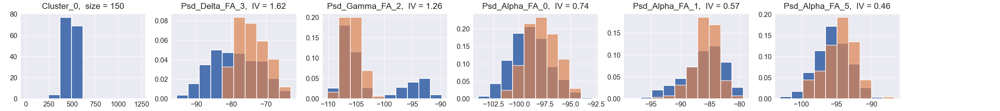

<IPython.core.display.Javascript object>


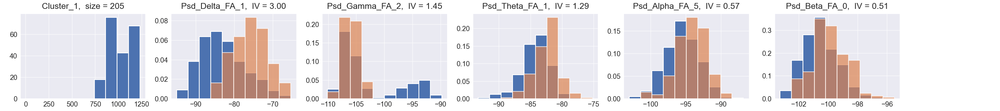

<IPython.core.display.Javascript object>


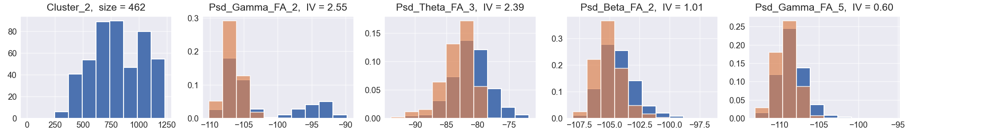

<IPython.core.display.Javascript object>


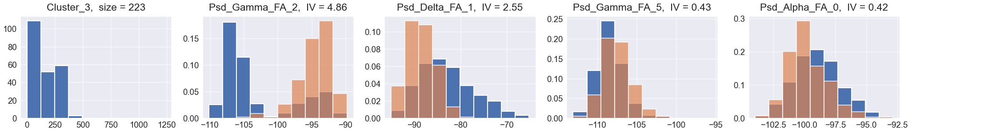

<IPython.core.display.Javascript object>


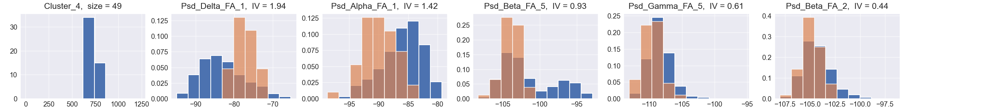

<IPython.core.display.Javascript object>


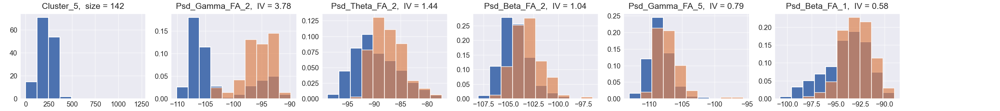

(<Figure size 1800x200 with 6 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 142'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_FA_2,  IV = 3.78'}>,
        <AxesSubplot:title={'center':'Psd_Theta_FA_2,  IV = 1.44'}>,
        <AxesSubplot:title={'center':'Psd_Beta_FA_2,  IV = 1.04'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_FA_5,  IV = 0.79'}>,
        <AxesSubplot:title={'center':'Psd_Beta_FA_1,  IV = 0.58'}>],
       dtype=object))

In [290]:
# DataFrame with 30 PSD FA_ward components
# IV & WoE calculation

N_BEST_FEATURES = 10
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_psd_FA_ward, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
for i in range(len(best_IV_list)):
    display(best_IV_list[i])
    
# Plotting best features for given clustering
plot_hist_best_vars(df_psd_FA_ward, cluster_labels, best_IV_list)    
        

In [285]:
# Display correlation matrix of best features for each cluster
best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_psd_FA_ward[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    display_corr_matrix(best_corr_list[i], corr_middle=0.3, corr_high=0.4)
    #display(best_corr_list[i])

,Psd_Delta_FA_3,Psd_Gamma_FA_2,Psd_Alpha_FA_0,Psd_Alpha_FA_1,Psd_Alpha_FA_5
Psd_Delta_FA_3,1.00,-0.15,0.41,0.04,0.35
Psd_Gamma_FA_2,-0.15,1.00,-0.00,0.24,-0.15
Psd_Alpha_FA_0,0.41,-0.00,1.00,0.21,0.44
Psd_Alpha_FA_1,0.04,0.24,0.21,1.00,0.35
Psd_Alpha_FA_5,0.35,-0.15,0.44,0.35,1.00


,Psd_Delta_FA_1,Psd_Gamma_FA_2,Psd_Theta_FA_1,Psd_Alpha_FA_5,Psd_Beta_FA_0
Psd_Delta_FA_1,1.00,-0.35,0.46,0.34,0.20
Psd_Gamma_FA_2,-0.35,1.00,0.04,-0.15,0.21
Psd_Theta_FA_1,0.46,0.04,1.00,0.44,0.48
Psd_Alpha_FA_5,0.34,-0.15,0.44,1.00,0.35
Psd_Beta_FA_0,0.20,0.21,0.48,0.35,1.00


,Psd_Gamma_FA_2,Psd_Theta_FA_3,Psd_Beta_FA_2,Psd_Gamma_FA_5
Psd_Gamma_FA_2,1.00,0.01,0.30,0.45
Psd_Theta_FA_3,0.01,1.00,0.37,0.12
Psd_Beta_FA_2,0.30,0.37,1.00,0.49
Psd_Gamma_FA_5,0.45,0.12,0.49,1.00


,Psd_Gamma_FA_2,Psd_Delta_FA_1,Psd_Gamma_FA_5,Psd_Alpha_FA_0
Psd_Gamma_FA_2,1.00,-0.35,0.45,-0.00
Psd_Delta_FA_1,-0.35,1.00,-0.03,0.38
Psd_Gamma_FA_5,0.45,-0.03,1.00,0.16
Psd_Alpha_FA_0,-0.00,0.38,0.16,1.00


,Psd_Delta_FA_1,Psd_Alpha_FA_1,Psd_Beta_FA_5,Psd_Gamma_FA_5,Psd_Beta_FA_2
Psd_Delta_FA_1,1.00,-0.07,-0.28,-0.03,0.20
Psd_Alpha_FA_1,-0.07,1.00,0.32,0.13,0.23
Psd_Beta_FA_5,-0.28,0.32,1.00,0.42,0.41
Psd_Gamma_FA_5,-0.03,0.13,0.42,1.00,0.49
Psd_Beta_FA_2,0.20,0.23,0.41,0.49,1.00


,Psd_Gamma_FA_2,Psd_Theta_FA_2,Psd_Beta_FA_2,Psd_Gamma_FA_5,Psd_Beta_FA_1
Psd_Gamma_FA_2,1.00,-0.22,0.30,0.45,0.23
Psd_Theta_FA_2,-0.22,1.00,0.35,0.05,0.12
Psd_Beta_FA_2,0.30,0.35,1.00,0.49,0.30
Psd_Gamma_FA_5,0.45,0.05,0.49,1.00,0.16
Psd_Beta_FA_1,0.23,0.12,0.30,0.16,1.00


In [151]:
# Feature Agglomeration (Eulidean, Ward, PSD features)
n_FA_comp = 6

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)#, distance_threshold=200)

psd_delta_FA = FA_transformer.fit_transform(psd_features[:, 0:19])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_theta_FA = FA_transformer.fit_transform(psd_features[:, 19:19*2])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_alpha_FA = FA_transformer.fit_transform(psd_features[:, 19*2:19*3])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))
    
psd_beta_FA = FA_transformer.fit_transform(psd_features[:, 19*3:19*4])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_gamma_FA = FA_transformer.fit_transform(psd_features[:, 19*4:19*5])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_spectr_FA_ward = np.concatenate((psd_delta_FA, psd_theta_FA, psd_alpha_FA, psd_beta_FA, psd_gamma_FA), axis=1)   
print(psd_spectr_FA_ward.shape)                                             

[0 0 5 5 4 4 1 1 2 2 2 1 2 2 2 3 2 1 3]
Features in cluster 0: ['Fp1', 'Fp2']
Features in cluster 1: ['F8', 'T3', 'T4', 'O1']
Features in cluster 2: ['C3', 'Cz', 'C4', 'T5', 'P3', 'Pz', 'T6']
Features in cluster 3: ['P4', 'O2']
Features in cluster 4: ['Fz', 'F4']
Features in cluster 5: ['F7', 'F3']
[0 2 2 0 0 0 5 5 4 4 4 1 1 1 1 3 1 3 3]
Features in cluster 0: ['Fp1', 'F3', 'Fz', 'F4']
Features in cluster 1: ['T4', 'T5', 'P3', 'Pz', 'T6']
Features in cluster 2: ['Fp2', 'F7']
Features in cluster 3: ['P4', 'O1', 'O2']
Features in cluster 4: ['C3', 'Cz', 'C4']
Features in cluster 5: ['F8', 'T3']
[0 0 5 0 0 0 3 3 2 2 3 4 1 1 1 4 4 4 4]
Features in cluster 0: ['Fp1', 'Fp2', 'F3', 'Fz', 'F4']
Features in cluster 1: ['T5', 'P3', 'Pz']
Features in cluster 2: ['C3', 'Cz']
Features in cluster 3: ['F8', 'T3', 'C4']
Features in cluster 4: ['T4', 'P4', 'T6', 'O1', 'O2']
Features in cluster 5: ['F7']
[2 0 0 2 2 5 3 3 0 0 3 1 1 1 1 1 1 4 4]
Features in cluster 0: ['Fp2', 'F7', 'C3', 'Cz']
Features in

In [512]:
df_best_vars_WoE_list = []

for i in range(aggl_clusters.n_clusters):
    df_WoE_temp = WoE_df_list[i].drop(['% of Events', 'Non-Events', '% of Non-Events'], axis=1)
    df_best_vars_WoE = pd.DataFrame(columns=df_WoE_temp.columns)
    for j in range(N_VARS_IV):
        temp_var = df_best_vars_list[i].at[j, 'Variable']
        df_best_vars_WoE = df_best_vars_WoE.append(df_WoE_temp.loc[WoE_df_list[0]['Variable']==temp_var], ignore_index=True)
    
    s = df_best_vars_WoE
    s = s.style.format(formatter={'WoE':'{:.2f}', 'IV':'{:.2f}'})
    s = s.set_caption("Woe values for Cluster "+str(i))
    display(s)   
    
    df_best_vars_WoE_list.append(df_best_vars_WoE)
   

,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Delta_FA_3,"(-95.715, -87.984]",124,0,-3.54,0.39
1,Psd_Delta_FA_3,"(-87.984, -85.513]",123,0,-3.53,0.39
2,Psd_Delta_FA_3,"(-85.513, -83.578]",123,0,-3.53,0.39
3,Psd_Delta_FA_3,"(-83.578, -81.26]",123,4,-1.42,0.12
4,Psd_Delta_FA_3,"(-81.26, -79.261]",123,12,-0.25,0.01
5,Psd_Delta_FA_3,"(-79.261, -77.211]",123,23,0.51,0.03
6,Psd_Delta_FA_3,"(-77.211, -74.904]",123,28,0.75,0.07
7,Psd_Delta_FA_3,"(-74.904, -72.233]",123,32,0.93,0.12
8,Psd_Delta_FA_3,"(-72.233, -69.744]",123,25,0.61,0.05
9,Psd_Delta_FA_3,"(-69.744, -62.985]",123,26,0.66,0.06


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Delta_FA_1,"(-95.063, -89.981]",124,0,-3.90,0.46
1,Psd_Delta_FA_1,"(-89.981, -88.268]",123,0,-3.89,0.46
2,Psd_Delta_FA_1,"(-88.268, -86.579]",123,0,-3.89,0.46
3,Psd_Delta_FA_1,"(-86.579, -85.2]",123,2,-2.49,0.27
4,Psd_Delta_FA_1,"(-85.2, -83.752]",123,7,-1.20,0.09
5,Psd_Delta_FA_1,"(-83.752, -82.181]",123,6,-1.36,0.12
6,Psd_Delta_FA_1,"(-82.181, -80.338]",123,20,-0.03,0.00
7,Psd_Delta_FA_1,"(-80.338, -78.034]",123,33,0.61,0.04
8,Psd_Delta_FA_1,"(-78.034, -74.438]",123,56,1.43,0.30
9,Psd_Delta_FA_1,"(-74.438, -65.291]",123,81,2.27,0.80


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Gamma_FA_2,"(-110.165, -107.69]",124,93,1.61,0.26
1,Psd_Gamma_FA_2,"(-107.69, -107.096]",123,72,0.85,0.08
2,Psd_Gamma_FA_2,"(-107.096, -106.572]",123,78,1.06,0.12
3,Psd_Gamma_FA_2,"(-106.572, -106.164]",123,65,0.62,0.04
4,Psd_Gamma_FA_2,"(-106.164, -105.606]",123,59,0.43,0.02
5,Psd_Gamma_FA_2,"(-105.606, -104.818]",123,57,0.36,0.01
6,Psd_Gamma_FA_2,"(-104.818, -102.762]",123,34,-0.45,0.02
7,Psd_Gamma_FA_2,"(-102.762, -95.725]",123,4,-2.88,0.42
8,Psd_Gamma_FA_2,"(-95.725, -93.581]",123,0,-5.00,0.79
9,Psd_Gamma_FA_2,"(-93.581, -89.844]",123,0,-5.00,0.79


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Gamma_FA_2,"(-110.165, -107.69]",124,0,-4.00,0.48
1,Psd_Gamma_FA_2,"(-107.69, -107.096]",123,0,-4.00,0.48
2,Psd_Gamma_FA_2,"(-107.096, -106.572]",123,0,-4.00,0.48
3,Psd_Gamma_FA_2,"(-106.572, -106.164]",123,0,-4.00,0.48
4,Psd_Gamma_FA_2,"(-106.164, -105.606]",123,0,-4.00,0.48
5,Psd_Gamma_FA_2,"(-105.606, -104.818]",123,0,-4.00,0.48
6,Psd_Gamma_FA_2,"(-104.818, -102.762]",123,3,-2.18,0.23
7,Psd_Gamma_FA_2,"(-102.762, -95.725]",123,51,1.16,0.18
8,Psd_Gamma_FA_2,"(-95.725, -93.581]",123,82,2.20,0.72
9,Psd_Gamma_FA_2,"(-93.581, -89.844]",123,87,2.39,0.85


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Delta_FA_1,"(-95.063, -89.981]",124,0,-2.33,0.22
1,Psd_Delta_FA_1,"(-89.981, -88.268]",123,0,-2.32,0.22
2,Psd_Delta_FA_1,"(-88.268, -86.579]",123,0,-2.32,0.22
3,Psd_Delta_FA_1,"(-86.579, -85.2]",123,0,-2.32,0.22
4,Psd_Delta_FA_1,"(-85.2, -83.752]",123,0,-2.32,0.22
5,Psd_Delta_FA_1,"(-83.752, -82.181]",123,2,-0.92,0.06
6,Psd_Delta_FA_1,"(-82.181, -80.338]",123,4,-0.21,0.00
7,Psd_Delta_FA_1,"(-80.338, -78.034]",123,15,1.21,0.26
8,Psd_Delta_FA_1,"(-78.034, -74.438]",123,20,1.54,0.50
9,Psd_Delta_FA_1,"(-74.438, -65.291]",123,8,0.52,0.03


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Gamma_FA_2,"(-110.165, -107.69]",124,0,-3.48,0.38
1,Psd_Gamma_FA_2,"(-107.69, -107.096]",123,0,-3.47,0.38
2,Psd_Gamma_FA_2,"(-107.096, -106.572]",123,0,-3.47,0.38
3,Psd_Gamma_FA_2,"(-106.572, -106.164]",123,0,-3.47,0.38
4,Psd_Gamma_FA_2,"(-106.164, -105.606]",123,0,-3.47,0.38
5,Psd_Gamma_FA_2,"(-105.606, -104.818]",123,0,-3.47,0.38
6,Psd_Gamma_FA_2,"(-104.818, -102.762]",123,2,-2.07,0.20
7,Psd_Gamma_FA_2,"(-102.762, -95.725]",123,63,2.09,0.81
8,Psd_Gamma_FA_2,"(-95.725, -93.581]",123,41,1.34,0.29
9,Psd_Gamma_FA_2,"(-93.581, -89.844]",123,36,1.15,0.20


In [161]:
pd.set_option("display.max_rows", None, "display.max_columns", None)

for i in range(len(IV_df_list)):
    print('Cluster_'+str(i)+':')
#    IV_df_list[i]
IV_df = IV_df_list[3].sort_values('IV', ascending = False)
IV_df[IV_df['IV'] >= 0.4]


Cluster_0:
Cluster_1:
Cluster_2:
Cluster_3:


,Variable,IV
0,Psd_Gamma_FA_2,4.858075
0,Psd_Beta_FA_5,4.450316
0,Target_Cluster_0,3.094451
0,Psd_Gamma_FA_1,2.799484
0,Psd_Delta_FA_1,2.553806
0,Psd_Gamma_FA_0,2.512560
0,Psd_Theta_FA_2,2.382648
0,Psd_Beta_FA_3,2.360034
0,Psd_Theta_FA_0,2.269767
0,Psd_Gamma_FA_4,2.254939


# TDA features

## Persistent Homology

In [351]:
channel_names = data.ch_names
print(channel_names)

# Get ecg epochs time series data
ts_epochs_ecg = epochs_ecg.get_data()

n_samples = ts_epochs_ecg.shape[0]
n_channels = ts_epochs_ecg.shape[1]
n_times = ts_epochs_ecg.shape[2]
print(n_samples, n_channels, n_times)

# Filtering time series data in Delta range (0-4 Hz)
epochs_ecg_delta = epochs_ecg.copy().filter(l_freq=0.1, h_freq=4)
ts_epochs_ecg_delta = epochs_ecg_delta.get_data()

# Filtering time series data in Theta range (4-8 Hz)
epochs_ecg_theta = epochs_ecg.copy().filter(l_freq=4, h_freq=8)
ts_epochs_ecg_theta = epochs_ecg_theta.get_data()

# Filtering time series data in Alpha range (8-12 Hz)
epochs_ecg_alpha = epochs_ecg.copy().filter(l_freq=8, h_freq=12)
ts_epochs_ecg_alpha = epochs_ecg_alpha.get_data()

# Filtering time series data in Beta 1 range (12-16 Hz)
epochs_ecg_beta1 = epochs_ecg.copy().filter(l_freq=12, h_freq=16)
ts_epochs_ecg_beta1 = epochs_ecg_beta1.get_data()

# Filtering time series data in Beta 2 range (16-20 Hz)
epochs_ecg_beta2 = epochs_ecg.copy().filter(l_freq=16, h_freq=20)
ts_epochs_ecg_beta2 = epochs_ecg_beta2.get_data()

# Filtering time series data in Beta 3 range (20-25 Hz)
epochs_ecg_beta3 = epochs_ecg.copy().filter(l_freq=20, h_freq=25)
ts_epochs_ecg_beta3 = epochs_ecg_beta3.get_data()

# Filtering time series data in Beta 4 range (25-30 Hz)
epochs_ecg_beta4 = epochs_ecg.copy().filter(l_freq=25, h_freq=30)
ts_epochs_ecg_beta4 = epochs_ecg_beta4.get_data()

# Filtering time series data in Gamma 1 range (30-35 Hz)
epochs_ecg_gamma1 = epochs_ecg.copy().filter(l_freq=30, h_freq=35)
ts_epochs_ecg_gamma1 = epochs_ecg_gamma1.get_data()

# Filtering time series data in Gamma 2 range (35-40 Hz)
epochs_ecg_gamma2 = epochs_ecg.copy().filter(l_freq=35, h_freq=40)
ts_epochs_ecg_gamma2 = epochs_ecg_gamma2.get_data()

# Filtering time series data in Gamma 3 range (40-45 Hz)
epochs_ecg_gamma3 = epochs_ecg.copy().filter(l_freq=40, h_freq=45)
ts_epochs_ecg_gamma3 = epochs_ecg_gamma3.get_data()


['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
1231 19 451
Setting up band-pass filter from 0.1 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 16501 samples (33.002 sec)



<ipython-input-351-01b89f9ae8b0>:13: RuntimeWarning:

filter_length (16501) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 4 - 8 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 8.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 9.00 Hz)
- Filter length: 825 samples (1.650 sec)



<ipython-input-351-01b89f9ae8b0>:17: RuntimeWarning:

filter_length (825) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 8 - 12 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 7.00 Hz)
- Upper passband edge: 12.00 Hz
- Upper transition bandwidth: 3.00 Hz (-6 dB cutoff frequency: 13.50 Hz)
- Filter length: 825 samples (1.650 sec)



<ipython-input-351-01b89f9ae8b0>:21: RuntimeWarning:

filter_length (825) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 12 - 16 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 12.00
- Lower transition bandwidth: 3.00 Hz (-6 dB cutoff frequency: 10.50 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 4.00 Hz (-6 dB cutoff frequency: 18.00 Hz)
- Filter length: 551 samples (1.102 sec)



<ipython-input-351-01b89f9ae8b0>:25: RuntimeWarning:

filter_length (551) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 16 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 16.00
- Lower transition bandwidth: 4.00 Hz (-6 dB cutoff frequency: 14.00 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 413 samples (0.826 sec)

Setting up band-pass filter from 20 - 25 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 20.00
- Lower transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 17.50 Hz)
- Upper passband edge: 25.00 Hz
- Upper transition bandwidth: 6.25 Hz (-6 dB cutoff frequency: 28.12 Hz

In [478]:
# Point cloud in full range
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg = attractor.fit_transform(ts_epochs_ecg)
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg[:,i,:], sample=100)


Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [354]:
# Point cloud in full range
# Part 2

for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg[:,i,:], sample=100)


Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [479]:
# Point clouds in Delta range (0-4 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 15
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_delta = attractor.fit_transform(ts_epochs_ecg_delta)
print("Point clouds in Delta range (0-4 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_delta[:,i,:], sample=100)

Point clouds in Delta range (0-4 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [480]:
# Point clouds in Delta range (0-4 Hz)
# Part 2

print("Point clouds in Delta range (0-4 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_delta[:,i,:], sample=100)

Point clouds in Delta range (0-4 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [481]:
# Point clouds in Theta range (4-8 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_theta = attractor.fit_transform(ts_epochs_ecg_theta)
print("Point clouds in Theta range (4-8 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_theta[:,i,:], sample=100)

Point clouds in Theta range (4-8 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [401]:
# Point clouds in Theta range (4-8 Hz)
# Part 2

print("Point clouds in Theta range (4-8 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_theta[:,i,:], sample=100)

Point clouds in Theta range (4-8 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [482]:
# Point clouds in Alpha range (8-12 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_alpha = attractor.fit_transform(ts_epochs_ecg_alpha)
print("Point clouds in Alpha range (8-12 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_alpha[:,i,:], sample=100)

Point clouds in Alpha range (8-12 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [405]:
# Point clouds in Alpha range (8-12 Hz)
# Part 2

print("Point clouds in Alpha range (8-12 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_alpha[:,i,:], sample=100)

Point clouds in Alpha range (8-12 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [483]:
# Point clouds in Beta 1 range (12-16 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 8
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_beta1 = attractor.fit_transform(ts_epochs_ecg_beta1)
print("Point clouds in Beta 1 range (12-16 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta1[:,i,:], sample=100)

Point clouds in Beta 1 range (12-16 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [408]:
# Point clouds in Beta 1 range (12-16 Hz)
# Part 2

print("Point clouds in Beta 1 range (12-16 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta1[:,i,:], sample=100)

Point clouds in Beta 1 range (12-16 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [409]:
# Point clouds in Beta 2 range (16-20 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 6
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False
#    stride=stride,
)

pcl_epochs_ecg_beta2 = attractor.fit_transform(ts_epochs_ecg_beta2)
print("Point clouds in Beta 2 range (16-20 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta2[:,i,:], sample=100)

Point clouds in Beta 2 range (16-20 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [410]:
# Point clouds in Beta 2 range (16-20 Hz)
# Part 2

print("Point clouds in Beta 2 range (16-20 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta2[:,i,:], sample=100)

Point clouds in Beta 2 range (16-20 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [484]:
# Point clouds in Beta 3 range (20-25 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 5
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_beta3 = attractor.fit_transform(ts_epochs_ecg_beta3)
print("Point clouds in Beta 3 range (20-25 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta3[:,i,:], sample=100)

Point clouds in Beta 3 range (20-25 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [412]:
# Point clouds in Beta 3 range (20-25 Hz)
# Part 2

print("Point clouds in Beta 3 range (20-25 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta3[:,i,:], sample=100)

Point clouds in Beta 3 range (20-25 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [413]:
# Point clouds in Beta 4 range (25-30 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 5
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_beta4 = attractor.fit_transform(ts_epochs_ecg_beta4)
print("Point clouds in Beta 4 range (25-30 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta4[:,i,:], sample=100)

Point clouds in Beta 4 range (25-30 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [414]:
# Point clouds in Beta 4 range (25-30 Hz)
# Part 2

print("Point clouds in Beta 4 range (25-30 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta4[:,i,:], sample=100)

Point clouds in Beta 4 range (25-30 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [416]:
# Point clouds in Gamma 1 range (30-35 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 4
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_gamma1 = attractor.fit_transform(ts_epochs_ecg_gamma1)
print("Point clouds in Gamma 1 range (30-35 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma1[:,i,:], sample=100)

Point clouds in Gamma 1 range (30-35 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [417]:
# Point clouds in Gamma 1 range (30-35 Hz)
# Part 2

print("Point clouds in Gamma 1 range (30-35 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma1[:,i,:], sample=100)

Point clouds in Gamma 1 range (30-35 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [419]:
# Point clouds in Gamma 2 range (35-40 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 3
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_gamma2 = attractor.fit_transform(ts_epochs_ecg_gamma2)
print("Point clouds in Gamma 2 range (35-40 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma2[:,i,:], sample=100)

Point clouds in Gamma 2 range (35-40 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [420]:
# Point clouds in Gamma 2 range (35-40 Hz)
# Part 2

print("Point clouds in Gamma 2 range (35-40 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma2[:,i,:], sample=100)

Point clouds in Gamma 2 range (35-40 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [423]:
# Point clouds in Gamma 3 range (40-45 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 3
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False, 
#    stride=stride,
)

pcl_epochs_ecg_gamma3 = attractor.fit_transform(ts_epochs_ecg_gamma3)
print("Point clouds in Gamma 3 range (40-45 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma3[:,i,:], sample=100)

Point clouds in Gamma 3 range (40-45 Hz)
Channel:  Fp1


Channel:  Fp2


Channel:  F7


Channel:  F3


Channel:  Fz


Channel:  F4


Channel:  F8


Channel:  T3


Channel:  C3


Channel:  Cz


In [424]:
# Point clouds in Gamma 3 range (40-45 Hz)
# Part 2

print("Point clouds in Gamma 3 range (40-45 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma3[:,i,:], sample=100)

Point clouds in Gamma 3 range (40-45 Hz)
Channel:  C4


Channel:  T4


Channel:  T5


Channel:  P3


Channel:  Pz


Channel:  P4


Channel:  T6


Channel:  O1


Channel:  O2


In [427]:
pcl_epochs_ecg_gamma3[:,1,:,:].shape

(1231, 445, 3)

In [428]:
homology_dimensions = [0, 1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, 
    n_jobs=-1,
)

pd_epochs_ecg_delta_list = []

for i in range(n_channels):  
    pd_epochs_ecg_delta_list.append(persistence.fit_transform(pcl_epochs_ecg_delta[:,i,:,:]))


KeyboardInterrupt: 

In [ ]:
print(m10_all_ch_per_diag[0].shape)
print(m10_all_ch_per_diag[1].shape)
print(m10_all_ch_per_diag[2].shape)

#m10_all_ch_per_diag = np.array(m10_all_ch_per_diag)

print("Persistence diagram for periodic signal")
persistence.fit_transform_plot(m10_all_ch_point_cl[10])

In [ ]:
for i in range(n_channels): 
    m10_all_ch_point_cl.append(attractor.fit_transform(ts_epochs_ecg[i]))
m10_all_ch_point_cl = np.array(m10_all_ch_point_cl)

print(m10_all_ch_point_cl.shape)
for i in range(n_channels):
attractor.fit_transform_plot(m10_all_ch_ts[10])

In [308]:
ts_epochs_ecg[:,0:1].shape

(1231, 1, 451)

In [ ]:
m10_sample_ts = epochs.get_data(picks=0, item=0).reshape(epochs.get_data().shape[2])
time_delay, dimension = takens_embedding_optimal_parameters(m10_sample_ts,10, 10)
print('time_delay = ', time_delay)
print('dimension = ', dimension)

In [ ]:
embedding_dimension = 3
embedding_time_delay = 8
stride = 3

embedder_sample = SingleTakensEmbedding(
    parameters_type="fixed",
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    stride=stride,
)

In [ ]:
m10_sample_point_cl = embedder_sample.fit_transform(m10_sample_ts)
print(f"Shape of embedded time series: {m10_sample_point_cl.shape}")
plot_point_cloud(m10_sample_point_cl)

In [ ]:
# Change array type for next step
print(m10_sample_point_cl.shape)
m10_sample_point_cl = m10_sample_point_cl[None, :, :]
print(m10_sample_point_cl.shape)


In [ ]:
# Build persistent diagram
homology_dimensions = [0, 1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, n_jobs=6
)

m10_sample_per_diag = persistence.fit_transform(m10_sample_point_cl)

print("Persistence diagram for signal")
persistence.fit_transform_plot(m10_sample_point_cl)

In [ ]:
# Getting Betti Sequence
betti_sequence = BettiCurve()

m10_sample_betti_seq = betti_sequence.fit_transform(m10_sample_per_diag)
betti_sequence.fit_transform_plot(m10_sample_per_diag)


## The Mapper

In [492]:
# TDA magic
from gtda.mapper import (
    CubicalCover,
    OneDimensionalCover,
    make_mapper_pipeline,
    Projection,
    plot_static_mapper_graph,
    plot_interactive_mapper_graph,
    MapperInteractivePlotter
)

# ML tools
#from sklearn import datasets
#from sklearn.decomposition import PCA

In [493]:
from gtda.mapper.filter import Eccentricity, Entropy, Projection
from gtda.mapper.cover import CubicalCover

# scikit-learn method
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.cluster import DBSCAN
# giotto-tda method
from gtda.mapper.cluster import FirstSimpleGap

In [494]:
stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='correlation')
#stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='euclidean')
#print(psd_spectr_FA_ward[psd_spectr_FA_ward stage1_dist.shape])
print(stage1_dist)
Xt = np.amin(stage1_dist, axis = 1)

print(len(Xt))
print(Xt.shape)

t = np.zeros(len(Xt))
for i in range(len(Xt)):
    t[i] = i
Xt = np.column_stack((Xt, t))
    
print(Xt.shape)       
#sns.displot(df_Xt, x=df_Xt.index, col='Zero', kde=True)

#print(psd_stage1_FA)
#print(psd_spectr_FA_ward)

NameError: name 'psd_stage1_FA' is not defined

In [291]:
# Define 1st stage point cloud S
stage1_start = 0
stage1_end = 300
psd_stage1_FA = psd_spectr_FA_ward[stage1_start:stage1_end,:]
print(psd_stage1_FA.shape)

df_psd_stage1_FA = pd.DataFrame(psd_stage1_FA)

filt_df = df_psd_stage1_FA
low = .001
high = .999
quant_df = filt_df.quantile([low, high])
#print(quant_df)
#print(filt_df.describe())

filt_df = filt_df.apply(lambda x: x[(x>quant_df.loc[low,x.name]) & (x < quant_df.loc[high,x.name])], axis=0)
filt_df.dropna(inplace=True)
#print(filt_df.describe())
df_psd_stage1_FA = filt_df
psd_stage1_FA = df_psd_stage1_FA.to_numpy()
print(psd_stage1_FA.shape)




(300, 30)
               0           1           2           3           4           5   \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -88.811978  -87.101361  -87.451282  -81.699731  -90.857029  -87.381034   
std      5.046802    3.843172    3.831441    6.782903    4.545158    5.786116   
min    -99.355885  -95.062399  -95.273706  -95.334921 -102.154442  -98.282974   
25%    -92.299793  -90.013119  -90.311207  -87.107271  -94.416076  -91.979662   
50%    -88.944551  -87.750365  -87.820703  -82.689916  -91.064747  -88.002790   
75%    -85.452116  -84.539105  -85.011787  -76.086330  -88.117178  -82.909703   
max    -75.584338  -76.369810  -75.030732  -65.319549  -78.410912  -73.616225   

               6           7           8           9           10          11  \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -94.486107  -84.223846  -91.797508  -81.357876  -90.033669  -89.237246   
std      3.262762

In [495]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
       
        return Xt


In [496]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
 
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))

        return Xt_t


In [497]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centrality(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
       
        return Xt


In [498]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centr_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
        
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))
       
        return Xt_t


In [501]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
filter_func = decomposition.PCA(n_components=1)

# filter_func = L_inf_centrality()
# filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
#filter_func = stage1_min_dist_time()

# Define cover
#cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
 cover = OneDimensionalCover(n_intervals=8, overlap_frac=0.3)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=3, connectivity=knn_con_matr)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

IndentationError: unexpected indent (<ipython-input-501-9c915402fd79>, line 13)

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 1.90000e+01]
 [4.71229e+05 0.00000e+00 1.90000e+01]
 [4.71594e+05 0.00000e+00 1.90000e+01]]
1231
25


<ipython-input-388-f5cf836bee5c>:17: RuntimeWarning:

More events than default colors available. You should pass a list of unique colors.



<IPython.core.display.Javascript object>


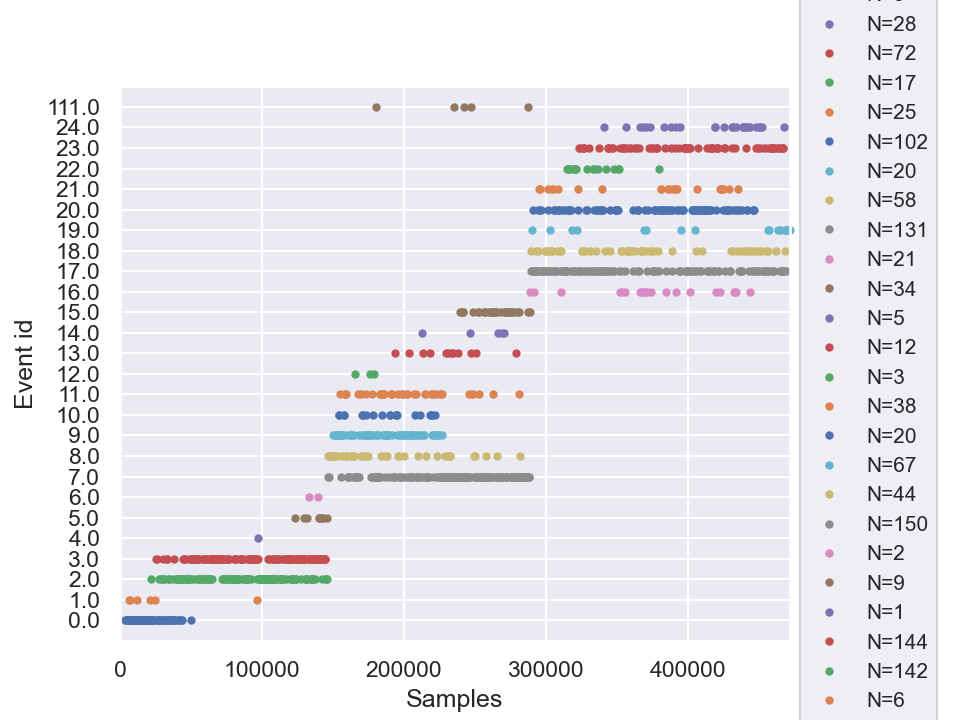

In [388]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(cluster_events)
print(len(cluster_events))
print(len(graph.vs))

fig = mne.viz.plot_events(cluster_events)            

In [547]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
filter_func = decomposition.PCA(n_components=1)

filter_func = L_inf_centrality()
filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 4.00000e+00]
 [4.71229e+05 0.00000e+00 6.00000e+00]
 [4.71594e+05 0.00000e+00 6.00000e+00]]
1231
10


<IPython.core.display.Javascript object>


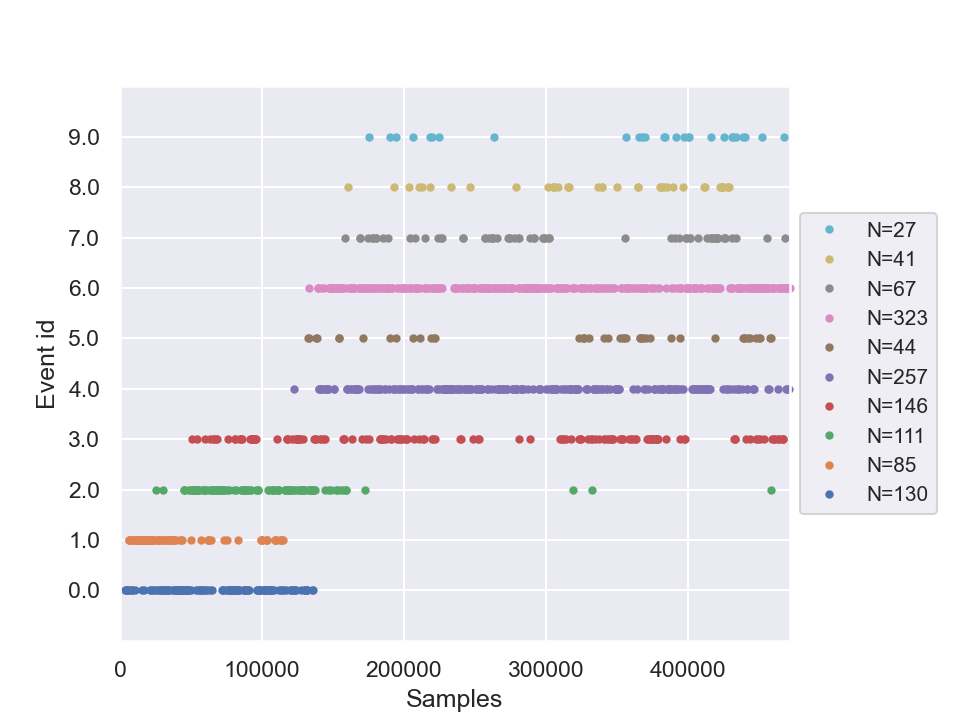

In [548]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            
m_PCA_corr_kmeans_labels = cluster_events[:,2]


fig = mne.viz.plot_events(cluster_events)            

In [549]:
print(len(ecctr_corr_ward_knn_labels))
print(ecctr_corr_ward_knn_labels)

1231
[0. 0. 0. ... 4. 6. 6.]


# Testing different mappers

In [599]:
# Define filter function

#filter_func = Eccentricity(metric='euclidean')
#filter_func = Eccentricity(metric='correlation')
#filter_func = Entropy()
#filter_func = decomposition.PCA(n_components=1)

#filter_func = L_inf_centrality(metric='euclidean')
#filter_func = L_inf_centrality(metric='correlation')

#filter_func = stage1_min_dist(metric='euclidean')
filter_func = stage1_min_dist(metric='correlation')

# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

10


<IPython.core.display.Javascript object>


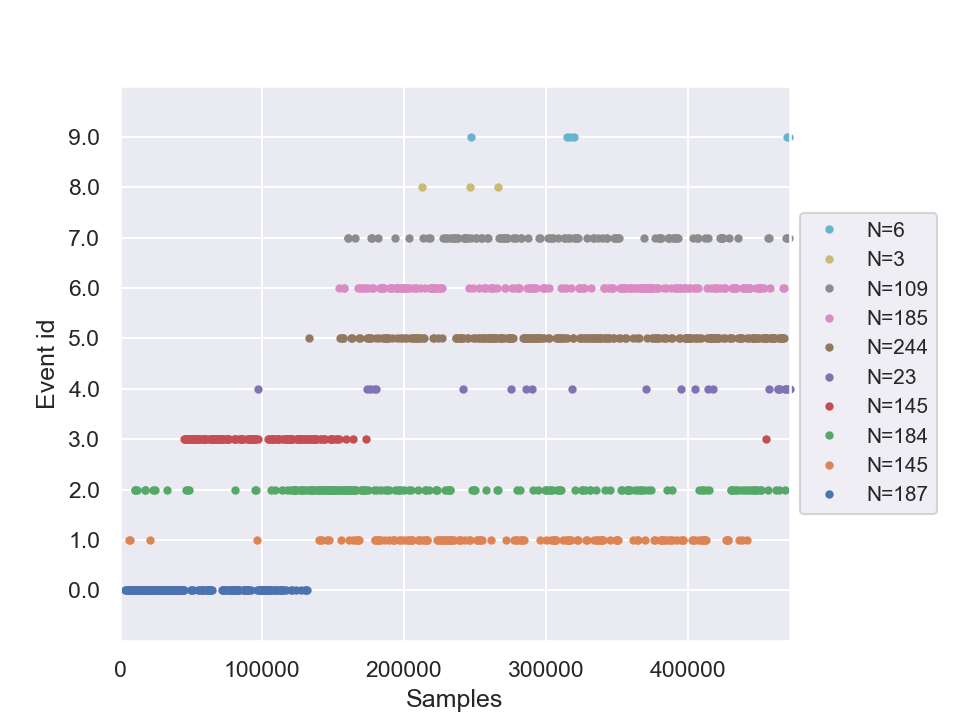

In [600]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            

#m_ecc_eucl_kmeans_labels = cluster_events[:,2]
#m_ecc_corr_kmeans_labels = cluster_events[:,2]
#m_ecc_eucl_ward_knn_labels = cluster_events[:,2]
#m_ecc_corr_ward_knn_labels = cluster_events[:,2]

#m_entropy_kmeans_labels = cluster_events[:,2]
#m_entropy_ward_labels = cluster_events[:,2]
#m_entropy_ward_knn_labels = cluster_events[:,2]

#m_PCA_1_kmeans_labels = cluster_events[:,2]
#m_PCA_1_ward_knn_labels = cluster_events[:,2]

#m_linf_eucl_kmeans_labels = cluster_events[:,2]
#m_linf_corr_kmeans_labels = cluster_events[:,2]
#m_linf_eucl_ward_knn_labels = cluster_events[:,2]
#m_linf_corr_ward_knn_labels = cluster_events[:,2]

#m_st1_dist_eucl_kmeans_labels = cluster_events[:,2]
#m_st1_dist_corr_kmeans_labels = cluster_events[:,2]
#m_st1_dist_eucl_ward_knn_labels = cluster_events[:,2]
m_st1_dist_corr_ward_knn_labels = cluster_events[:,2]

fig = mne.viz.plot_events(cluster_events)            

In [ ]:
# Calculate cluster centers and their distance matrix




In [535]:
# Функция для расчёта оценок качетва кластеризации
from sklearn import metrics

def bench_cl_metrics_noground(name, data, labels_pred):
#    t0 = time()
#    estimator = cluster_method.fit(data)
#    fit_time = time() - t0
    results = [name]

    # Define the metrics which require only data and predicted labels
    cluster_metrics_without_ground = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics_without_ground]

    # Show the results
    formatter_result = (
        "{:9s}\t{:.3f}\t{:.3f}\t\t{:.3f}"
    )
    print(formatter_result.format(*results))

In [601]:
# Сравнение методов кластеризации на основе оценок качества

print(82 * "_")
print("method \t\t silh\t cal-har\t dav-bold\t homo\t compl\t v-meas\t ARI\t AMI")

cluster_method = KMeans(n_clusters=6, random_state=0)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="kmeans_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

for linkage in ("ward", "average"):#, "complete", "single"):
    cluster_method = AgglomerativeClustering(linkage=linkage, n_clusters=6)
    fit_method = cluster_method.fit(psd_spectr_FA_ward)
    bench_cl_metrics_noground(name=linkage+"_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

cluster_method = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="ward_adj_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

# Mapper results
bench_cl_metrics_noground(name="m_ecc_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_ecc_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_entropy_kmeans", data=psd_spectr_FA_ward, labels_pred=m_entropy_kmeans_labels)
bench_cl_metrics_noground(name="m_entropy_ward", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_labels)
bench_cl_metrics_noground(name="m_entropy_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_knn_labels)

bench_cl_metrics_noground(name="m_PCA_1_kmeans", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_kmeans_labels)
bench_cl_metrics_noground(name="m_PCA_1_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_ward_knn_labels)

bench_cl_metrics_noground(name="m_linf_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_linf_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_st1_dist_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_ward_knn_labels)

print(82 * "_")

__________________________________________________________________________________
method 		 silh	 cal-har	 dav-bold	 homo	 compl	 v-meas	 ARI	 AMI
kmeans_FA_ward	0.208	405.352		1.476
ward_FA_ward	0.172	335.804		1.461
average_FA_ward	0.165	217.656		1.185
ward_adj_FA_ward	0.115	243.752		2.549
m_ecc_eucl_kmeans	0.050	145.221		2.839
m_ecc_corr_kmeans	0.096	116.481		2.572
m_ecc_eucl_ward_knn	0.011	95.898		4.343
m_ecc_corr_ward_knn	-0.016	49.940		2.905
m_entropy_kmeans	0.095	206.360		1.823
m_entropy_ward	0.088	198.893		1.770
m_entropy_ward_knn	0.081	186.860		1.890
m_PCA_1_kmeans	0.120	242.065		1.816
m_PCA_1_ward_knn	0.117	236.747		1.759
m_linf_eucl_kmeans	0.050	162.660		2.835
m_linf_corr_kmeans	0.001	122.914		3.774
m_linf_eucl_ward_knn	0.028	137.765		2.911
m_linf_corr_ward_knn	-0.015	101.670		3.460
m_st1_dist_eucl_kmeans	0.059	170.591		2.952
m_st1_dist_corr_kmeans	0.044	148.635		3.003
m_st1_dist_eucl_ward_knn	0.036	147.915		3.054
m_st1_dist_corr_ward_knn	0.039	129.092		3.630
_______________

In [541]:
fit_method.labels_

array([3, 3, 3, ..., 2, 2, 2], dtype=int64)

# Testing

In [113]:
nparr = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])
nparreven = nparr[np.where(nparr % 2 == 0)]
nparreven

npbool = nparr < 5
(nparr == 5).astype(int)

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0])

In [292]:
print(epochs_ecg.get_data().shape)

(1231, 19, 451)
